# CH01 - Getting Started With Node.js



## Chapter Introduction

( Node.js هذا القسم يحتوي على تعريف عام وخصائص رئيسية لبيئة )

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -

### Node.js (built on Chrome's V8 JavaScript engine)

(CH01 > What is Node? ينتمي إلى )

Key points:
1. Uses an event-driven, non-blocking I/O model to handle many concurrent requests.
2. Runs as a single process.
3. Handles JavaScript execution on a single main thread (the event loop).
4. Enables writing asynchronous code without manual thread management.
5. JavaScript in Node.js is single-threaded; concurrency comes from the event loop and background workers (via libuv) for I/O or expensive tasks.

![Screenshot 2025-11-29 222417.png](<attachment:Screenshot 2025-11-29 222417.png>)


![Screenshot 2025-11-30 223021.png](<attachment:Screenshot 2025-11-30 223021.png>)

### Non-blocking I/O model

How it differs:
- **Synchronous**: the operation blocks the main thread until it completes.
- **Asynchronous**: the operation starts and returns immediately; completion is handled later via callbacks, promises, or async/await.

![Screenshot 2025-11-30 223456.png](<attachment:Screenshot 2025-11-30 223456.png>)


### Synchronous vs Asynchronous (single-threaded)
Node.js runs JavaScript on a single thread but performs many operations asynchronously so the event loop is not blocked.

![Screenshot 2025-11-30 223602.png](<attachment:Screenshot 2025-11-30 223602.png>)

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -
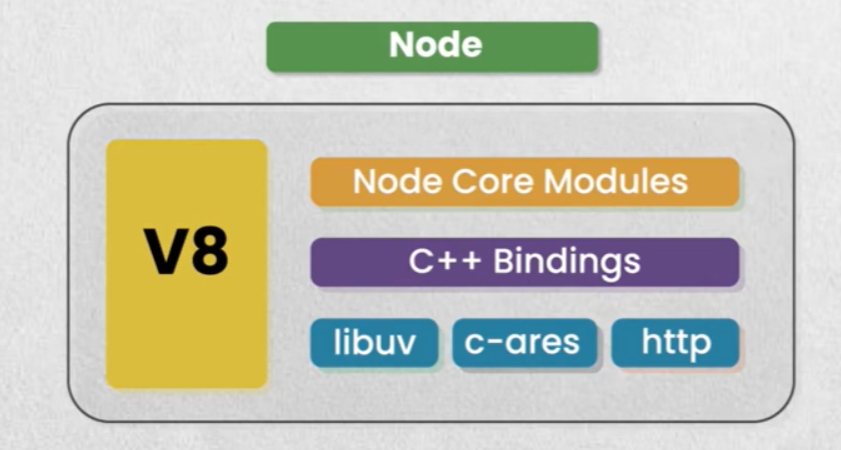
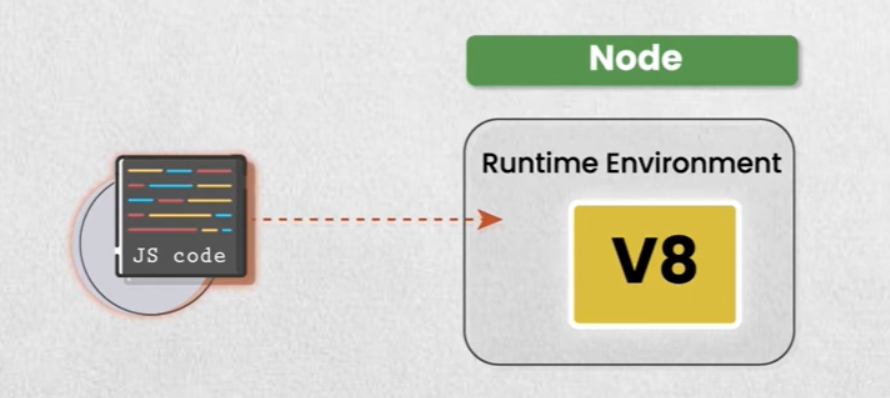
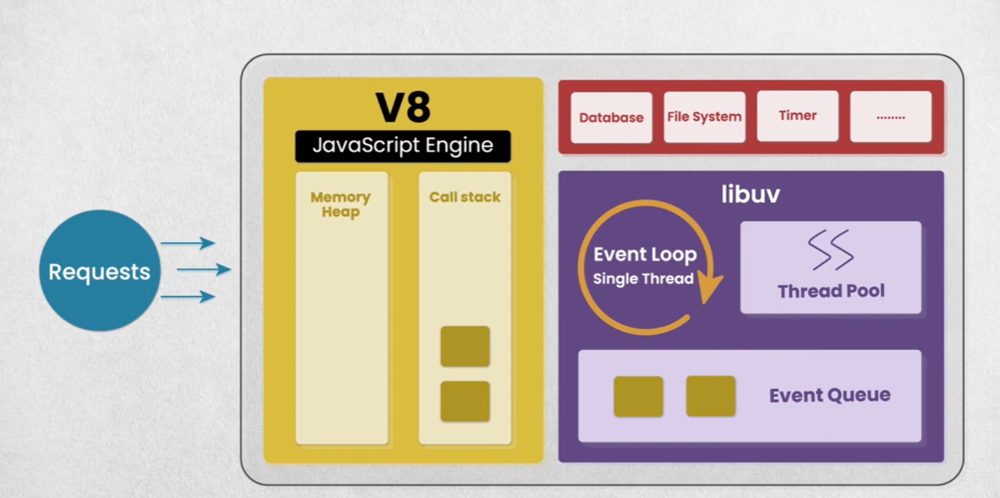
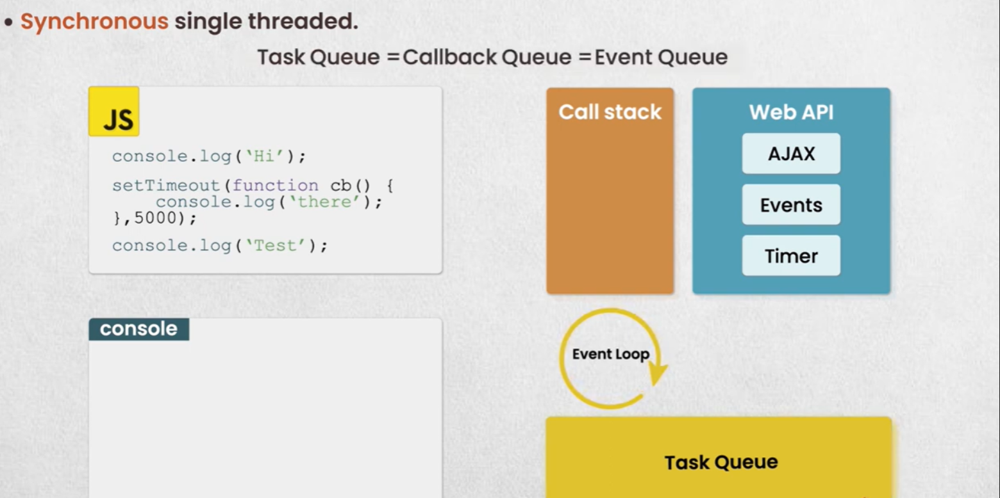

## Using Node REPL

(CH01 > Using Node REPL ينتمي إلى )

### Command Prompt (CMD) notes  / CMD  ملاحظات  

`mkdir` — Make directory — إنشاء مجلد

`dir` — Show files inside the current directory — عرض الملفات داخل المجلد الحالي

`cd..` — Go to the previous directory (move up one level) — الرجوع للمجلد السابق (مستوى واحد للأعلى)

`cd <directoryName>` — Change directory / Enter directory — الدخول إلى مجلد معين (اكتب اسم المجلد مكان `<directoryName>`)

_نصائح سريعة:_
- للدخول إلى مجلد معين `cd` لعرض الملفات ثم `dir` استخدم 
- لكتابة مسار يحتوي على مسافات، ضع المسار بين علامات اقتباس : `cd "My Folder"`.

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -

## How Node.js Works

(Event Loop, Callback Queue, Microtasks, libuvنظرة على الـ )

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -

### Event Loop التنفيذ على خيط واحد 

لكن هذا لا يعني أنه لا يوجد تزامن —*event loop*عبر ما يُسمى(single main thread)يحدث على خيط رئيسي واحد Node.js فيJAVASCRIPT تنفيذ كود   

1. **(مكدس الاستدعاءات) Call Stackالـ**: هنا يتم تنفيذ التعليمات البرمجية خطوة بخطوة.
2. **Event Loopالـ** : للتنفيذ عندما يكون المكدس فارغًا callbacks أو microtasks (طوابير الأحداث) ويُدخل queues يراقب المكدس و 
3. **libuv** : — غير المحظورة في الخلفية (مثل الشبكات والملفات) I/Oلمعالجة عمليات الـ Node التي تستخدمها C/C++ مكتبة 

-->callback عبر event loop أو عبر واجهات النظام، ثم تُعيد النتيجة إلى  libuv داخل (threads)  هذه العمليات يمكن أن تجري على مؤشرات 


*تنفيذ متوازي* وليس بالضرورة (concurrency) *تزامن* يوفر Node.js بالتالي 

>event loopأو تحويلها إلى عمليات منفصلة لتجنّب حجب الـ Worker Threads على خيط واحد. للعمليات الحسابية الثقيلة يمكن استخدام(parallelism) 

: غير محظور I/O عند استخدام event loop مثال سريع يوضّح عدم حجب الــ   

```js
console.log('A');
setTimeout(() => console.log('B'), 0); // إلى طابور الأحداث callback يُدخل 
console.log('C');
// A, C, B : مخرجات متوقعة
```

ملاحظات عملية:
- لتفادي حجب الخيط الرئيسي عند التعامل مع الملفات `fs.readFileSync` بدل `fs.readFile` استخدم 
- أو تقسيم العمل إلى خدمات/عمليات منفصلة `worker_threads` كبيرة، فكّر في CPU-bound إذا كان لديك مهام 

---

### Node REPL — (.editor, .save, .load) أوامر المحرر المهمة 

هو بيئة تفاعلية مفيدة لتجربة شفرات قصيرة والتحقّق من سلوك الدوال بسرعة. بعض الأوامر المفيدة REPL الـ 

- لتنفيذ الكود الذي أدخلته Ctrl+D (EOF) اكتب عدة أسطر من الكود ثم اضغط  REPLتفتح وضع التحرير المتعدد الأسطر داخل الـ **`.editor`**

- مفيد لحفظ التجارب بسرعة  (`.js` بامتداد عادةً ) `<fileName>`تحفظ تاريخ الجلسة أو الشفرة المدخلة إلى ملف باسم **`.save <fileName>`**

- REPLفي جلسة الـ JavaScript يحمل ويُنفذ ملف **`.load <fileName>`** 

مثال خطوة-بخطوة:

1. CMD أو PowerShellفي الـ `node` بكتابة REPL ابدأ 
2. اكتب هذا المحتوى Enter. ثم اضغط `.editor` اكتب 

```js
function greet(name) {
  return `Hello, ${name}!`;
}
console.log(greet('Mohamed'));
```

3. لتنفيذ ما كتبت Ctrl+D اضغط 
4. `.load myTest.js` أو حمّل ملفًا موجودًا `.save myTest.js` احفظ الجلسة 

._ عند تطوير مشاريع أكبر `.js` للتجارب السريعة، لكن ضع الشفرة المنظمة داخل ملفات REPL استخدم _نصيحة:_  

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -


## Your First Node Program

(سيتم وضع أول برنامج بسيط لطباعة نص وعمل دالة بسيطة)

In [1]:
// console → بتفتح الكونسول
// log → بتطبع في الكونسول
console.log("Hello, World!");

// var → بتعرف متغير
var x = 10; 
var y = 20; 

// function → بتعمل دالة
function adding(a, b) {
    // return → بترجع الناتج
    return a + b;
}

// var → بتعرف متغير لتخزين الناتج
var result = adding(x, y);

// console → بتفتح الكونسول
// log → بتطبع الناتج
console.log(result);


Hello, World!
30


## Node Environment vs Browser Environment

( النطاقات، وكيفية عمل المتغيرات على أعلى مستوى global و window، الفرق بين )

In [ ]:
// مثال توضيحي لطباعة متغيرات في Node.js وشرح الفرق بين var و global
console.log("Hello, World!");
var x = 10; // تعريف متغير x باستخدام var (يكون محلي في الملف وليس جزء من global object)
var y = 20;
function adding(a, b) {
    return a + b;
}
var result = adding(x, y);
console.log(result); // يطبع ناتج جمع x و y
// محاولة طباعة x من خلال global object
console.log(global.x); // سيظهر undefined لأن x غير معرف كخاصية في global
// إذا أردت أن يظهر قيمة x من خلال global، يجب تعريفه هكذا:
global.x = 10; // الآن x جزء من global ويمكن طباعته
console.log(global.x); // سيظهر 10
// ملاحظة: في المتصفح، أعلى كائن هو window وليس global، والمتغيرات المعرفة بـ var تكون جزء من window
// مثال في المتصفح:
// var x = 10;
// console.log(window.x); // سيظهر 10

Hello, World!
30
10


# CH02 - Node Module System

## Chapter Introduction


### (بدون أكواد) Node.js في "Module" و "Model" شرح الفرق بين 

#### 1) ؟ Moduleما هو الـ 

- "موديول" هو وحدة مستقلة من الشفرة (غالباً ملف واحد) تحتوي وظائف / كائنات / ثوابت يمكن إعادة استخدامها.
- يُعتبر موديول تلقائياً؛ أي أن المتغيرات والدوال داخله ليست مرئية مباشرة خارج الملف إلا إذا قمت بتصديرها Node.js في JavaScript كل ملف .
- الهدف: تنظيم المشروع إلى قطع صغيرة مفهومة، تسهِّل إعادة الاستخدام، والاختبار، والصيانة.
- مميزات رئيسية:
  - العزل: أخطاء أو تعارض أسماء داخل ملف لا تتسرب لباقي المشروع.
  - إعادة الاستخدام: تستطيع استيراد نفس الجزء في أكثر من مكان.
  - الوضوح: تفصل منطق مختلف (مثل التعامل مع قاعدة البيانات، أو الخدمات، أو الأدوات المساعدة) في ملفات منفصلة.
- أنواع شائعة:
  - `fs`, `os`, `events` مثل NODE.JS يوفرها (Built-in) موديولات أساسية 
  - موديولات تكتبها أنت (ملفاتك).
  - تُستَخدم كموديولات npm من مجتمع (Packages) حزم خارجية 

#### 2) ؟ Model ما هو الـ

- (Mongoose أو Sequelize مثل ) ORM أو عند استخدام MVC مفهوم معماري مرتبط بطبقة البيانات في أنماط مثل (Model) "موديل" 
- يمثل شكل البيانات (الحقول، الأنواع، القيود) + السلوك المرتبط بها (دوال للتحقق، للحفظ، للبحث، …).
- نفسه، بل نمط تنظيمي داخل تطبيقك Node.js ليس جزءاً من 
- يفيد في:
  - توحيد طريقة التعامل مع كيان معين (مستخدم، منتج، طلب...).
  - بالقرب من البيانات (Business Rules) تطبيق قواعد العمل 
  - قبل حفظ السجلات Validation تسهيل التحقق 
- الفرق الجوهري:
  - Module: وحدة توزيع وتنظيم للشفرة.
  - Model: وصف لمخطط البيانات ومنطقها.
  - لكنه يؤدي دوراً وظيفياً (تعريف بيانات) ضمن التصميم Node.js من ناحية Module هو أيضاً  Model الملف الذي يعرِّف 

 لإدارة الأحداث Events للتعامل مع الملفات، و File System للتعامل مع النظام، Node.js: Operating System نواع الموديولات المدمجة في 
    
![Screenshot 2025-11-30 224208.png](<attachment:Screenshot 2025-11-30 224208.png>)


#### 3) الوحدات المدمجة المشار لها في الصورة
- File System (fs):
  - للتعامل مع الملفات والمجلدات (قراءة، كتابة، إنشاء، حذف، مراقبة تغييرات).
  - تفضيل الأساليب غير المتزامنة لتجنّب حجب الحلقة الحدثية (Event Loop).
- Operating System (os):
  - للحصول على معلومات عن النظام (النظام المنصَّب، عدد الأنوية، الذاكرة، الأدلة الرئيسية، زمن التشغيل).
  - مفيد في قرارات تعتمد على البيئة (تخصيص موارد، مسارات ملفات، إلخ).
- Events (events / EventEmitter):
  - داخل التطبيق (بسيط Pub/Sub) توفير نمط "مستمع/مُصدِر" 
  - يساعد في فصل المكوّنات: جزء يطلق حدثاً، أجزاء أخرى تستمع بدون اقتران مباشر.

#### 4) (Module Scope vs Global) Node.js نطاق المتغيرات في  
- لأن كل ملف يُغلف داخل دالة تلقائيً Node.js هو كائن داخلي، لذلك المتغيرات المعلنة في أعلى الملف ليست تلقائيًا عالمية؛ فهي ليست خصائص على كائن global
- هذا التصميم يمنع التلوث ويفرض التنظيم.
- `global` ثم استورده في الملفات الأخرى، بدلاً من وضعه على (Export) إذا احتجت مشاركة شيء خارج الملف: صدّره 
- يجب أن يكون نادراً (مثل وضع قيمة تهيئة عامة) لأنّه يصعّب تتبع المصدر ويزيد احتمال التعارض (`global`/`globalThis`)استخدام النطاق العالمي 
- globals الخلاصة: المتغيرات العليا في الملف = نطاق موديول؛ المشاركة = تصدير/استيراد، وليس الاعتماد على 

#### 5) لماذا يهم التمييز؟
- يجعل التطبيق أسهل في الفهم والتطوير (Models) والطبقة المنطقية للبيانات (Modules) الفصل بين البنية .
- (أخرى Modules داخل ) وأين توزّع الوظائف والأدوات،(Modelداخل الـ ) يقلل التعقيد: تعرف أين تُعدّل منطق البيانات 

> Model هو Module لكن ليس كل ، Module موجود فعلياً داخل Model تذكّر: كل .

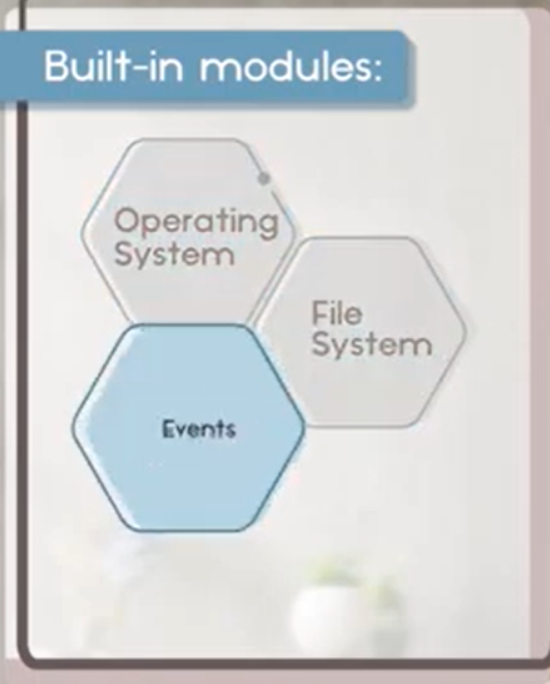

## Global Objects

( والمتغيرات العامة globalThis استخدام )

In [ ]:
// -----------------------------
// 🔹 Node.js Module Wrapping Function (دالة تغليف الموديول في Node.js)
// -----------------------------
// كل ملف في Node.js يُعتبر Module مستقل، وNode بتغلف الكود الخاص بكل ملف داخل دالة خاصة تلقائيًا.
// هذه الدالة توفر متغيرات محلية لكل ملف (Module):
// module  → كائن يمثل معلومات عن الموديول الحالي
// exports → لتصدير المتغيرات والدوال
// require → لاستيراد موديولات أخرى
// __dirname  → مسار المجلد الحالي
// __filename → المسار الكامل للملف الحالي
globalThis.appcode = "123-node-app"; // متغير عام متاح لكل الملفات (Global variable)
// الشكل الداخلي الذي تستخدمه Node.js لتغليف كل ملف:
(function (module, exports, require, __dirname, __filename) {
  // الكود الخاص بك هنا
});
// هذه الدالة تُسمى Node Wrapping Function، وتُستخدم لتشغيل الكود وتوفير المتغيرات الخاصة بكل Module.
// Node.js تنفذ هذه العملية تلقائيًا، ولا تحتاج لكتابتها بنفسك.

## Module and exports Objects

In [ ]:
// -----------------------------
// 🔹 module object (كائن module)
// -----------------------------
// في Node.js كل ملف يُعتبر Module مستقل، والكائن module يحتوي معلومات عن الملف الحالي.
console.log(module); // يطبع تفاصيل الكائن module الخاص بالملف الحالي
// شكل الكائن module (تقريبي):
// module {
//     id: '.',
//     path: '/path/to/your/file.js',
//     exports: {},   // أهم جزء: لتصدير المتغيرات أو الدوال لملفات أخرى
//     parent: null,
//     filename: '/path/to/your/file.js',
//     loaded: false,
//     children: [],
//     paths: [
//         '/path/to/your/node_modules',
//         '/path/to/node_modules',
//         '/path/node_modules',
//         '/node_modules'
//     ]
// }

// -----------------------------
// 🔹 مثال على استخدام module.exports
// -----------------------------
function sub(a, b) {
    return a - b;
}
// لتصدير الدالة sub لملف آخر نستخدم module.exports بهذا الشكل:
module.exports = {
    subfun: sub // المفتاح subfun هو الاسم الذي سيُستخدم في الملف الآخر
};

// -----------------------------
// 🔹 مثال على الاستيراد من ملف آخر (test.js)
// -----------------------------
// لنفترض أن الملف الحالي اسمه node_js.js ونريد استدعاء الدالة من ملف آخر اسمه test.js
// في test.js نكتب:
const mod = require("./node_js"); // نستورد الكائن المصدّر من node_js.js
// الآن mod يحتوي كل ما تم تصديره من node_js.js ويمكننا استخدام الدالة هكذا:
console.log(mod.subfun(10, 3)); // الناتج سيكون 7
// أي متغير أو دالة تم تصديرها عبر module.exports تكون متاحة في الملف الذي يستدعيها عبر require

In [ ]:
// --------------------------------------
// ملف math.js
// --------------------------------------

// دالتين بسيطتين للتجربة
function add(a, b) {
  return a + b;
}

function sub(a, b) {
  return a - b;
}

// -----------------------------
// الطريقة الأولى للتصدير:
// استخدام module.exports = {...}
// -----------------------------
// تصدير كل الدوال مرة واحدة داخل كائن
module.exports = {
  addfun: add,
  subfun: sub
};

// -----------------------------
// الطريقة الثانية للتصدير:
// استخدام module.exports.name = value
// -----------------------------
// تصدير كل دالة بشكل منفصل
module.exports.addfun = add;
module.exports.subfun = sub;

// --------------------------------------
// ملف test.js
// --------------------------------------

// تعريف متغير ثابت واستيراد الدوال من ملف math.js
const mod = require("./math");

// استخدام الدوال المصدرة من math.js
console.log(mod.addfun(10, 5)); // الناتج: 15
console.log(mod.subfun(10, 5)); // الناتج: 5

// --------------------------------------
// أوامر المؤقتات في جافاسكريبت
// --------------------------------------

// تشغيل كود بعد 2 ثانية
setTimeout(function() {}, 2000);

// إيقاف مؤقت setTimeout
clearTimeout();

// تكرار تشغيل كود كل 2 ثانية
setInterval(function() {}, 2000);

// إيقاف التكرار
clearInterval();

## Process object

(استخدام process.argv / process.env / stdout)

In [ ]:
// --------------------------------------
//  global object (process)
// --------------------------------------

// كائن process من أهم الكائنات العامة في Node.js
// بنستخدمه للتعامل مع النظام (تشغيل أوامر، قراءة متغيرات البيئة، معلومات النظام)

// مثال: قراءة اسم المستخدم من أوامر التشغيل
function displaygreeting(name) {
    return `Hello ${name}`;
}

// process.argv فيها كل القيم اللي المستخدم كتبها بعد أمر التشغيل
// مثال: node filename ali
// argv[2] هتكون "ali"
var user = process.argv[2];
var msg = displaygreeting(user);
console.log(msg); // Hello ali

// --------------------------------------
// 🔹 process.env
// بتخزن متغيرات البيئة زي PATH وغيره
// مثال:
console.log(process.env.PATH);

// --------------------------------------
// 🔹 process.stdout.write()
// بتطبع في الكونسول بدون إضافة سطر جديد تلقائيًا
process.stdout.write("Hello World\n"); // بدون سطر زيادة
console.log("Hello World");            // بيضيف سطر جديد

// الفرق العملي:
process.stdout.write("This is line one. ");
process.stdout.write("This is line two.\n");
// هيتطبعوا في نفس السطر

console.log("This is line one.");
console.log("This is line two.");
// كل واحدة في سطر منفصل

// --------------------------------------
// ممكن نطبع كائن process كله
// فيه معلومات عن النظام، النسخة، المستخدم، إلخ...
console.log(process);

// --------------------------------------
// ملاحظات جديدة:
// - process.argv بتفيدك في قراءة مدخلات المستخدم من سطر الأوامر.
// - process.env بتخزن متغيرات البيئة وتفيد في إعدادات النظام.
// - process.stdout.write بتطبع بدون سطر جديد، عكس console.log.
// - كائن process فيه تفاصيل كثيرة عن البيئة والنظام.
// --------------------------------------

## Exploring Node.js Architecture

(سيتم إضافة شرح أعمق لاحقًا حول طبقات Node.js ودور libuv و V8)

### Node.js Architecture — شرح مبسّط مع الصورة

![Screenshot 2025-11-30 224528.png](<attachment:Screenshot 2025-11-30 224528.png>)

- من فوق لتحت، وكل طبقة لها دور محدد Node.js الصورة بتبين طبقات .

1) Node.js API (Buffer, Events, File System, Http, Net, Stream, ...)
- JavaScriptدي واجهة برمجية مكتوبة بـ 
- (fs.readFile، http.createServer مثلاً) إحنا كمطوّرين بنتعامل معها مباشرة في الكود.
- الأحداث، وغيرها (streams) الهدف: توفر دوال جاهزة للتعامل مع الملفات، الشبكات، التدفق .

2) Node.js Bindings (Socket, http ...)
- C/C++وبين العالم السفلي المكتوب بـ JavaScript دي طبقة ربط بين 
- بمكتبات النظام السريعة المكتوبة بلغات منخفضة المستوى JS فكرتها: تربط استدعاءات .

3) C/C++ Add-ons
- إضافات/ملحقات ممكن تكتبها أو تستخدمها جاهزة لتحسين الأداء في مهام تقيلة.
- JS معقّدة وعايز سرعة أعلى من I/O مفيدة لو عندك عمليات حسابية أو 

4) V8 (JavaScript VM)
- JavaScript محرك جوجل اللي بيشغّل 
- (Garbage Collection) ويدير الذاكرة (JIT) لكود آلة سريع JS بيحوّل 
-  V8 بتكتبه بيتنّفذ فعليًا جوّه JS أي كود 

5) libuv (Thread pool, Event loop, Async I/O)
- مكتبة قوية بتوفّر:
  - Event Loop: اللي بيجدول المهام غير المتزامنة Node قلب 
  - Thread Pool:التقيل أو بعض الدوال المتزامنة I/O مجموعة خيوط في الخلفية بتشيل شغل
  - Async I/O: تنفيذ عمليات إدخال/إخراج بدون حجب للخيط الرئيسي.
- الهدف: يخلّي الكود بتاعك سريع الاستجابة حتى مع مهام كتير.

6) c-ares (Async DNS)
- بشكل غير متزامن (DNS) مكتبة لحلّ أسماء النطاقات 
- Event Loopما تعطلش الـ DNS بتخلّي الاستعلامات عن 

7) http_parser, OpenSSL, zlib, ...
- http_parser: بسرعة HTTP لتحليل رسائل 
- OpenSSL: TLS/SSL للتشفير و
- zlib: (وغيرها gzip) للضغط / و فك الضغط 
- متخصّصة بتدي أداء عالي للمهام دي C/C++ مكتبات 

جوّه الطبقات؟ (Request) كيف بيمشي الطلب 

- HTTP → ييجي طلب .
- http_parser → يحلّل الرسالة.
- Bindings → تربط النداء بالطبقات السفلية اللازمة.
- libuv →  لما يلزم Thread Poolبشكل غير متزامن ويستخدم الـ I/Oيدير الـ 
- يتعامل مع النتيجة ويرد على المستخدم (Node.js API باستخدام ) JS كودك في 

نِقَاط مهمّة وبسيطة:
- C/C++ مكتبات + Event Loop لكن مش معنى كده إنه بطيء؛ السرعة بتيجي من JSخيط رئيسي واحد ل → Node.js 
- Workers/Add-ons يفضّل تتوزع أو تتنفّذ في (CPU-bound) المهام التقيلة على المعالج 
- لأنه غير متزامن وما بيحجبش الخيط الرئيسي Node ممتازة مع (قراءة/كتابة/شبكات) I/O مهام .

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -
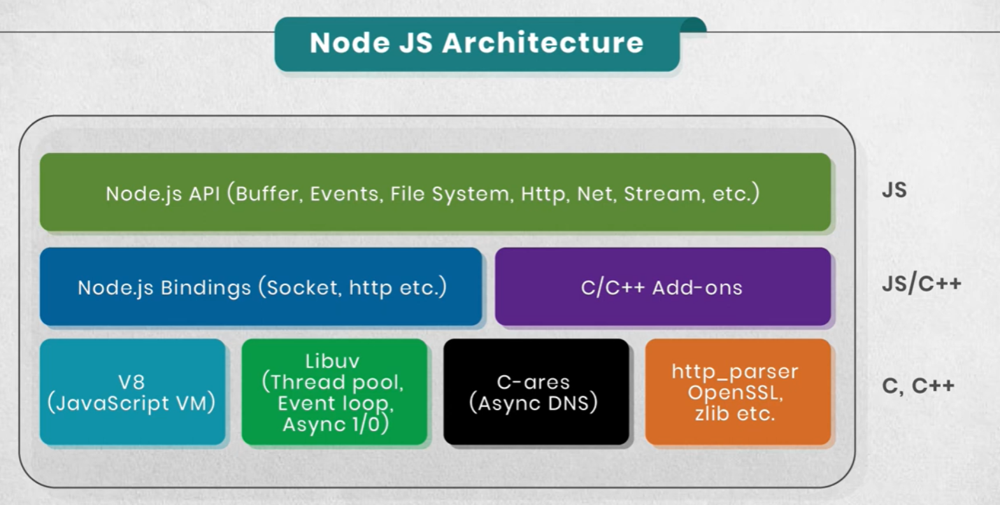

## Node.js Modules

( built-in, user, npm فهم الهدف من الموديولات وأنواعها)

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -

### Module Introduction — شرح مبسّط مع الصور داخل الشرح

 Event Loopكمان جاية من الـ Node.js مقدّمة سريعة: الموديول هو طريقة لتنظيم مشروعك لملفات صغيرة مستقلة، وكل ملف له نطاقه الخاص. قوة 
  
اللي بيخلّي التنفيذ غير حاجب.

:(Asynchronous Non‑Blocking) وبيئة غير حاجبة Event Loop — الصورة 1  

![Screenshot 2025-11-30 224722.png](<attachment:Screenshot 2025-11-30 224722.png>)


- بدل ما توقف الخيط الرئيسي Callback الطلب بيوصل ← بتسجّل له 
- بتتنفّذ خارج الخيط الرئيسي (حسابات/Database/ملفات) العمليات التقيلة 
- Callbackيراجع الطوابير ويشغّل الـ Event Loopلما تكمّل، الـ 
- النتيجة: التطبيق يفضّل سريع الاستجابة حتى مع مهام كتير.

الصورة 2 — ما هو الموديول وكيف نستخدمه:

![Screenshot 2025-11-30 224748.png](<attachment:Screenshot 2025-11-30 224748.png>)


- (Own scope) موديول له نطاق مستقل = JS كل ملف 
- لها Export علشان نشارك حاجة لبرّه الملف: نعمل 
- require("... ")علشان نستخدمها في ملف تاني: نستوردها بـ
- أنواع الموديولات:
  1) Node.js (fs, path, http, events) جاهزة مع : Core 
  2) ملفاتك أنت (منطق التطبيق) : Custom 
  3) npm (express, lodash...) حزم : Third‑party 

مثال ذهني سريع لسير العمل:
- file: math.js يصدّر دوال حسابية.
- HTTP ويستخدمها جوّه خادم requireيستورد الدوال بـ : file: server.js 

ملخص عملي:
- (Single Responsibility) قسّم المهام لملفات صغيرة 
- صدّر فقط اللي محتاجه، واستورد عند الحاجة.
- I/Oلتجنّب حجب التنفيذ في مهام Event Loopاستفد من الـ 

الرابط الاتي عليه كل ال 

https://nodejs.org/en/

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -
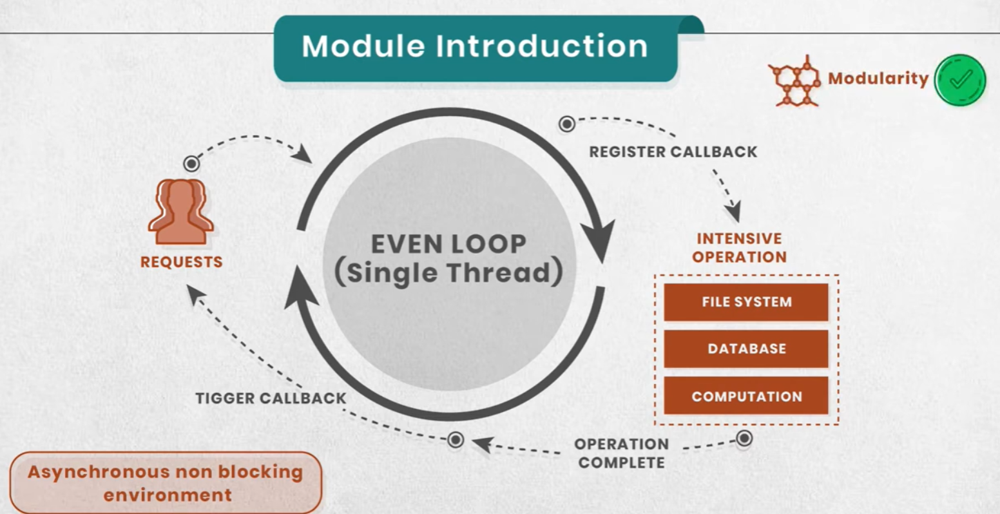
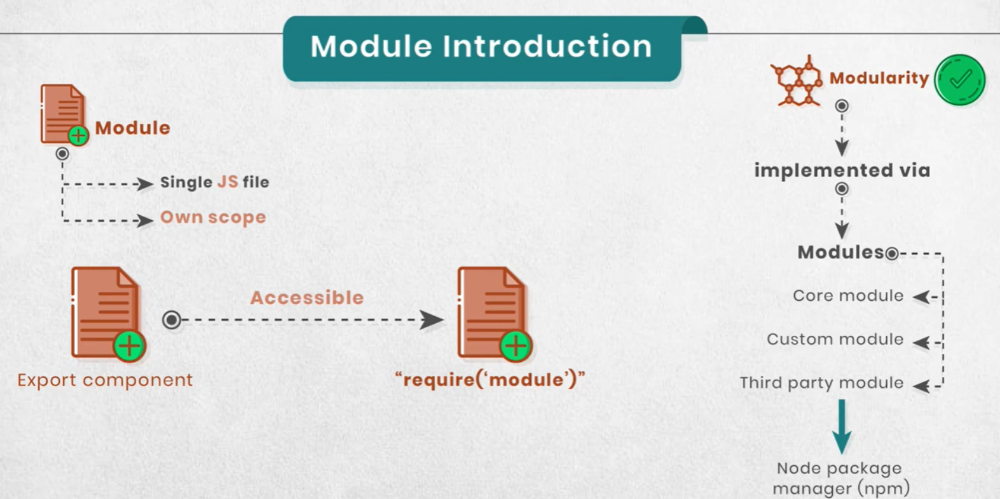

## os Module

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -


In [ ]:
// --------------------------------------
//  os module (Operating System)
// --------------------------------------

// استدعاء الموديول
const os = require("os");

// ---------------------------------------------------------
//  معلومات عامة عن النظام
// ---------------------------------------------------------
console.log("Hostname:", os.hostname()); // اسم الجهاز الحالي

// ---------------------------------------------------------
//  نظام التشغيل والمعمارية
// ---------------------------------------------------------
console.log("Platform:", os.platform()); // win32, linux, darwin...
console.log("OS Type:", os.type());      // Windows_NT, Linux...
console.log("Architecture:", os.arch()); // x64, arm...

// ---------------------------------------------------------
//  الذاكرة (Memory)
// ---------------------------------------------------------
console.log("Total Memory:", os.totalmem());
console.log("Free Memory:", os.freemem());
const usedMem = os.totalmem() - os.freemem();
console.log("Used Memory:", usedMem);
console.log("Memory Usage (%):", ((usedMem / os.totalmem()) * 100).toFixed(2) + "%");

// ---------------------------------------------------------
//  وقت تشغيل النظام
// ---------------------------------------------------------
console.log("System Uptime (seconds):", os.uptime());

// ---------------------------------------------------------
//  معلومات المستخدم
// ---------------------------------------------------------
console.log("User Info:", os.userInfo());

// ---------------------------------------------------------
//  المسارات الخاصة بالنظام
// ---------------------------------------------------------
console.log("Home Directory:", os.homedir());
console.log("Temporary Directory:", os.tmpdir());

// ---------------------------------------------------------
//  المعالج والشبكة
// ---------------------------------------------------------
console.log("CPU Info:", os.cpus());
console.log("Network Interfaces:", os.networkInterfaces());

// ---------------------------------------------------------
//  معلومات إضافية ومقارنات جديدة
// ---------------------------------------------------------
console.log("Endianness:", os.endianness());
console.log("Load Average:", os.loadavg()); // [0,0,0] في Windows
console.log("Release:", os.release());
console.log("Version:", os.version());
console.log("Constants:", os.constants);

// ---------------------------------------------------------
//  تقرير منسق عن النظام
// ---------------------------------------------------------
const systemReport = {
  Hostname: os.hostname(),
  Platform: os.platform(),
  Type: os.type(),
  Architecture: os.arch(),
  Release: os.release(),
  Version: os.version(),
  Uptime_Seconds: os.uptime(),
  TotalMemory: os.totalmem(),
  FreeMemory: os.freemem(),
  UsedMemory: usedMem,
  CPU_Count: os.cpus().length,
  User: os.userInfo().username,
  HomeDir: os.homedir(),
  TempDir: os.tmpdir(),
  Network: os.networkInterfaces(),
  Endianness: os.endianness(),
};

console.log("\n System Report:", systemReport);

## Path Module

In [ ]:
// --------------------------------------
//  path module (مسارات الملفات والمجلدات)
// --------------------------------------

const path = require("path");

// ---------------------------------------------------------
//  معلومات أساسية
// ---------------------------------------------------------
console.log("Current Directory (__dirname):", __dirname);
console.log("Current File (__filename):", __filename);

// ---------------------------------------------------------
//  استخراج أجزاء من المسار
// ---------------------------------------------------------
const filename = path.basename("/folder/subfolder/file.txt");
console.log("Filename:", filename); // file.txt

const dir = path.dirname("/folder/subfolder/file.txt");
console.log("Directory:", dir); // /folder/subfolder

// ---------------------------------------------------------
//  امتداد الملف
// ---------------------------------------------------------
const ext = path.extname("/folder/subfolder/file.txt");
console.log("Extension:", ext); // .txt

// ---------------------------------------------------------
//  تحليل وتجميع المسارات
// ---------------------------------------------------------
const parsedPath = path.parse("/folder/subfolder/file.txt");
console.log("Parsed Path:", parsedPath);

const formattedPath = path.format(parsedPath);
console.log("Formatted Path:", formattedPath);

// ---------------------------------------------------------
//  الانضمام والتحويل بين المسارات
// ---------------------------------------------------------
const fullPath = path.join("/folder", "subfolder", "file.txt");
console.log("Joined Path:", fullPath);

const absolutePath = path.resolve("folder", "subfolder", "file.txt");
console.log("Absolute Path:", absolutePath);

const relativePath = path.relative("/folder", "/folder/subfolder/file.txt");
console.log("Relative Path:", relativePath);

// ---------------------------------------------------------
//  ضبط وتصحيح المسار
// ---------------------------------------------------------
const messyPath = "/folder//subfolder/../file.txt";
console.log("Normalized Path:", path.normalize(messyPath));

// ---------------------------------------------------------
//  التحقق من نوع المسار
// ---------------------------------------------------------
console.log("Is Absolute?:", path.isAbsolute("/folder/subfolder/file.txt"));

// ---------------------------------------------------------
//  الفواصل الخاصة بالنظام
// ---------------------------------------------------------
console.log("Path Separator:", path.sep);      // / أو \
console.log("Path Delimiter:", path.delimiter); // : أو ;

const winPath = path.win32.join("C:\\", "folder", "file.txt");
console.log("Windows Path:", winPath);

const posixPath = path.posix.join("/folder", "file.txt");
console.log("POSIX Path:", posixPath);

// ---------------------------------------------------------
//  مثال عملي لتجميع المسار الديناميكي
// ---------------------------------------------------------
var newPath = path.join(__dirname, "data", "file.txt");
console.log("New Path:", newPath);

console.log("New Path Directory:", path.dirname(newPath));
console.log("New Path Extension:", path.extname(newPath));
console.log("Parsed Current File:", path.parse(__filename));

// ---------------------------------------------------------
//  كائن تلخيصي (تذكير سريع)
// ---------------------------------------------------------
const pathReport = {
  basename: " بترجع اسم الملف مع الامتداد.",
  dirname: " بترجع مسار المجلد اللي فيه الملف.",
  extname: " بترجع امتداد الملف.",
  parse: " (root, dir, base, ext, name) بتحلل المسار لأجزاء .",
  format: " parse بتجمّع المسار من كائن .",
  join: " بتجمع أجزاء المسار مع بعض بشكل صحيح.",
  resolve: " بتحوّل المسار النسبي لمسار كامل.",
  relative: " بتحسب الفرق بين مسارين.",
  normalize: " بتصلح الأخطاء في المسار (زي الشرط المكررة).",
  isAbsolute: " بتتأكد إذا كان المسار كامل ولا لأ.",
  sep: " فاصل المجلدات حسب النظام ('/' أو '\\').",
  delimiter: " PATH (':' أو ';') فاصل متغيرات ",
  posix: " Linux/macOSدوال خاصة بـ",
  win32: "Windowsدوال خاصة بـ ",
};

console.log("\n Path Module Summary:", pathReport);

## File System Module (Read File)


In [ ]:
// --------------------------------------
// File System Module
// --------------------------------------
const fs = require("fs");

// ---------------------------------------------------------
// قراءة ملف (Read File)
// ---------------------------------------------------------

// النوع الأول: Synchronous (متزامن)
// بيوقف تنفيذ باقي الكود لحد ما يخلص قراءة الملف
var data = fs.readFileSync("./massage.txt");
console.log(data); // Buffer لو ما حددتش الترميز

var dataUtf8 = fs.readFileSync("./massage.txt", "utf8");
console.log(dataUtf8); // نص جاهز

// أو تحويل الـ Buffer لنص عادي
var dataBuffer = fs.readFileSync("./massage.txt");
console.log(dataBuffer.toString());

// ---------------------------------------------------------
// النوع الثاني: Asynchronous (غير متزامن)
// الكود بيكمل أثناء قراءة الملف
fs.readFile("./massage.txt", "utf8", function (err, info) {
  if (err) {
    console.log("Error happened:", err);
  } else {
    console.log("File content:", info);
  }
});

// ---------------------------------------------------------
// ملاحظات:
// ---------------------------------------------------------
// 1. readFile → التنفيذ غير متزامن (Asynchronous)
// 2. "utf8" مهم عشان النتيجة ترجع نص جاهز مش Buffer
// 3. لو ما حطّيتش "utf8" هيرجع Buffer وتقدر تستخدم toString()
// 4. callback بتاخد اتنين parameters: err (لو فيه خطأ) و info (الملف المقروء)

// ---------------------------------------------------------
// مقارنة Synchronous vs Asynchronous
// ---------------------------------------------------------
// Synchronous: بيوقف الكود، مناسب للكود الصغير، خطر لو الملف كبير
// Asynchronous: ما بيوقفش الكود، مناسب للتطبيقات الكبيرة، محتاج callback/Promise/async-await
// النتيجة: Buffer لو ما حددتش "utf8"، نص لو استخدمت "utf8"

In [ ]:
// ---------------------------
// 🔹 Synchronous
// ---------------------------

// ده بيتم هنا:
var data = fs.readFileSync("./massage.txt");
console.log(data);
// 🔹 readFileSync → synchronous
// معنى كده: الكود **هيتوقف** لحد ما قراءة الملف تخلص قبل ما يكمل السطر اللي بعده
// عشان نحوله لنص data.toString() ممكن نعمل Buffer هيرجع "utf8" لو ما حطّيناش 

var data = fs.readFileSync("./massage.txt", "utf8");
console.log(data);
// 🔹 بس النتيجة نص جاهز synchronous برضه 

// ---------------------------
// 🔹 Asynchronous
// ---------------------------

// ده بيتم هنا:
fs.readFile("./massage.txt", "utf8", function (err, info) {
  if (err) {
    console.log(" Error happened:", err);
  } else {
    console.log(" File content:", info);
  }
});
// 🔹 readFile → asynchronous
// معنى كده: الكود **مش هيتوقف**، باقي البرنامج بيشتغل أثناء قراءة الملف
//  هتتنادى لما القراءة تخلص أو يحصل خطأ callback

In [ ]:
// ==========================================================
//  Callback / Promise / async-await
// ايه هما؟ الفرق بينهم وأمثلة عملية
// ==========================================================

const fs = require("fs"); 
// نسخة تقليدية من File System module، بتدعم Callback

const fsPromises = require("fs").promises; 
// نسخة حديثة تدعم Promises و async/await

// ---------------------------
// 🔹 1 Callback
// ---------------------------
// Callback → دالة بنمررها كمعامل للدالة الأساسية عشان تتنفذ بعد ما العملية تخلص
// مميزات: بسيطة وسهلة لو العملية واحدة
// عيوب: الكود بيبقى صعب القراءة لو فيه أكثر من عملية متتابعة (Callback Hell)
fs.readFile("./massage.txt", "utf8", function(err, info) {
  if (err) {
    console.log(" Error (Callback):", err);
  } else {
    console.log(" Content (Callback):", info);
  }
});

// ---------------------------
// 🔹 2️ Promise
// ---------------------------
// Promise → طريقة حديثة للتعامل مع العمليات غير المتزامنة
// الكود يبقى أنظف وأسهل للقراءة
// مميزات: يدعم السلاسل (chaining) أفضل من Callback
// عيوب: محتاجة .then() و .catch()
fsPromises.readFile("./massage.txt", "utf8")
  .then(info => console.log(" Content (Promise):", info)) // لما العملية تنجح
  .catch(err => console.log(" Error (Promise):", err));   // لو العملية فشلت

// ---------------------------
// 🔹 3️ async / await
// ---------------------------
// async/await → طريقة أحدث وأسهل للتعامل مع Promises
// الشكل يبدو متزامن لكنه فعليًا asynchronous
// مميزات: أسهل طريقة للتعامل مع I/O وملفات كبيرة أو عمليات كثيرة
// عيوب: لازم async قبل الدالة، و await بس جوا الدالة
async function readFileAsync() {
  try {
    const info = await fsPromises.readFile("./massage.txt", "utf8"); // انتظار انتهاء العملية
    console.log(" Content (async/await):", info);
  } catch (err) {
    console.log(" Error (async/await):", err);
  }
}
readFileAsync();

// ---------------------------
// 🔹 مقارنة سريعة بين الثلاثة
// ---------------------------
// 1️ Callback:
// - التنفيذ غير متزامن
// - سهل لو العملية واحدة
// - صعب القراءة لو فيه عدة عمليات متتابعة
//
// 2️ Promise:
// - التنفيذ غير متزامن
// - أنظف من Callback
// - يدعم .then() و .catch() للسلاسل
//
// 3️ async/await:
// - شكل الكود شبه متزامن لكنه فعليًا asynchronous
// - أسهل طريقة للتعامل مع العمليات الكبيرة أو المتتابعة
// - لازم استخدام async قبل الدالة و await جواها

## File System Module (Write File)


In [ ]:
// fs.writeFile → بتكتب نص جديد في ملف معين (لو الملف مش موجود بيتعمل، ولو موجود بيتم استبدال كل محتواه)
// المعاملات:
// 1. اسم الملف (مثلاً: "./newfile.txt")
// 2. النص اللي هينكتب في الملف
// 3. دالة callback بتتنادى بعد انتهاء الكتابة (err لو فيه خطأ)

// مثال عملي:
fs.writeFile("./newfile.txt", "Hello, this is a new file!", function(err) {
  if (err) {
    console.log("Error writing file:", err);
  } else {
    console.log("File written successfully.");
  }
});

// لو شغلت نفس الكود وغيرت النص، هيتم استبدال كل محتوى الملف بالنص الجديد
fs.writeFile("./newfile.txt", "Hel!", function(err) {
  if (err) {
    console.log("Error writing file:", err);
  } else {
    console.log("File overwritten successfully.");
  }
});

// fs.appendFile → بتضيف نص جديد في نهاية الملف بدون حذف القديم
// المعاملات زي writeFile، لكن النص الجديد بيتضاف بعد الموجود
fs.appendFile("./newfile.txt", " This is appended text.", function(err) {
  if (err) {
    console.log("Error appending to file:", err);
  } else {
    console.log("Text appended successfully.");
  }
});

// ملخص:
// - writeFile: بيكتب أو يستبدل كل محتوى الملف.
// - appendFile: بيضيف نص جديد في آخر الملف بدون حذف القديم.
// - كل دالة فيها callback بتتنادى بعد انتهاء العملية، وبتستقبل err لو فيه مشكلة.

## File System Module (Delete File)


In [ ]:
// fs.unlink → لحذف ملف من النظام. بتاخد اسم الملف ودالة callback.
// لو الملف موجود بيتحذف، لو مش موجود بيطلع خطأ في err.
fs.unlink("./newfile.txt", function(err) {
    if (err) throw err;
    console.log("File deleted successfully.");
});

// ---------------------------------------------------------
// مثال مجمع: كتابة ثم إضافة ثم حذف ملف
// ---------------------------------------------------------

// fs.writeFile → بتكتب نص جديد في ملف (ينشئ أو يستبدل).
// fs.appendFile → بتضيف نص في نهاية الملف.
// كل دالة فيها callback بتتنادى بعد انتهاء العملية.
fs.writeFile("./sample.txt", "aaaaaaaaaaaaaaaaaaaaa", "utf8", function (err) {
  if (err) {
    console.error("Write error:", err);
    return;
  }
  console.log("File written successfully.");

  fs.appendFile("./sample.txt", "mmmmmmmmmmmm", "utf8", function (err) {
    if (err) {
      console.error("First append error:", err);
      return;
    }
    console.log("First append done.");

    fs.appendFile("./sample.txt", "tttttttttttttt", "utf8", function (err) {
      if (err) {
        console.error("Second append error:", err);
        return;
      }
      console.log("Second append done.");
    });
  });
});

// ---------------------------------------------------------
// بديل باستخدام async/await مع fs/promises (كود أنظف)
// ---------------------------------------------------------
const fsp = require("fs/promises");

(async () => {
  try {
    await fsp.writeFile("./sample.txt", "aaaaaaaaaaaaaaaaaaaaa", "utf8");
    await fsp.appendFile("./sample.txt", "mmmmmmmmmmmm", "utf8");
    await fsp.appendFile("./sample.txt", "tttttttttttttt", "utf8");
    console.log("All writes completed.");
  } catch (e) {
    console.error(e);
  }
})();

// ---------------------------------------------------------
// حذف الملف بعد الانتهاء
// ---------------------------------------------------------
fs.unlink("./sample.txt", function(err) {
    if (err) throw err;
    console.log("File deleted successfully.");
});

// ---------------------------------------------------------
// ملخص:
// - writeFile: ينشئ أو يستبدل محتوى الملف.
// - appendFile: يضيف نص في نهاية الملف.
// - unlink: يحذف الملف.
// - كل دالة فيها callback أو تستخدم await لو مع promises.
// ---------------------------------------------------------

## File system module - directories



In [ ]:
// fs.mkdir → لإنشاء مجلد جديد.
// يمكن استخدامها بشكل متزامن أو غير متزامن (يفضل غير متزامن).
fs.mkdir('new_directory', (err) => {
    if (err) {
        console.log("Error creating directory:");
    } else {
        // تغيير المسار إلى المجلد الجديد
        process.chdir('./new_directory'); // ينقل التنفيذ للمجلد الجديد

        // كتابة ملف داخل المجلد الجديد
        fs.writeFile('./new_directory/info.txt', 'Hello Directory', 'utf8', (err) => {
            if (err) {
                console.log("Error writing file in directory:");
            } else {
                console.log("File written successfully in directory");
            }
        });

        console.log("Directory created successfully");
    }
});

// fs.readdir → لقراءة محتويات المجلد (يعيد قائمة الملفات والمجلدات بداخله)
fs.readdir('./new_directory', (err, files) => {
    if (err) {
        console.log("Error reading directory:");
    } else {
        console.log("Directory contents:", files);
    }
});

// ---------------------------------------------------------
// ملخص:
// - mkdir: لإنشاء مجلد جديد.
// - writeFile: لكتابة ملف داخل المجلد.
// - readdir: لقراءة محتويات المجلد.
// - chdir: لتغيير المسار الحالي.
// ---------------------------------------------------------

## Event Module


### Event Module — Asynchronous

![Screenshot 2025-11-30 224945.png](<attachment:Screenshot 2025-11-30 224945.png>)

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -

#### الفكرة العامة
- Event Loop عبر الحلقة الحدثية (Asynchronous) تُدار بأسلوب غير متزامن Node.js أحداث 
- نوعان رئيسيان من الأحداث:
1) System event:(مثل فتح ملف، وصول بيانات،انتهاءالقراءة)C++/libuvعبر طبقة(OS)أحداث تأتي من النظام   
2) Custom event: events module و EventEmitter باستخدام JavaScript أحداث ننشئها نحن في

#### System event (C++ core / libuv)
- fs, net, http, stream : يعرّضها عبر موديولات مثل Nodeمصدرها النظام أو مكتبات الخلفية، و
- أمثلة شائعة على أسماء الأحداث:
  - 'open' عند فتح ملف/مورد.
  - 'data' Stream/Sockets عند استلام جزء بيانات على 
  - 'end' عند اكتمال القراءة.
  - 'close' عند إغلاق المورد.
  - 'error' عند حدوث خطأ.
- يتابع العملية في الخلفية، ثم يعيد إدراج الاستدعاء libuv مباشرة؛ JavaScript هذه الأحداث لا تنفّذ في طوابير الحدث عندما يصبح جاهزًا (callback)


#### Custom event (JavaScript core / events module)
- EventEmitter مثل المتصفح؛ ننشئ أحداثًا مخصّصة عبر Node لا يوجد "كائن حدث" أصيل في 
-  Pub/Sub نمط — (on/once) ومكوّنات أخرى تستمع له (emit) الفكرة: مكوّن يطلق الحدث 

بسيط يفك الاقتران بين الأجزاء

- استخدامات شائعة: الإشعارات داخل التطبيق، سجلات/مراقبة، تمرير إشارات بين طبقات بدون استدعاء مباشر.

#### Event Loop؟ كيف يندمج ذلك مع 
- callbacks وعندما تكتمل، تُجدول libuv تعمل خارج الخيط الرئيسي عبر (I/O) العمليات البطيئة 
 عندما يفرغ المكدس Event Loop ليعالجها الـ 
- الخيط الرئيسي يظل متاحًا لمعالجة مزيد من الأحداث بدلاً من الانتظار Non‑blocking I/O : هذا يحقق 

#### نقاط مهمّة ومزالق
- لتجنّب إنهاء العملية دون رسالةstreamsوEventEmitterعلى الـ'error'احرص دائمًا على الاستماع لحدث 
- Memory leak العدد الافتراضي للمستمعين على نفس الحدث هو 10؛ تجاوز ذلك قد يظهر تحذير 
  emitter.setMaxListeners(n)يمكن ضبطه بـ 
- حين تريد تنفيذ المعالج مرة واحدة فقط once() استخدم 

---

#### Mini cheat‑sheet
- System events: Node (fs/net/http/streams) تصل لك في موديولات ← libuv يطلقها النظام عبر 
- Custom events: تفكيك الاقتران داخل تطبيقك ← EventEmitter تخلقها بنفسك عبر 

. - . - . - . - . -. - . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . - . - . -.- . - . -
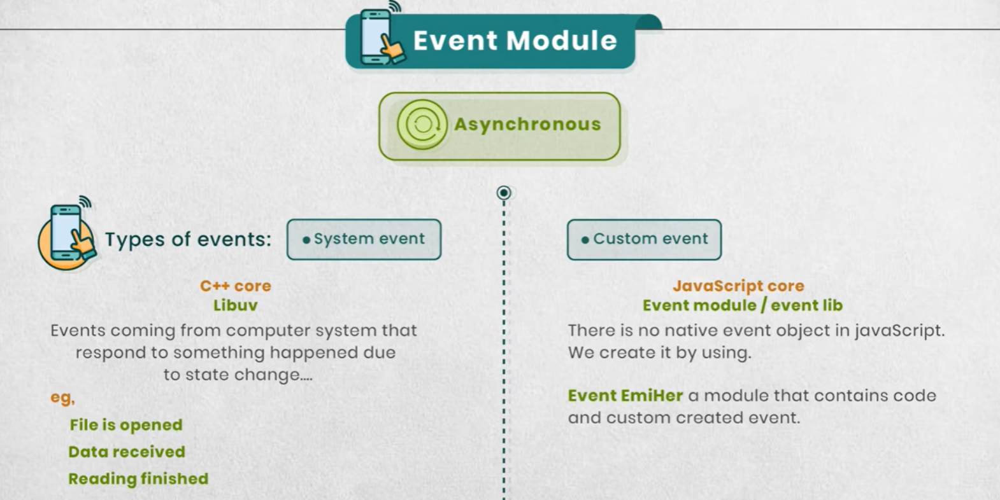

In [ ]:
// events module
const EventEmitter = require('events');
var myEventobject = new EventEmitter();

// تسجيل مستمع للحدث "lookup"
myEventobject.on("lookup", () => {
    console.log("lookup event has occurred #1");
});

// تسجيل مستمع للحدث "look up" (مسافة بينهم)
myEventobject.on("look up", () => {
    console.log("look up event has occurred #2");
});

// تفعيل الحدث "lookup" (سيتم تنفيذ كل المستمعين لهذا الاسم)
myEventobject.emit("lookup"); // يطبع: lookup event has occurred #1

// ملاحظات:
// - كل مستمع للحدث بنفس الاسم يتم تنفيذه عند تفعيل الحدث (emit).
// - الأحداث تعمل بشكل متزامن (synchronous) في هذا المثال.
// - لو فعلت "look up" هيتنفذ المستمع الثاني فقط.

## HTTP Module


![Screenshot 2025-11-30 225037.png](<attachment:Screenshot 2025-11-30 225037.png>)

### مع الكلاينتس؟ HTTP Module كيف يتعامل الـ  
 

-    للسيرفر HTTP يقدر يبعت طلبات **Web Client** أو **Mobile Client** أي 
   .
-عندنا عدة  Clients:
  - Client A يرسل HTTP Request A
  - Client B يرسل HTTP Request B
  - Client C يرسل HTTP Request C
- http module اللي معمول باستخدام الـ **The Web Server** كل الطلبات بتروح إلى 
  
- مناسب. Response السيرفر يستقبل الطلب → يفهمه → ويرجع 


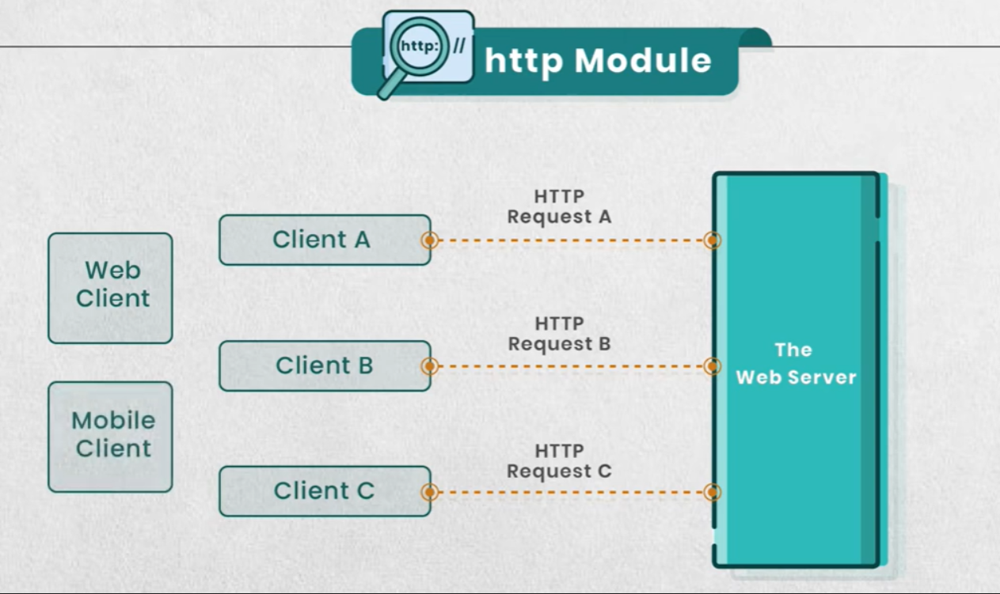

In [ ]:
// http module
const http = require("http");

// createServer → بتعمل سيرفر جديد يستقبل Requests ويرجع Responses
const server = http.createServer();

// تشغيل السيرفر على بورت 3000
server.listen(3000, () => {
    console.log("Server is running on port 3000");
});

// ملاحظات عن البورتات:
// (0 – 1023)     بورتات محجوزة للنظام والـ System Services
// (1024 – 49151) بورتات للتطبيقات (Registered Ports)
// (49152 – 65535) بورتات عشوائية (Dynamic / Private Ports)

## Handling HTTP Requests


In [ ]:
const http = require("http");

// الطريقة الأولى (باستخدام server.on)
const server = http.createServer();

// event "request" → بيتنفّذ مع كل Request يوصل للسيرفر
server.on("request", (req, res) => {
    console.log(req.url);     // مسار الطلب
    console.log(req.method);  // نوع الطلب (GET / POST ...)
    console.log("Request received");

    res.write("this is response from server");
    res.end(); // لازم نقفل الرد
});

// الطريقة الثانية (الأكثر استخدامًا)
// createServer بتستقبل Callback فيه req و res
const server2 = http.createServer((req, res) => {
    console.log(req.url);     // مسار الطلب
    console.log(req.method);  // نوع الطلب
    console.log("Request received");

    res.write("this is response from server");  
    res.end();
});

// تشغيل السيرفر على البورت 3000
server.listen(3000, () => {
    console.log("Server is running on port 3000");
});

// لو عايز تشغل الطريقة الثانية بدل الأولى:
// server2.listen(3000, () => {
//     console.log("Server is running on port 3000");
// });

## HTTP Header


In [ ]:
const http = require("http");
const fs = require("fs"); // File System module

const server = http.createServer((req, res) => {
    console.log(req.url);     
    console.log(req.method);  
    console.log("Request received");

    // -----------------------------
    // Route: /
    // -----------------------------
    if (req.url === "/") {
        res.write("Welcome to Home Page! ");
        return res.end();  
        // لازم return علشان ما يكملش للكود اللي تحت ويعمل res.end تاني
    }

    // -----------------------------
    // Route: /abc
    // -----------------------------
    if (req.url === "/abc") {
        res.write("<h1>Welcome to ABC Page!</h1>");
        return res.end();
    }

    // -----------------------------
    // Route: /home
    // قراءة ملف HTML من الجهاز
    // -----------------------------
    if (req.url === "/home") {

        // قراءة ملف home.html
        fs.readFile("./home.html", "utf8", (err, data) => {

            // لو حصل Error (الملف مش موجود – مشكلة في القراءة – permission)
            if (err) {
                console.log("error occurred:", err);
                res.write("Error loading home.html");
                return res.end();
            }

            // لو الملف اتقرأ بنجاح
            res.write(data);  // بنبعت محتوى الملف للمتصفح
            return res.end();
        });

        return;  
        // مهم جداً علشان يمنع تنفيذ res.write اللي تحت
    }

    // -----------------------------
    // دي الـ fallback (لو المسار مش موجود)
    // -----------------------------
    res.write("this is response from server");
    res.end();
});

server.listen(3000, () => {
    console.log("Server is running on port 3000");
});

In [ ]:
// -----------------------------
// Route: /home
// قراءة ملف HTML من الجهاز
// -----------------------------

if (req.url == "/home") {
    // الصحيح: استخدم فقط writeHead لتحديد حالة النجاح والهيدر المناسب
    res.writeHead(200, { "Content-Type": "text/html" }); // 200 OK و HTML

    // مثال: إرسال محتوى HTML مباشرة
    res.write("<h1>Welcome to Home Page!</h1>");

    // أو لو عايز تعرض ملف HTML من الجهاز:
    // fs.readFile("./home.html", "utf8", (err, data) => {
    //     if (err) {
    //         res.writeHead(500, { "Content-Type": "text/plain" });
    //         res.end("Error loading home.html");
    //     } else {
    //         res.writeHead(200, { "Content-Type": "text/html" });
    //         res.end(data);
    //     }
    // });

    return res.end();
}


## Handling .CSS File Request


![Screenshot 2025-11-30 225122.png](<attachment:Screenshot 2025-11-30 225122.png>)
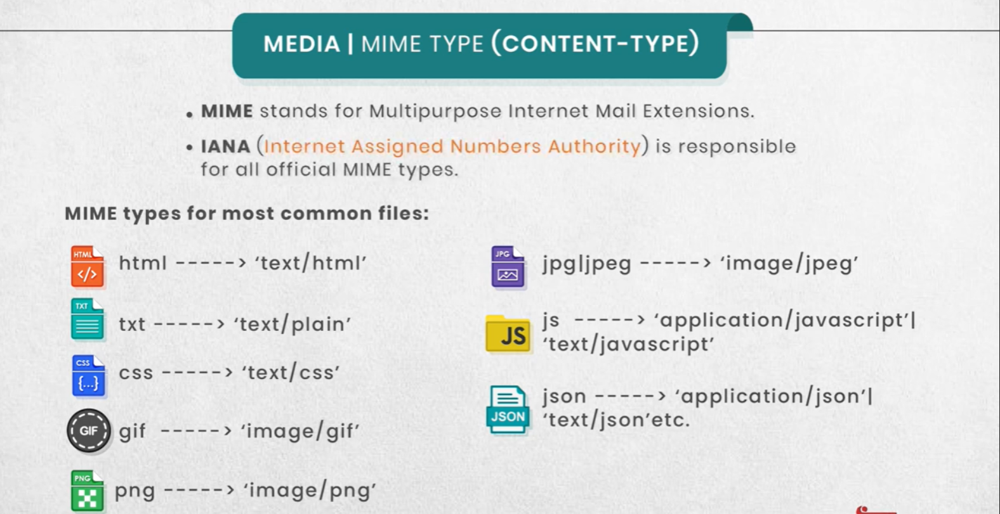

In [3]:
const http = require('http');
const fs = require('fs');

const server = http.createServer((req, res) => {

    if (req.url === "/home") {
        fs.readFile("./index.html", "utf8", (err, data) => {
            if (err) {
                console.log("error occurred:", err);
                res.writeHead(500);
                res.end("Internal Server Error");
            } else {
                res.writeHead(200, {"Content-Type": "text/html"});
                res.write(data);
                res.end();
            }
        });
    } else if (req.url === "/style.css") {
        fs.readFile("./style.css", "utf8", (err, data) => {
            if (err) {
                console.log("error occurred:", err);
                res.writeHead(500);
                res.end("Internal Server Error");
            } else {
                res.writeHead(200, {"Content-Type": "text/css"});
                res.write(data);
                res.end();
            }
        });
    } else {
        res.writeHead(404, {"Content-Type": "text/plain"});
        res.end("Page Not Found");
    }

});

server.listen(3000, () => {
    console.log("Server running at http://localhost:3000/");
});


SyntaxError: Identifier 'http' has already been declared

## Responding with a JSON object


![Screenshot 2025-11-30 225224.png](<attachment:Screenshot 2025-11-30 225224.png>)
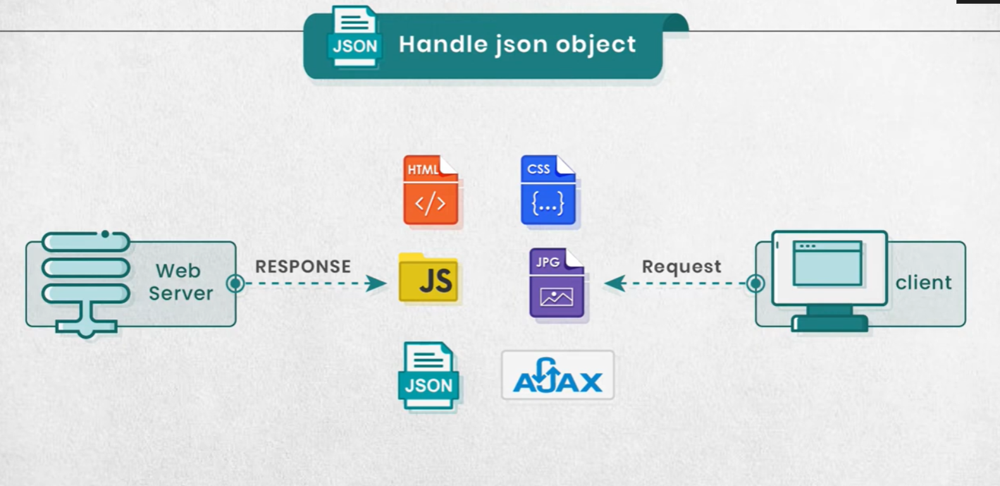

In [ ]:
const http = require('http'); // استدعاء موديل HTTP لإنشاء سيرفر ويب
const fs = require('fs');     // استدعاء File System لقراءة الملفات (index.html, style.css)
const path = require('path'); // استدعاء Path لبناء مسارات آمنة حسب نظام التشغيل

const server = http.createServer((req, res) => { // إنشاء السيرفر واستقبال req, res
    // استخدم المسار بدون الاستعلام (query string)
    const url = req.url.split('?')[0]; // يفصل جزء الاستعلام لو موجود → يسمح بمطابقة المسار فقط

    switch (url) {
        case '/home':
            if (req.method !== 'GET') { // تحقق من نوع الطلب — هذا المسار مخصّص للـ GET فقط
                res.writeHead(405, { 'Content-Type': 'text/plain; charset=utf-8' }); // 405 لو الطريقة غير مسموحة
                res.end('Method Not Allowed'); // إنهاء الاستجابة برسالة نصية
                break;
            }
            fs.readFile(path.join(__dirname, 'index.html'), 'utf8', (err, data) => { // قراءة الملف بشكل غير متزامن
                if (err) {
                    console.error('Error reading index.html:', err); // طباعة الخطأ في اللوغز
                    res.writeHead(500, { 'Content-Type': 'text/plain; charset=utf-8' }); // خطأ داخلي في السيرفر
                    res.end('Internal Server Error'); // رد مناسب عند فشل القراءة
                    return;
                }
                res.writeHead(200, { 'Content-Type': 'text/html; charset=utf-8' }); // رأس يحدد نوع المحتوى و الترميز (مهم للعربي)
                res.end(data); // إرسال محتوى HTML وإنهاء الاستجابة (كافٍ بدلاً من write ثم end)
            });
            break;

        case '/style.css':
            if (req.method !== 'GET') { // نفس التحقق للـ CSS — نسمح فقط بطلب GET
                res.writeHead(405, { 'Content-Type': 'text/plain; charset=utf-8' });
                res.end('Method Not Allowed');
                break;
            }
            fs.readFile(path.join(__dirname, 'style.css'), 'utf8', (err, data) => { // قراءة ملف الـ CSS
                if (err) {
                    console.error('Error reading style.css:', err);
                    res.writeHead(500, { 'Content-Type': 'text/plain; charset=utf-8' });
                    res.end('Internal Server Error');
                    return;
                }
                res.writeHead(200, { 'Content-Type': 'text/css; charset=utf-8' }); // Content-Type مناسب للـ CSS
                res.end(data); // إرسال CSS
            });
            break;

        case '/api/students':
            if (req.method !== 'GET') { // واجهة API هذه تقبل GET فقط
                res.writeHead(405, { 'Content-Type': 'application/json; charset=utf-8' });
                res.end(JSON.stringify({ error: 'Method Not Allowed' })); // إرسال JSON يوضح الخطأ
                break;
            }
            // مثال بيانات JSON جاهزة (عادة تستخرج من قاعدة بيانات)
            const students = [
                { id: 1, name: 'Ali' },
                { id: 2, name: 'Mona' }
            ];
            res.writeHead(200, { 'Content-Type': 'application/json; charset=utf-8' }); // رأس يحدد JSON
            res.end(JSON.stringify(students)); // تحويل الكائن/المصفوفة إلى نص JSON وإرساله → العميل يستقبله كـ JSON
            break;

        default:
            res.writeHead(404, { 'Content-Type': 'text/plain; charset=utf-8' }); // مسار غير معروف → 404
            res.end('Page Not Found'); // رسالة نصية بسيطة للـ fallback
    }
});

server.listen(3000, () => {
    console.log('Server running at http://localhost:3000/'); // تشغيل السيرفر على المنفذ 3000 وطباعة حالة التشغيل
});

<ref *1> Server {
  maxHeaderSize: undefined,
  insecureHTTPParser: undefined,
  requestTimeout: 300000,
  headersTimeout: 60000,
  keepAliveTimeout: 5000,
  connectionsCheckingInterval: 30000,
  requireHostHeader: true,
  joinDuplicateHeaders: undefined,
  rejectNonStandardBodyWrites: false,
  _events: [Object: null prototype] {
    request: [Function (anonymous)],
    connection: [Function: connectionListener],
    listening: [ [Function: setupConnectionsTracking], [Function] ]
  },
  _eventsCount: 3,
  _maxListeners: undefined,
  _connections: 0,
  _handle: TCP {
    reading: false,
    onconnection: [Function: onconnection],
    [Symbol(owner_symbol)]: [Circular *1]
  },
  _usingWorkers: false,
  _workers: [],
  _unref: false,
  _listeningId: 2,
  allowHalfOpen: true,
  pauseOnConnect: false,
  noDelay: true,
  keepAlive: false,
  keepAliveInitialDelay: 0,
  highWaterMark: 16384,
  httpAllowHalfOpen: false,
  timeout: 0,
  maxHeadersCount: null,
  maxRequestsPerSocket: 0,
  _connec

Server running at http://localhost:3000/


# جداول ملاحظات هامة
---
## 1. أهم الأكواد ووظائفها (من محتوى الملف)
| الكود | الوظيفة | ملاحظات |
|-------|---------|----------|
| `console.log()` | طباعة بيانات في الكونسول | مستخدم في أول برنامج وأمثلة كثيرة |
| `require()` | استيراد مكتبة أو ملف |  fs, os, path مستخدم في استيراد الموديولات مثل  |
| `module.exports` | تصدير دوال أو متغيرات | مستخدم في تصدير الدوال بين الملفات |
| `fs.readFile` | قراءة ملف بشكل غير متزامن |  sync و async شرح الفرق بين  |
| `fs.writeFile` | كتابة ملف | مستخدم في أمثلة الكتابة |
| `fs.appendFile` | إضافة بيانات لملف | مستخدم في أمثلة الكتابة |
| `fs.unlink` | حذف ملف | مستخدم في أمثلة الحذف |
| `os.platform()` | معرفة نظام التشغيل |  os مستخدم في أمثلة  |
| `path.join()` | تجميع أجزاء المسار |  path مستخدم في أمثلة  |
| `EventEmitter` | إنشاء أحداث مخصصة | مستخدم في أمثلة الأحداث |
| `http.createServer` | إنشاء سيرفر ويب | مستخدم في أمثلة السيرفر |
| `res.write` / `res.end` | إرسال رد للعميل | مستخدم في أمثلة السيرفر |
| `JSON.stringify` |  JSON تحويل كائن إلى نص  |  API مستخدم في أمثلة  |
---
## 2. أهم المقارنات بين الأكواد (من محتوى الملف)
| المقارنة | Synchronous | Asynchronous |
|----------|-------------|--------------|
| قراءة الملفات | `fs.readFileSync` | `fs.readFile` |
| الكتابة | `fs.writeFileSync` | `fs.writeFile` |
| التنفيذ | يوقف البرنامج حتى ينتهي | البرنامج يستمر في العمل |
---
| المقارنة | callback | promise | async/await |
|----------|---------|---------|------------|
| سهولة القراءة | ضعيف | متوسط | عالي |
| التعامل مع الأخطاء | صعب | أسهل | أسهل |
| التشابك | عالي | أقل | أقل |
---
## 3. أهم المعلومات النظرية والعملية للتركيز عليها (من محتوى الملف)
-    Node.js في  Synchronous و Asynchronous فهم الفرق بين
- أهمية استخدام الموديولات لتنظيم الكود.
- التعامل مع الملفات والمجلدات باستخدام fs وطرق القراءة والكتابة والحذف.
- معرفة كيفية تصدير واستيراد الدوال بين الملفات.
- لفصل منطق التطبيق  (EventEmitter)  استخدام الأحداث 
-والتعامل مع الطلبات والردود  HTTP  بناء سيرفر 
- أهمية التعامل مع الأخطاء في العمليات غير المتزامنة.
- معرفة أساسيات التعامل مع نظام التشغيل والمسارات.
- تجربة الكود عمليًا وعدم الاكتفاء بالنظري فقط.
---
**هذه الجداول مأخوذة فقط من الأكواد والملاحظات الموجودة فعليًا في الملف الحالي. إذا أردت توضيح أو أمثلة لأي نقطة، أخبرني بذلك!**

## جدول شرح أهم الكلمات المفتاحية والأكواد في الملف (للمبتدئين في Node.js و JavaScript)
---
| الكلمة أو الكود | شرح مبسط | مثال من الملف أو استخدام عملي |
|----------------|-----------|-------------------------------|
| `function` | تعريف دالة (مجموعة أوامر تنفذ عند الاستدعاء) | `function adding(a, b) { return a + b; }` |
| `var` | تعريف متغير (قيمة يمكن تغييرها) | `var x = 10;` |
| `const` | تعريف متغير ثابت لا يتغير | `const os = require("os");` |
| `require` | استيراد مكتبة أو ملف خارجي | `const fs = require("fs");` |
| `module.exports` | تصدير دوال أو متغيرات من ملف ليتم استيرادها في ملف آخر | `module.exports = { subfun: sub };` |
| `if` | شرط: ينفذ الكود إذا تحقق الشرط | `if (req.url === "/home") { ... }` |
| `else` | ينفذ إذا لم يتحقق الشرط في if | `else { ... }` |
| `break` | يوقف تنفيذ الحلقة أو السويتش | `break;` في switch |
| `default` | حالة افتراضية في switch | `default: res.writeHead(404);` |
| `async` | تجعل الدالة غير متزامنة وتسمح باستخدام await | `async function readFileAsync() { ... }` |
| `await` | تنتظر انتهاء العملية غير المتزامنة | `const info = await fsPromises.readFile(...);` |
| `callback` | دالة تُمرر كمعامل وتُنفذ بعد انتهاء عملية | `fs.readFile("file.txt", callback);` |
| `Promise` | كائن يمثل عملية غير متزامنة يمكن التعامل معها بـ then/catch | `fsPromises.readFile(...).then(...).catch(...);` |
| `req` | اختصار لـ request (طلب العميل للسيرفر) | `server.on("request", (req, res) => {...})` |
| `res` | اختصار لـ response (رد السيرفر على العميل) | `res.write("Hello"); res.end();` |
| `console.log` | طباعة بيانات في الكونسول | `console.log("Hello, World!");` |
| `JSON.stringify` | تحويل كائن إلى نص JSON | `JSON.stringify(students)` |
| `JSON.parse` | تحويل نص JSON إلى كائن | غير مستخدم في الملف لكن مهم |
| `switch` | اختيار حالة من عدة حالات | `switch (url) { case '/home': ... default: ... }` |
| `return` | إرجاع قيمة من دالة أو إنهاء تنفيذها | `return a + b;` أو `return res.end();` |
| `for` | حلقة تكرار (غير مستخدمة في الملف لكن مهمة) | `for (let i = 0; i < 5; i++) { ... }` |
| `try` / `catch` | التعامل مع الأخطاء في العمليات | `try { ... } catch (err) { ... }` |
| `setTimeout` | تنفيذ كود بعد فترة زمنية | `setTimeout(function() {}, 2000);` |
| `setInterval` | تكرار تنفيذ كود كل فترة زمنية | `setInterval(function() {}, 2000);` |
| `clearTimeout` / `clearInterval` | إيقاف مؤقت أو تكرار | `clearTimeout(); clearInterval();` |
| `process` | كائن يمثل معلومات النظام والبيئة | `process.env; process.argv; process.stdout.write();` |
| `EventEmitter` | كائن لإنشاء أحداث مخصصة | `const EventEmitter = require('events');` |
| `server.listen` | تشغيل السيرفر على بورت معين | `server.listen(3000, () => {...});` |
| `fs.readFile` / `fs.writeFile` / `fs.appendFile` / `fs.unlink` | التعامل مع الملفات | أمثلة كثيرة في الملف |
| `os.platform` / `os.type` / `os.arch` | معلومات عن نظام التشغيل | أمثلة كثيرة في الملف |
| `path.join` / `path.basename` / `path.dirname` | التعامل مع المسارات | أمثلة كثيرة في الملف |
---
**كل كلمة أو كود أعلاه مأخوذ من الأكواد الموجودة فعليًا في الملف، مع شرح مبسط ومثال عملي ليساعدك في أول مذاكرة للغة Node.js و JavaScript. إذا أردت شرح أو مثال لأي كلمة منهم بشكل أوسع، أخبرني بذلك!**

------------

## أسئلة تدريبية شاملة مع الإجابات وشرح وظيفة كل كود
---
### 1. كيف تعرف متغير وتغير قيمته؟
```js
var x = 10; //  تعريف متغير بقيمة أولية يمكن تغييرها لاحقًا : var 
x = 20; // تغيير قيمة المتغير
console.log(x); // طباعة القيمة الجديدة في الكونسول
```
وظيفة الكود: تعريف متغير وتغيير قيمته وطباعة الناتج.
---
### 2. كيف تعرف دالة تطبع رسالة ترحيب باسم المستخدم؟
```js
function greet(name) { //  تعريف دالة تستقبل قيمة وتنفذ أوامر : function 
    console.log('Hello, ' + name); // طباعة رسالة ترحيب باسم المستخدم
}
greet('Ali'); // استدعاء الدالة وتمرير اسم المستخدم
```
وظيفة الكود: تعريف دالة تطبع رسالة ترحيب عند استدعائها.
---
### 3. كيف تستورد مكتبة وتستخدم دالة منها؟
```js
const path = require('path'); //   استيراد مكتبة خارجية  require تعريف متغير ثابت const
console.log(path.basename('/folder/file.txt')); //   للحصول على اسم الملف  path  
```

وظيفة الكود: استيراد مكتبة واستخدام دوالها لمعالجة المسارات.
---
### 4. كيف تكتب كود يكتب نص في ملف جديد؟
```js
const fs = require('fs'); //   للتعامل مع الملفات fs استيراد مكتبة 
fs.writeFile('newfile.txt', 'Hello!', function(err) { //  كتابة نص في ملف جديد اولي بيكون اسم الملف التاني بيكون الي هيتنكتب بي داخله 
  if (err) console.log('Error:', err); // التعامل مع الخطأ إذا حدث
});
```
وظيفة الكود: إنشاء ملف جديد وكتابة نص بداخله.
---
### 5. كيف تستخدم شرط للتحقق من قيمة متغير وتطبع نتيجة؟
```js
var age = 18; // تعريف متغير للعمر
if (age >= 18) { // شرط للتحقق من العمر
  console.log('Adult'); // طباعة إذا تحقق الشرط
} else {
  console.log('Minor'); // طباعة إذا لم يتحقق الشرط
}
```
وظيفة الكود: التحقق من قيمة متغير وطباعة نتيجة بناءً على الشرط.
---
### 6. كيف تستخدم حلقة تكرار لطباعة أرقام من 1 إلى 5؟
```js
for (var i = 1; i <= 5; i++) { //5 حلقة تكرار من 1 إلى for 
  console.log(i); // طباعة كل رقم في الكونسول
}
```
وظيفة الكود: تكرار تنفيذ أمر لطباعة سلسلة أرقام.
---
### 7.  للتعامل مع خطأ محتمل؟ try/catch كيف تستخدم  
```js
try { // محاولة تنفيذ كود قد يسبب خطأ
  var result = 10 / 0; // عملية حسابية
  console.log(result); // طباعة الناتج
} catch (err) { //  التقاط الخطأ إذا حدث catch
  console.log('Error:', err); // طباعة رسالة الخطأ
}
```
وظيفة الكود: حماية البرنامج من التوقف عند حدوث خطأ.
---
### 8. كيف تستخدم دالة غير متزامنة لطباعة محتوى ملف؟
```js
const fsPromises = require('fs').promises; //fs استيراد نسخة الوعود من 
async function printFile() { //  تعريف دالة غير متزامنة async 
  try {
    const data = await fsPromises.readFile('file.txt', 'utf8'); // انتظار انتهاء القراءة await 
    console.log(data); // طباعة المحتوى
  } catch (err) {
    console.log('Error:', err); // التعامل مع الخطأ
  }
}
printFile(); // استدعاء الدالة
```
وظيفة الكود: قراءة ملف وطباعة محتواه بشكل غير متزامن.
---
### 9.  لطباعة رسالة حسب قيمة متغير؟ switch كيف تستخدم  
```js
var color = 'red'; // تعريف متغير
switch (color) { //  اختيار حالة بناءً على قيمة المتغير switch 
  case 'red':
    console.log('Color is red'); //  red طباعة إذا كانت القيمة 
    break; // إنهاء الحالة
  case 'blue':
    console.log('Color is blue'); // blue طباعة إذا كانت القيمة 
    break;
  default:
    console.log('Unknown color'); // طباعة في الحالة الافتراضية
}
 تحدد قيمة معينة، وإذا كانت قيمة المتغير مساوية لها، ينفذ الكود الموجود داخلها case كل 

 بعد تنفيذ الكود الخاص بالحالة switch للخروج من جملة break يُستخدم 

```
وظيفة الكود: تنفيذ أوامر مختلفة حسب قيمة المتغير.
---
### 10. كيف تطبع معلومات المستخدم الحالي من النظام؟
```js
const os = require('os'); // استيراد مكتبة os
console.log(os.userInfo()); // طباعة معلومات المستخدم الحالي
```
وظيفة الكود: الحصول على معلومات المستخدم من نظام التشغيل.
---

# CH03 - Node Package Manager (NPM)
---

## Chapter Introduction Interactive Content
## Introducing NPM Interactive Content
## Generating Package.JSON File Interactive Content
## Installing and Using Dependent Package (Moment.js) Interactive Content


![Screenshot 2025-11-30 225332.png](<attachment:Screenshot 2025-11-30 225332.png>)

### 1.  NPM؟ ما هو
 وإدارة تبعيات المشروع بسهولة (Packages) يُستخدم لتنزيل وتثبيت مكتبات خارجية Node.js،هو مدير الحزم الافتراضي في NPM
- Express أو Moment.js  يسمح لك بإضافة مكتبات جاهزة لمشروعك مثل .
- في العالم JavaScript يسهل تحديث وإزالة الحزم، ويحتوي على أكبر مكتبة أكواد  .
---
![Screenshot 2025-11-30 225403.png](<attachment:Screenshot 2025-11-30 225403.png>)


### 2.  package.json ملف
ليحتوي على معلومات المشروع مثل الاسم والإصدار والتبعيات (المكتبات المطلوبة) Node.js هو ملف يُنشأ في مشروع
-  `npm init` أو `npm init -y` ينشأ تلقائيًا بأمر .
- يسهل إدارة الإصدارات وتحديث الحزم.
مثال:
```json
{
  "name": "my-app",
  "version": "1.0.0",
  "dependencies": {
    "express": "^4.18.2"
  }
}
```
![Screenshot 2025-11-30 225503.png](<attachment:Screenshot 2025-11-30 225503.png>)
---

### 3.  ( Moment.js مثل ) تثبيت واستخدام مكتبة خارجية 
- `npm install moment`  استخدم الأمر: 
- بعد التثبيت يمكنك استخدامها في الكود:
```js
const moment = require('moment');
console.log(moment().format('YYYY-MM-DD'));
```
![Screenshot 2025-11-30 225539.png](<attachment:Screenshot 2025-11-30 225539.png>)
---
### 4.  Semantic Versioning مفهوم
هو نظام لتحديد إصدارات الحزم بشكل واضح:
-  MAJOR.MINOR.PATCH الشكل:  (مثال: 1.2.3)
- MAJOR: تغييرات كبيرة غير متوافقة مع الإصدارات السابقة.
- MINOR: إضافة ميزات جديدة متوافقة.
- PATCH: إصلاح أخطاء فقط.
- الرموز مثل ^ و ~ تحدد كيف يتم قبول التحديثات تلقائيًا.
---
### 5. أهم أوامر NPM
- `npm init`:ملف  جديد package.json إنشاء.
- `npm install <package>`: تثبيت مكتبة.
- `npm uninstall <package>`: إزالة مكتبة.
- `npm update`: تحديث جميع المكتبات.
- `npm list`: عرض جميع المكتبات المثبتة.
- `npm run <script>`:  package.json.تشغيل سكريبت من 
---
### 6. إنشاء موديول مخصص
يمكنك كتابة كودك في ملف وتصديره ليُستخدم في مشاريع أخرى:
```js
// math.js
function add(a, b) { return a + b; }
module.exports = { add };
```
ثم تستورده في ملف آخر:
```js
const math = require('./math');
console.log(math.add(2, 3));
```
---
### 7. استخدام الموديول في بيئات تشغيل مختلفة
  فقط باستيراده بنفس الطريقة (ويب، CLI، إلخ) يمكنك استخدام نفس الموديول في تطبيقات مختلفة 
---
### 8. نشر موديول مخصص على NPM
- npmjs.com أنشئ حساب على موقع .
-    لنشر الموديول`npm publish` ثم `npm login` استخدم الأمر 
-  `npm install <اسم الموديول>` بعد النشر يمكن لأي شخص تثبيته بأمر 
---
### 9. تحديث الموديول المنشور
-  package.json غيّر رقم الإصدار في .
-   NPMمرة أخرى ليتم تحديث النسخة على `npm publish` استخدم   .
---
### 10. Node.js في require() كيف يعمل   
- يقوم بتحميل الموديول المطلوب من ملف أو مكتبة خارجية.
-  node_modules يبحث أولاً في ملفات المشروع، ثم في مجلد .
- يعيد الكائن أو الدوال المصدرة من الموديول.
---

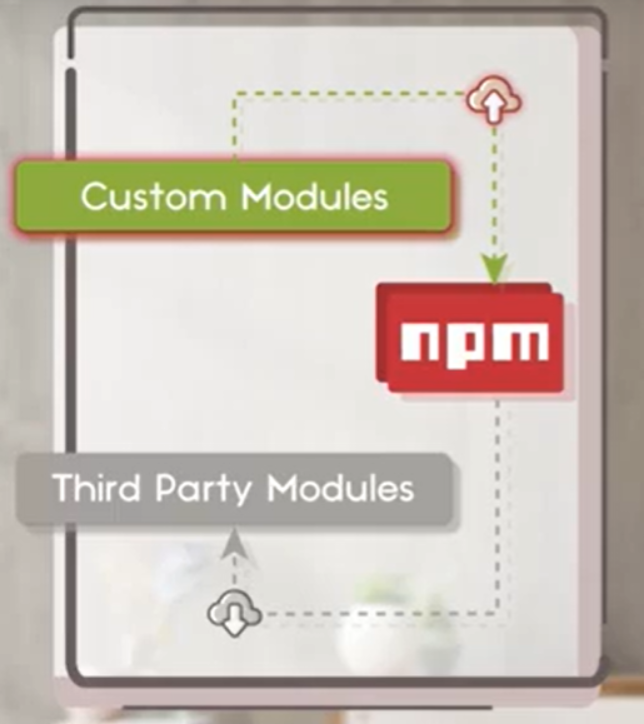
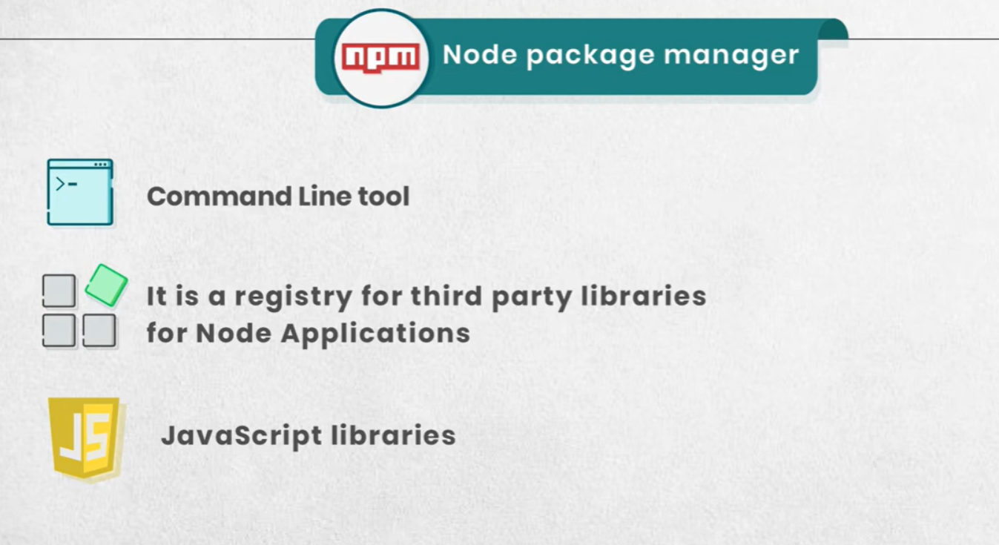
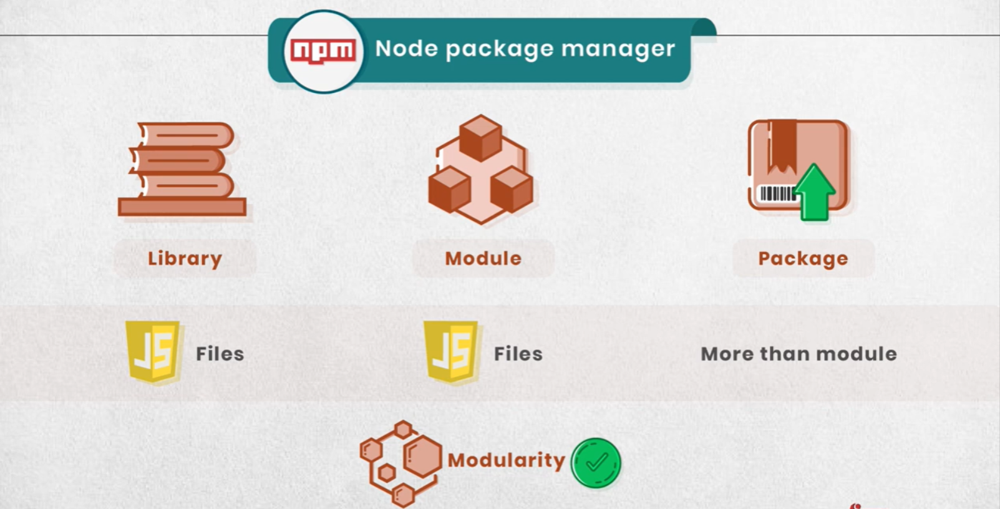
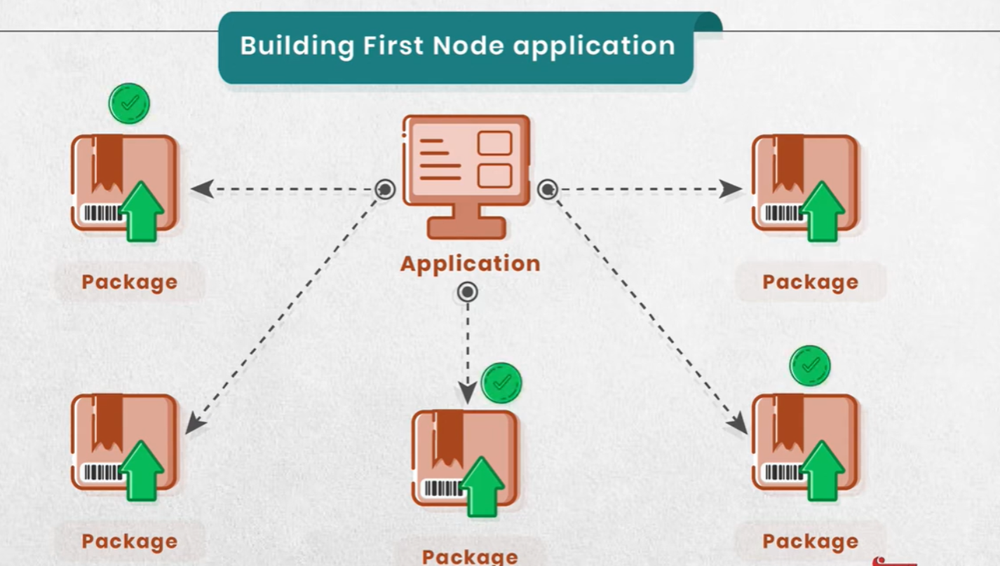

#  CH 04 -Building RESTful APIs Using Express

## Chapter Introduction

![Screenshot 2025-11-30 225743.png](<attachment:Screenshot 2025-11-30 225743.png>)

### Chapter Introduction: Express.js
---
Node.js خفيف وسريع لبناء تطبيقات الويب باستخدام (Framework) هو إطار عمل Express.js 
- فقط Node.js أسهل وأسرع من استخدام API يجعل بناء السيرفرات وواجهات الـ 
- والردود، وإدارة المسارات، ومعالجة البيانات (GET, POST, PUT, DELETE) يوفر طرق جاهزة للتعامل مع الطلبات 
- ولوحات التحكم RESTful، يُستخدم في بناء مواقع الإنترنت، تطبيقات 
---
### Express.js أهم مميزات 
1. إلخ :`/home`, `/about`**سهولة تعريف المسارات**  يمكنك تحديد مسارات متعددة بسهولة مثل 
2. **إدارة الطلبات والردود**: يوفر دوال جاهزة للتعامل مع بيانات الطلب والرد.
3. : يمكنك إضافة وظائف وسيطة (مثل التحقق من المستخدم أو معالجة البيانات) بين الطلب والاستجابة.**Middleware دعم** 
4.  :MongoDB أو MySQL **التكامل مع قواعد البيانات** يسهل ربط التطبيق بقاعدة بيانات مثل  
5. **مجتمع كبير ودعم قوي**: يوجد الكثير من الحزم الجاهزة والإضافات التي تسهل التطوير.

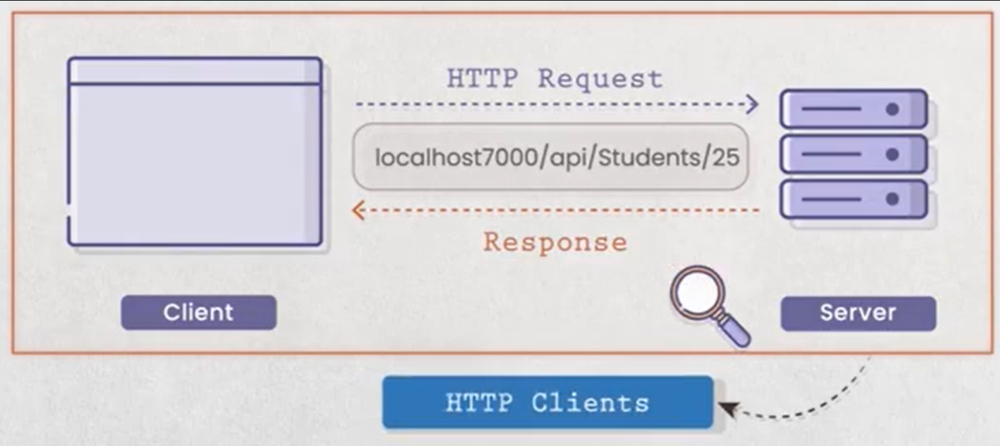

## RESTful Web Services


###  Web APIs (Application Programming Interface) شرح

![Screenshot 2025-11-30 225838.png](<attachment:Screenshot 2025-11-30 225838.png>)


**الصورة الأولى**

 خادم الويب HTTP عبر الإنترنت باستخدام بروتوكول (Request) مثل تطبيق أو متصفح، يرسل طلب (Client) بشكل عام. يوجد عميل Web API توضح فكرة الـ

 هذا يسمح لتطبيقات مختلفة (كموبايل أو ويب) بالتواصل مع الخادم والحصول على البيانات أو تنفيذ عمليات معينة JSON أو XML للعميل، وغالبًا تكون البيانات بصيغة (Response) الخادم يعالج الطلب ويرسل استجابة (Web Server). إلى 
 

---

###  RESTful Services شرح

![Screenshot 2025-11-30 225919.png](<attachment:Screenshot 2025-11-30 225919.png>)

**الصورة الثانية**
 التي يتواصل معها العميل. كل نقطة نهاية يمكنها تنفيذ عدة وظائف حسب نوع الطلب API وهي روابط الـ (EndPoint) هنا يتم التركيز على نقاط النهاية RESTful تشرح مفهوم خدمات

تعني نقل الحالة التمثيلية، أي أن كل طلب يحمل كل المعلومات اللازمة لتنفيذه بدون الاعتماد على حالة سابقة في الخادم REST هي نقاط النهاية التي تستجيب لطلبات العميل. كلمة (Routes) وبيانات الهيدر. المسارات ( GET أو POST مثل)
           

---

### وطرق الطلب HTTP Verbs شرح 
 

![Screenshot 2025-11-30 230019.png](<attachment:Screenshot 2025-11-30 230019.png>)


**الصورة الثالثة**

HTTP توضح كيف يرسل العميل طلبًا إلى الخادم باستخدام أحد طرق

محدد، والخادم يرد بالاستجابة المناسبة URL لحذف بيانات. الطلب يُرسل إلى عنوان DELETE لتحديث بيانات، PUT لإنشاء بيانات جديدة، POST لجلب البيانات، GET كل طريقة لها وظيفة محددة: مثل GET أو POST أو PUT أو DELETE مثل 
    .           .

---

###  HTTP Verb شرح وظائف كل

![Screenshot 2025-11-30 230048.png](<attachment:Screenshot 2025-11-30 230048.png>)

**الصورة الرابعة**

 بشكل مفصل: HTTP تشرح وظائف كل طريقة 
  

- **GET**: لجلب البيانات.
- **POST**: لإنشاء بيانات جديدة.
- **PUT**: لتحديث بيانات موجودة.
- **DELETE**: لحذف بيانات.
- **PATCH**: لتحديث جزء من البيانات.

مناسبة، والخادم يرد بالاستجابة حسب نوع الطلب. (EndPoint) كل طلب يُرسل إلى نقطة نهاية 


---
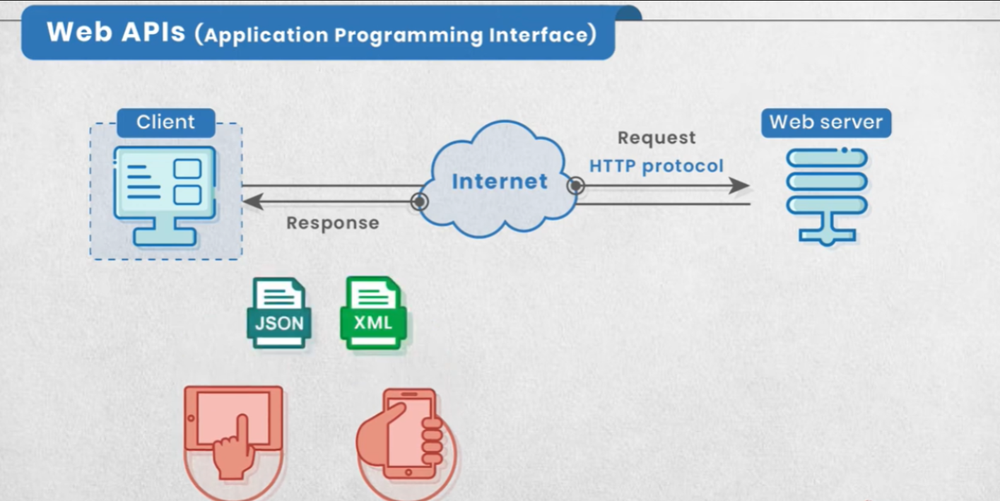
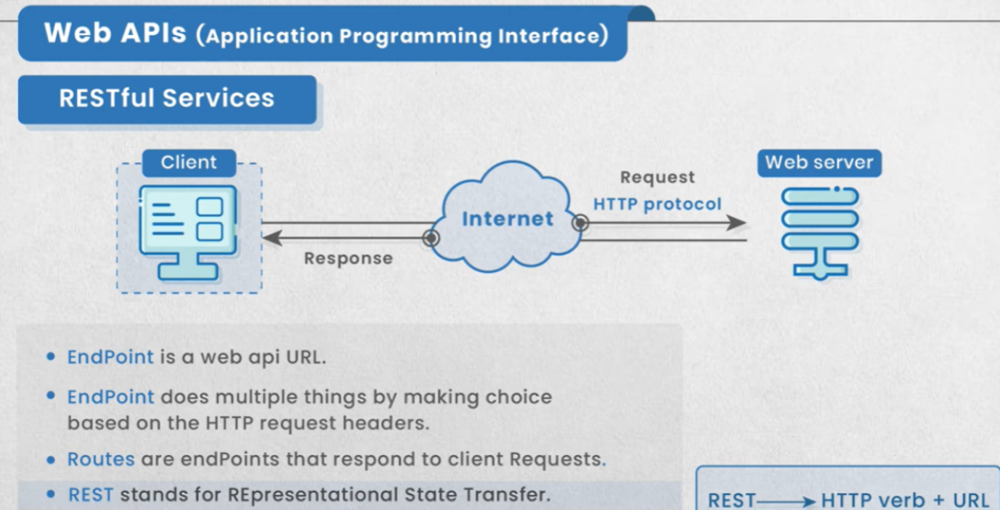
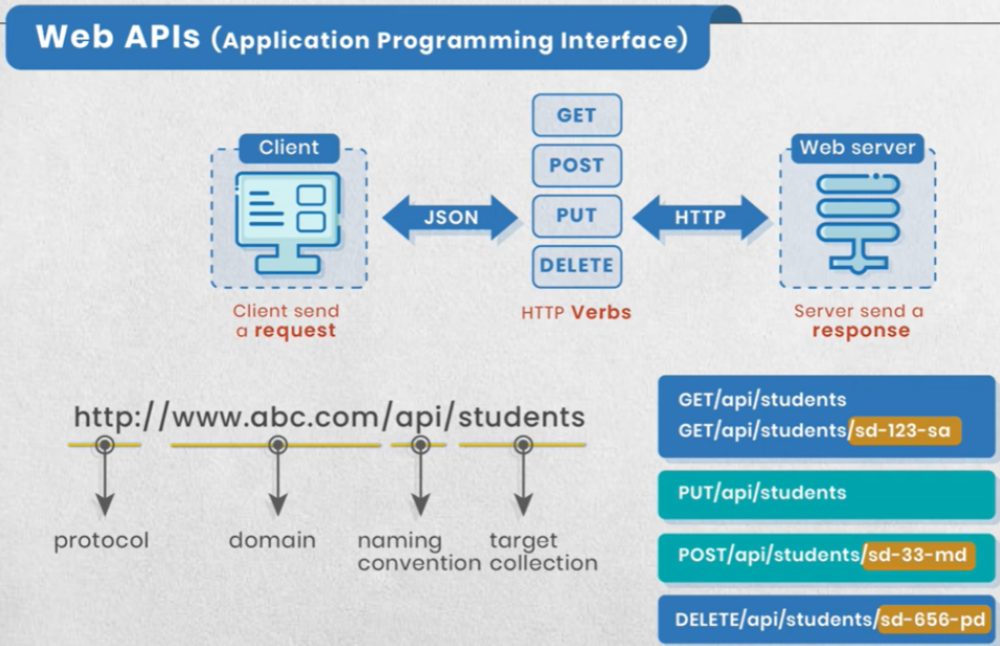
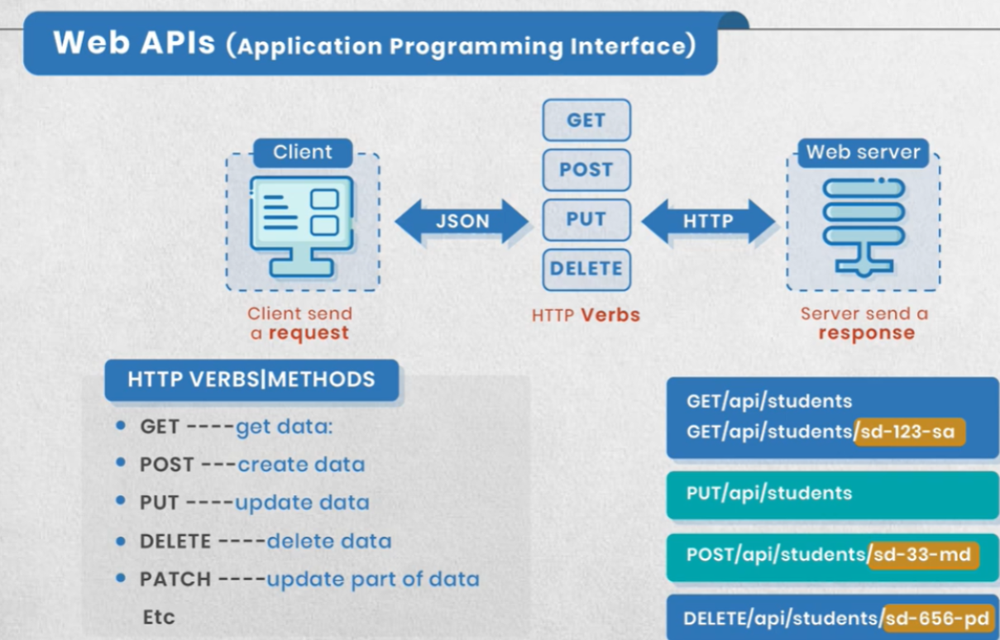

![Screenshot 2025-11-30 230222.png](<attachment:Screenshot 2025-11-30 230222.png>)

### وكيف تساعد المطور Node.js في Web Application Frameworks فكرة 
---
###  Web Application Frameworks؟ ما هي
لتسهيل تطوير تطبيقات الويب. Node.js هي أدوات أو مكتبات جاهزة تُبنى فوق 
بدل ما تكتب كل شيء من الصفر، هذه الأطر توفر لك أكواد جاهزة لإدارة المسارات، الطلبات، الردود، قواعد البيانات، الجلسات، وغيرها.
---
## كيف تساعد المطور؟
1. **تسريع التطوير**: توفر وظائف جاهزة مثل تعريف المسارات، التعامل مع الطلبات والردود، مما يوفر وقت وجهد كبير.
2. **تنظيم الكود**: تساعدك في تنظيم مشروعك بشكل أفضل عبر تقسيمه إلى ملفات ووحدات واضحة.
3. XSS وCSRF **أمان أفضل**: كثير من الأطر توفر حلول جاهزة للحماية من الهجمات الشائعة مثل .
4. **دعم المجتمع**: معظم الأطر لها مجتمع كبير، مما يعني وجود حلول جاهزة لأي مشكلة قد تواجهك.
5. **إدارة قواعد البيانات**: توفر طرق سهلة للاتصال بقواعد البيانات وإجراء العمليات عليها.
6. **إضافة ميزات بسهولة**: يمكنك إضافة ميزات مثل التحقق من المستخدم، رفع الملفات، التعامل مع الجلسات، إلخ، عبر إضافات جاهزة.
---
### أمثلة من الصورة
- **Express**: الأشهر والأسهل، مناسب للمبتدئين والمحترفين.
- **Koa**:لكنه أبسط وأكثر مرونة Express، من نفس فريق 
- **Sails**: MVC مناسب للتطبيقات الكبيرة، يوفر هيكل .
- **LoopBack**: وربطها بقواعد البيانات APIs قوي في بناء 
- **Meteor**: real-time إطار متكامل لتطبيقات الويب والـ
- **Hapi، Restify، ActionHero، Total.js، Moleculer، Facet، Frisby.js**: كل واحد له مميزات واستخدامات خاصة حسب نوع التطبيق.
---
**الخلاصة:** هذه الأطر تجعل بناء تطبيقات الويب أسرع وأسهل وأكثر أمانًا، وتسمح لك بالتركيز على منطق التطبيق بدل كتابة كل شيء من البداية.
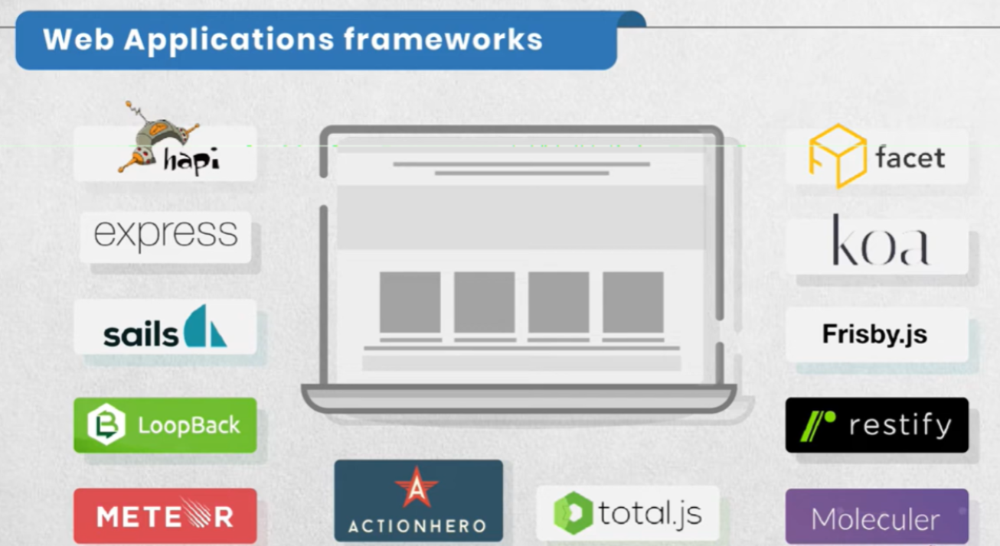

## Exploring Express Documentation

In [ ]:
// لمعرفة إصدار express الحالي في المشروع
// في الترمينال اكتب:
/// npm view express version

// استدعاء express وإنشاء تطبيق جديد
const express = require('express');
const app = express();

// تحديد البورت من متغير البيئة أو 3000
const port = process.env.PORT || 3000;

// تعريف مسار رئيسي /
app.get('/', (req, res) => {
  console.log("Request received");
  res.send("this is server ");
});

// تشغيل السيرفر على البورت المحدد
app.listen(port, () => {
  console.log(`Example app listening on port ${port}`);
});

// لتغيير البورت من الترمينال (ويندوز):
// set PORT=5000 && node filename.js

In [ ]:
// ملاحظات على الكود:
// 1. مسار "/api /students" فيه مسافة غير صحيحة، يجب أن يكون "/api/students" بدون مسافة.
// 2. عند البحث عن الطالب، يفضل تحويل id إلى رقم صحيح باستخدام parseInt.
// 3. صفحة "/" الرئيسية فارغة، يمكن إضافة رسالة ترحيب.
// 4. عند عدم وجود الطالب، استخدم status(404) مع رسالة خطأ واضحة.

// الكود بعد التصحيح:
const express = require('express');
const app = express();
const port = process.env.PORT || 3000;

const students = [
    { id: 1, name: 'Ali' },
    { id: 2, name: 'Mona' },
    { id: 3, name: 'Omar' },
];

// الصفحة الرئيسية
app.get('/', (req, res) => {
    res.send('Welcome to Students API');
});

// جلب كل الطلاب
app.get("/api/students", (req, res) => {
    res.json(students);
});

// جلب طالب حسب رقم الـ id
app.get("/api/students/:id", (req, res) => {
    let id = parseInt(req.params.id); // تحويل id إلى رقم صحيح
    const std = students.find(val => val.id === id);
    if (std) {
        res.json(std);
    } else {
        res.status(404).send({ error: "student not found" });
    }
});

app.listen(port, () => {
    console.log(`Example app listening on port ${port}`);
});

## Sending Data via Query String

### شرح طرق إرسال البيانات من العميل إلى السيرفر بناءً على الصور

![Screenshot 2025-12-05 234014.png](<attachment:Screenshot 2025-12-05 234014.png>)

1. **(المعامل في الرابط )URL Parameter**

 حيث الرقم 25 هو معرف الطالب. هذه الطريقة تُستخدم غالبًا لجلب بيانات عنصر محدد من السيرفر. `/api/Students/25` في هذه الطريقة، يتم إرسال البيانات كجزء من مسار الرابط نفسه. مثال: 


![Screenshot 2025-12-05 234241.png](<attachment:Screenshot 2025-12-05 234241.png>)

2. **(جسم الطلب) HTTP Request Body**:

 مثال: عند إرسال بيانات تسجيل مستخدم جديد، يتم إرسال البيانات (مثل الاسم والعمر) داخل جسم الطلب وليس في الرابط POST أو PUT عند استخدام طرق مثل (Body) هنا يتم إرسال البيانات داخل جسم الطلب 




![Screenshot 2025-12-05 234350.png](<attachment:Screenshot 2025-12-05 234350.png>)

3. **Query String (سلسلة الاستعلام)**

حيث يتم إرسال الاسم والعمر كمتغيرات يمكن للسيرفر قراءتها ومعالجتها. 
`/api/Students/25?nm=ali&age=10`  في هذه الطريقة، يتم إرسال البيانات كمتغيرات في نهاية الرابط بعد علامة الاستفهام 
    
لتنظيم استقبال ومعالجة البيانات في السيرفر. Node.js وExpress.js كل طريقة لها استخداماتها حسب نوع البيانات والغرض من الطلب، وغالبًا ما تُستخدم مع تقنيات مثل
  
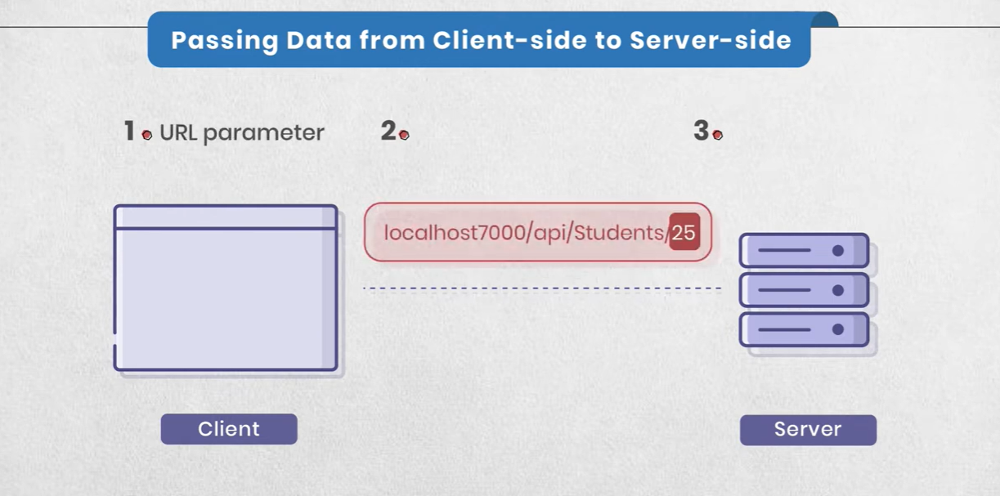
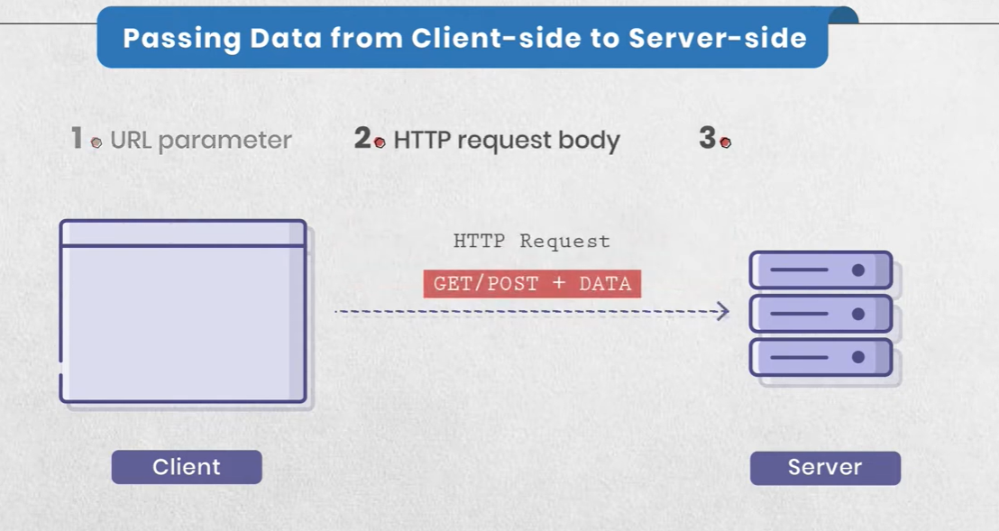
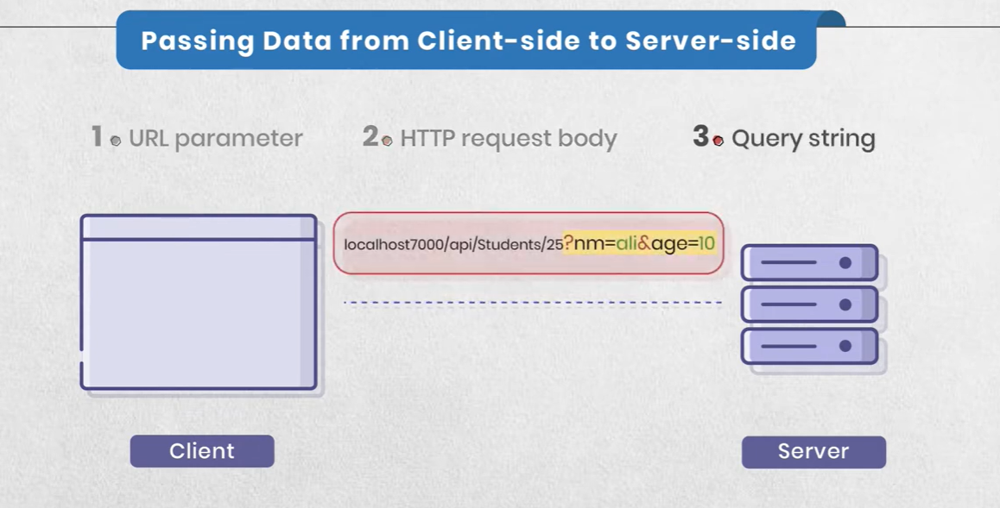

In [ ]:
import { console } from 'inspector';
import path from 'path';

const express = require('express')
const app = express()
const port = process.env.PORT || 3000;
const students = [
    { id: 1, name: 'Ali' },
    { id: 2, name: 'Mona' },
    { id: 3, name: 'Omar' },
    ];
app.get('/', (req, res) => {

    res.send("this is server ");

});

// requsest all students
app.get("/api /students", (req, res) => {
  
    res.json(students);

});


// requsest student to id 
// passing data from client to server via  url parameter
app.get("/api /students/:id", (req, res) => {  
   let id = req.params.id ;
   const std = students.find((val,idx,arr) => {return val.id == id})
if (std) {
    res.json(std);
} else {
    res.send("student not found");
}
});

// HTTP Request Body
// query String
// http://localhost:3000/api/students?name=mohamed_dyaa&age=25
//                                   |                 | 
//                           query string begins    separator

// query string  بتبدأ من علامة الاستفهام (؟) وبتتكون من أزواج key-value
//  في المثال ده: name و age هما ال keys، و mohamed_dyaa و 25 هما ال values 

// بيحصل generate لل query string لما نبعت بيانات من العميل (Client) للسيرفر (Server)
//  زي لما نبعت فورم (Form) أو نستخدم JavaScript عشان نبعت بيانات

// <form method="GET" >
//   <input type="text" name = ("fnm")------->key > value="Mohamed Dyaa"------->input name>
//   <input type="text" name="inm">
// </form>

// example
{/* <html>
<body>
<form method="GET" action="/students.html">
  <label for="fnm">Name:</label>
  <input type="text" name="name" placeholder="Enter name">
  <label for="age">Age:</label>
  <input type="number" name="age" placeholder="Enter age">
  <button type="submit">Submit</button>
</form>
<body>
</html> */}
app.get("/main")

// or

const path = require("path");  

app.get('/', (req, res) => {

    // res.send("this is server ");
    res.sendFile("main.html", { root: __dirname }); // root:__dirname  دي عشان تحدد المسار الكامل للملف
    res.sendFile(path.join(__dirname, "main.html")); // using path module


});

app.get("/welcome.html", (req, res) => {
    console.log(req.query); //  query دي عشان نجيب القيم الي بعد علامة الاستفهام (؟) في الرابط
    // res.send("this is server ");
    // res.sendFile("welcome.html", { root: __dirname }); // root:__dirname  دي عشان تحدد المسار الكامل للملف
    console.log(req.query.fnm); //  query دي عشان نجيب القيم الي بعد علامة الاستفهام (؟) في الرابط
     console.log(req.query.age); //  query دي عشان نجيب القيم الي بعد علامة الاستفهام (؟) في الرابط


    res.sendFile(path.join(__dirname, "/welcome.html")); // using path module



});


app.listen(port, () => {  
  console.log(`Example app listening on port ${port}`)
})




## URL-encoded body-parser Middleware


In [ ]:
// adding post request

import { console } from 'inspector';
import path from 'path';

const express = require('express')
const app = express()
const port = process.env.PORT || 3000;
const students = [
    { id: 1, name: 'Ali' },
    { id: 2, name: 'Mona' },
    { id: 3, name: 'Omar' },
    ];
app.get('/', (req, res) => {

    res.send("this is server ");

});

// requsest all students
app.get("/api /students", (req, res) => {
  
    res.json(students);

});

app.get("/api /students/:id", (req, res) => {  
   let id = req.params.id ;
   const std = students.find((val,idx,arr) => {return val.id == id})
if (std) {
    res.json(std);
} else {
    res.send("student not found");
}
});

// HTTP Request Body
// query String
// http://localhost:3000/api/students?name=mohamed_dyaa&age=25
//                                   |                 | 
//                           query string begins    separator

// query string  بتبدأ من علامة الاستفهام (؟) وبتتكون من أزواج key-value
//  في المثال ده: name و age هما ال keys، و mohamed_dyaa و 25 هما ال values 

// بيحصل generate لل query string لما نبعت بيانات من العميل (Client) للسيرفر (Server)
//  زي لما نبعت فورم (Form) أو نستخدم JavaScript عشان نبعت بيانات

// <form method="GET" >
//   <input type="text" name = ("fnm")------->key > value="Mohamed Dyaa"------->input name>
//   <input type="text" name="inm">
// </form>

// example
// <body>
// <form method="GET" action="/students.html">
//   <label for="fnm">Name:</label>
//   <input type="text" name="name" placeholder="Enter name">
//   <label for="age">Age:</label>
//   <input type="number" name="age" placeholder="Enter age">
//   <button type="submit">Submit</button>
// </form>
// <body>

// app.get("/main")

// or

const path = require("path");  

app.get('/', (req, res) => {

    res.sendFile("main.html", { root: __dirname }); 
    res.sendFile(path.join(__dirname, "main.html")); 


});

app.get("/welcome.html", (req, res) => {
    console.log(req.query); 
    console.log(req.query.fnm); 
    console.log(req.query.age); 


    res.sendFile(path.join(__dirname, "/welcome.html")); 



});

app.post("/students.html", (req, res) => { //action="/students.html">
    console.log("POST request received");
    res.send(path.join('thanks for submitting')); 
});


app.use(express.urlencoded({ extended: true }));
// لازم نحطها قبل ال POST request عشان تشتغل صح
//  دي middleware بتخلي إكسبرس يقدر يقرا البيانات اللي بتيجي من الفورم

app.post("/students.html", (req, res) => { //action="/students.html">
    console.log("POST request received");
    res.send(path.join(`thanks ${req.body.fnm} ${req.body.age} for submitting`)); 
});

app.listen(port, () => {  
  console.log(`Example app listening on port ${port}`)
})


 

## JSON body-parser


In [ ]:
app.use(express.urlencoded({ extended: true }));
// لازم نحطها قبل ال POST request عشان تشتغل صح
//  دي middleware بتخلي إكسبرس يقدر يقرا البيانات اللي بتيجي من الفورم
app.use(express.json());
// دي middleware بتخلي إكسبرس يقدر يقرا البيانات اللي بتيجي في شكل JSON
app.post("/students.html", (req, res) => { //action="/students.html">
    console.log("POST request received");
    console.log("Name:", req.body.fnm); 
    console.log("Age:", req.body.age);
    res.send(path.join(`thanks ${req.body.fnm} ${req.body.age} for submitting`)); 
}
);

app.listen(port, () => {  
  console.log(`Example app listening on port ${port}`)
})

app.get("/main")
app.get("/main", (req, res) => {    
    res.sendFile("main.html", { root: __dirname });
});


## Testing REST API Using PowerShell


### 1. الصورة التوضيحية
PowerShell باستخدام REST API الصورة التالية توضح خطوات اختبار.
  
يظهر مثال عملي على إرسال طلب 


وكيفية إرسال البيانات واستقبال الاستجابة. (GET أو POST)، واختيار نوع الطلب (URI) وتوضيح كيفية كتابة عنوان الخدمة PowerShell، باستخدام أوامر HTTP في الصورة، 
  
    

![Screenshot 2025-12-08 140642.png](<attachment:Screenshot 2025-12-08 140642.png>)

### 2. شرح محتوى الصورة خطوة بخطوة
- **(URI) تحديد عنوان الخدمة :** في الصورة، يتم كتابة عنوان الخدمة التي سيتم اختبارها.
- **(Method) اختيار نوع الطلب :**لإرسال بيانات. POST لجلب البيانات أو GET يتم تحديد نوع الطلب مثل 
- **(Body) كتابة جسم الطلب :**JSON يتم بناء جسم الطلب كـ (POSTزي) إذا كان الطلب يحتاج إرسال بيانات 
- **PowerShell تنفيذ الأمر في :**لإرسال الطلب واستقبال الاستجابة.`Invoke-WebRequest` أو `Invoke-RestMethod` يتم استخدام أوامر مثل 
- **عرض الاستجابة:**أو نص عادي. JSON وغالبًا تكون بيانات بصيغة PowerShell، تظهر نتيجة الطلب في 

### 3. مثال عملي من الصورة
```powershell
Invoke-WebRequest -Uri "https://api.example.com/data" -Method GET
```
أو
```powershell
$body = @{
    "name" = "Mohamed"
    "age" = 25
}
Invoke-RestMethod -Uri "https://api.example.com/data" -Method POST -Body ($body | ConvertTo-Json) -ContentType "application/json"
```

### 4. ملخص وجداول
| الأمر              | الوظيفة                       | مثال عملي                                      |
|--------------------|------------------------------|------------------------------------------------|
| Invoke-WebRequest  | HTTP إرسال واستقبال طلبات     | GET/POST/PUT/DELETE                            |
| Invoke-RestMethod  | JSON إرسال واستقبال واسترجاع  | استرجاع بيانات جاهزة من الخدمة                 |
| -Uri               | عنوان الخدمة                 | "https://api.example.com/data"                 |
| -Method            | نوع الطلب                    | GET, POST, PUT, DELETE                         |
| -Body              | جسم الطلب                    | POST أو PUT بيانات مرسلة في                     |
| -ContentType       | نوع البيانات                 | "application/json"                             |

### 5. نصائح عملية
- PowerShell من غير واجهة مستخدم، فقط من خلال REST API الصورة بتوضح إنك تقدر تختبر أي خدمة 
- تقدر ترسل بيانات وتستقبل الرد بسرعة وتراجع النتيجة.
- جرب بنفسك الأوامر اللي في الصورة وتأكد من الاستجابة.
- لتجربة الخدمات بسرعة بدون الحاجة لواجهة مستخدم PowerShell استخدم 
- دايمًا راجع الاستجابة وتأكد من صحة البيانات.

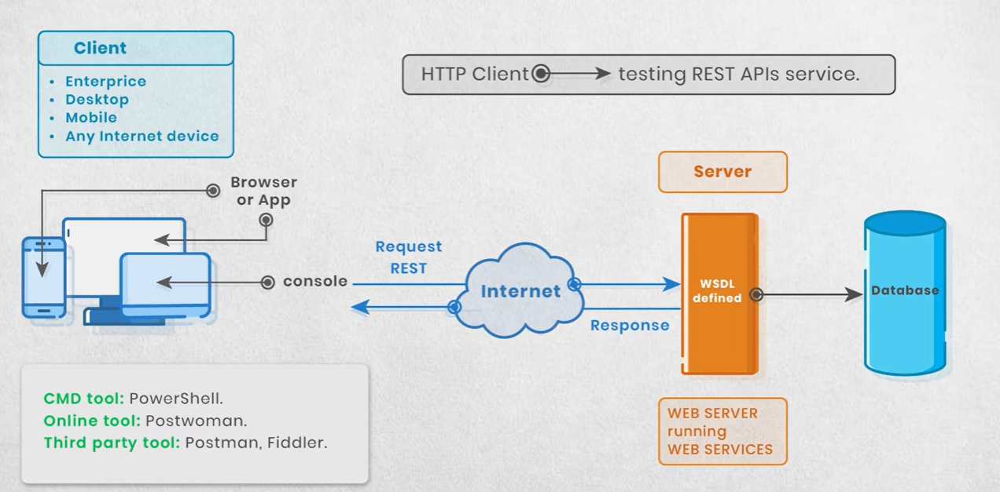

### PowerShell شرح أوامر  
---
#### 1. بسيط HTTP إرسال طلب 
 
```powershell
invoke-webrequest -uri link -method
```
- (link) إلى عنوان معين (GET أو POST زي) HTTP هذا الأمر يستخدم لإرسال طلب 
- هو الأمر الأساسي لإرسال واستقبال الطلبات `invoke-webrequest` 

#### 2. الحصول على محتوى الاستجابة
```powershell
(invoke-webrequest -uri link -method).content
```
- في النهاية`.content` هنا بنستخدم نفس الأمر لكن بنضيف 
- اللي رجعت من السيرفر، وغالبًا بتكون بيانات أو نص (Body) هذا يعرض محتوى الاستجابة 

#### 3. الحصول على كود حالة الاستجابة
```powershell
(invoke-webrequest -uri link -method).statuscontent
```
- (404 Not Found أو 200 OK زي) بنقدر نعرف كود حالة الاستجابة`.statuscontent` بإضافة 
- مفيد جدًا لمعرفة هل الطلب نجح أو فيه مشكلة.

#### 4.  Invoke-RestMethod باستخدام (Body) إرسال طلب مع بيانات 
  
```powershell
invoke-restmethod -uri link -method -body @{}
```
- POST أو PUT غالبًا في حالة (Body) مع بيانات HTTP هذا الأمر يستخدم لإرسال طلب 
-  هنا معناها أنك بتبعت بيانات في جسم الطلب (مثلاً بيانات مستخدم أو نموذج).`@{}` 
-  تقدر تتعامل معاها مباشرة (JSONمثلاً) بيرجع البيانات بشكل جاهز`invoke-restmethod`

----

## Testing REST API Using Postwoman


### CORS وشرح (Hoppscotch حاليًا اسمه) Postwoman شرح 
---
#### Postwoman؟ ما هو 
- REST API هو أداة مجانية على الإنترنت لاختبار (Hoppscotch الاسم الجديد:) **Postwoman** 
- لأي سيرفر وتشوف الاستجابة مباشرة بدون الحاجة لبرمجة أو استخدام أدوات معقدة.HTTP (GET, POST, PUT, DELETE...) تقدر من خلالها ترسل طلبات 
- الشهيرة، لكنها أخف وأسرع وتعمل من المتصفح مباشرة. Postman تشبه أداة 
- بسرعة، إرسال بيانات، مشاهدة الاستجابة، تجربة الهيدر، وغيرها API مفيدة جدًا للمطورين لتجربة الـ 
 
#### CORS (Cross-Origin Resource Sharing)شرح اختصار
![Screenshot 2025-12-08 164057.png](<attachment:Screenshot 2025-12-08 164057.png>)
- Cross-Origin Resource Sharing هو اختصار لـ**CORS** 
- معناه: مشاركة الموارد بين مصادر مختلفة.
- هو آلية بتسمح لموقع (أو تطبيق ويب) يشتغل على دومين معين إنه يطلب بيانات أو موارد من سيرفر على دومين مختلف.
- يسمح بذلك لو السيرفر أضاف هيدر معين في الاستجابة CORS المتصفح بشكل افتراضي بيمنع الطلبات بين دومينات مختلفة (لأسباب أمان)، لكن 
- مثال عملي:
- علشان المتصفح يسمح بالاتصال. CORS لازم السيرفر يضيف هيدر`api.com` على API وعايز يجيب بيانات من `example.com`على frontend عندك موقع 
- Error المتصفح هيمنع الطلب وهيظهر لك CORS، لو السيرفر مش بيدعم 

---
**الخلاصة:**
- من المتصفح. API أداة قوية وسهلة لاختبار أي Postwoman/Hoppscotch 
- من دومين مختلف API هو نظام أمان في المتصفح، لازم السيرفر يدعمه لو هتتعامل مع CORS 

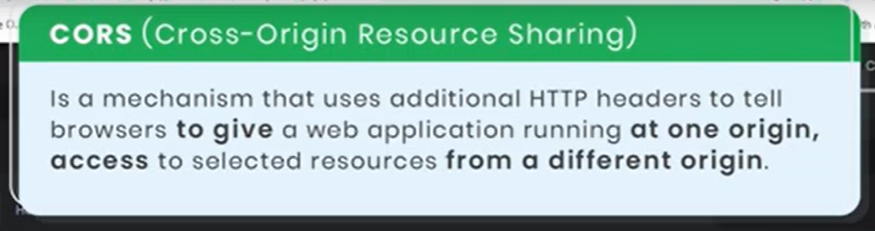

----

## Handling HTTP POST Requests


In [ ]:
const path = require("path");
const express = require("express");
const app = express();
const port = process.env.PORT || 3000;

// Middleware لقراءة البيانات من الـ Request
app.use(express.urlencoded({ extended: true })); // لقراءة بيانات الـ Form
app.use(express.json()); // لقراءة بيانات الـ JSON


// مصفوفة الطلاب - متخزنة في الذاكرة (RAM)
const Students = [
    { name: 'Ali', dept: 'PD', id: 1 },
    { name: 'Nour', dept: 'SA', id: 2 },
    { name: 'Mona', dept: 'MD', id: 3 },
    { name: 'Sara', dept: 'SAP', id: 4 },
    { name: 'Mostafa', dept: 'EB', id: 5 },
    { name: 'Ahmed', dept: 'GD', id: 6 },
    { name: 'Noha', dept: 'GA', id: 7 },
];

// ═══════════════════════════════════════════════════════════════
// 🌐 Routes - نقاط الاتصال بالـ API
// ═══════════════════════════════════════════════════════════════



// ── Route 1: الصفحة الرئيسية ──
app.get("/", (req, res) => {
    res.sendFile(path.join(__dirname, "index.html"));
    // بيرجع ملف HTML الرئيسي
});

// ── Route 2: جلب كل الطلاب (Read All) ──
app.get("/api/students", (req, res) => {
    res.json(Students);
    // بيرجع كل الطلاب في صيغة JSON
    // مثال الاستخدام في Postman:
    // Method: GET
    // URL: http://localhost:3000/api/students
});

// ── Route 3: جلب طالب محدد بالـ ID (Read One) ──
app.get("/api/students/:id", (req, res) => {
    const id = parseInt(req.params.id); // بناخد الـ id من الـ URL ونحوله لرقم
    const student = Students.find((val) => val.id === id); // بنبحث عن الطالب
    
    if (student) {
        res.json(student); // لو لقينا الطالب، بنرجع بياناته
    } else {
        res.status(404).send("student not found"); // لو مش موجود، بنرجع رسالة خطأ
    }
    // مثال الاستخدام في Postman:
    // Method: GET
    // URL: http://localhost:3000/api/students/1
});

// ── Route 4: إضافة طالب جديد (Create) ──
app.post("/api/students", (req, res) => {
    const newStudent = req.body; // بناخد بيانات الطالب الجديد من الـ Request Body
    newStudent.id = Students.length + 1; // بنحط ID تلقائي (آخر رقم + 1)
    Students.push(newStudent); // بنضيف الطالب للمصفوفة
    res.json(newStudent); // بنرجع بيانات الطالب الجديد كتأكيد
    
    // مثال الاستخدام في Postman:
    // Method: POST
    // URL: http://localhost:3000/api/students
    // Body (raw - JSON):
    // {
    //   "name": "محمد",
    //   "dept": "CS"
    // }
});

// ── Route 5: تحديث بيانات طالب موجود (Update) ──
app.put("/api/students/:id", (req, res) => {
    const id = parseInt(req.params.id); // بناخد الـ ID من الـ URL
    let idx = Students.findIndex((val) => val.id === id); // بنبحث عن موقع الطالب في المصفوفة
    
    if (idx !== -1) { // لو الطالب موجود
        // بنمر على كل خاصية في الـ Body ونحدثها
        for (let key in req.body) {
            Students[idx][key] = req.body[key];
        }
        res.json(Students[idx]); // بنرجع البيانات المحدثة
    } else {
        res.status(404).send("student not found"); // لو الطالب مش موجود
    }
    
    // مثال الاستخدام في Postman:
    // Method: PUT
    // URL: http://localhost:3000/api/students/1
    // Body (raw - JSON):
    // {
    //   "name": "علي المحدث",
    //   "dept": "IT"
    // }
    // 
    // ملحوظة: ممكن تحدث خاصية واحدة بس أو كل الخصائص
});

// ── Route 6: حذف طالب (Delete) ──
app.delete("/api/students/:id", (req, res) => {
    const id = parseInt(req.params.id); // بناخد الـ ID من الـ URL
    let idx = Students.findIndex((val) => val.id === id); // بنبحث عن موقع الطالب
    
    if (idx !== -1) { // لو الطالب موجود
        let deletedstd = Students.splice(idx, 1); // بنحذف الطالب من المصفوفة
        res.send({ 
            message: "student deleted successfully", 
            student: deletedstd[0] 
        }); // بنرجع رسالة النجاح مع بيانات الطالب المحذوف
    } else {
        res.status(404).send("student not found"); // لو الطالب مش موجود
    }
    
    // مثال الاستخدام في Postman:
    // Method: DELETE
    // URL: http://localhost:3000/api/students/1
    // 
    // ⚠️ تحذير: الحذف نهائي ومافيش طريقة للتراجع!
});

// ═══════════════════════════════════════════════════════════════
// 🚀 تشغيل السيرفر
// ═══════════════════════════════════════════════════════════════

app.listen(port, () => {
    console.log(`Server running on port ${port}`);
});
// لو عاوز اضيف بيانات جديده بي واسطه Postman لازم اشغل السيرفر ده في الترمينال
// في الترمينال اكتب:
// node api-test.js
// هيشتغل على بورت 3000
// بعد كده افتح Postman عشان تبعت Requests
// بعدين اخش علي body واختار raw وبعدين JSON
// ودخل البيانات اللي عايزها في شكل JSON كده {"name": "mohamed" , "dept ":"sD" }



// ═══════════════════════════════════════════════════════════════
// 📚 دليل استخدام Postman لاختبار الـ API
// ═══════════════════════════════════════════════════════════════

// ── 1️⃣ تثبيت Postman ──
// • افتح الموقع الرسمي: https://www.postman.com/downloads/
// • حمل النسخة المناسبة لنظام التشغيل بتاعك (Windows, Mac, Linux)
// • اتبع تعليمات التثبيت على الموقع
// • بعد التثبيت، افتح Postman وسجل دخول (اختياري) أو استخدمه مباشرة

// ── 2️⃣ تشغيل السيرفر ──
// في الـ Terminal:
// 1. تأكد إنك في مجلد المشروع
// 2. اكتب: node api-test.js
// 3. لازم تشوف: "Server running on port 3000"
// 4. متقفلش الـ Terminal طول ما بتختبر الـ API

// ── 3️⃣ إعداد Postman ──
// • اختار نوع الـ Request (GET, POST, PUT, DELETE) من القائمة المنسدلة
// • اكتب الـ URL في الخانة المخصصة
// • لو الـ Request من نوع POST أو PUT:
//   - اضغط على تبويب "Body" تحت الـ URL
//   - اختار "raw"
//   - من القائمة المنسدلة على اليمين اختار "JSON"
//   - اكتب البيانات بصيغة JSON
// • اضغط "Send" لإرسال الـ Request

// ═══════════════════════════════════════════════════════════════
// 🧪 أمثلة عملية للاختبار
// ═══════════════════════════════════════════════════════════════

// ── ✅ GET - جلب كل الطلاب ──
// Method: GET
// URL: http://localhost:3000/api/students
// النتيجة المتوقعة: مصفوفة JSON بها 7 طلاب

// ── ✅ GET - جلب طالب محدد بالـ ID ──
// Method: GET
// URL: http://localhost:3000/api/students/1
// النتيجة المتوقعة: بيانات الطالب Ali

// ── ✅ POST - إضافة طالب جديد ──
// Method: POST
// URL: http://localhost:3000/api/students
// Body (raw - JSON):
// {
//   "name": "محمد",
//   "dept": "CS"
// }
// النتيجة المتوقعة: الطالب الجديد مع id = 8

// ── ✅ PUT - تحديث بيانات طالب موجود ──
// Method: PUT
// URL: http://localhost:3000/api/students/1
// Body (raw - JSON):
// {
//   "name": "علي المحدث",
//   "dept": "IT"
// }
// النتيجة المتوقعة: بيانات الطالب المحدثة

// ── ✅ DELETE - حذف طالب ──
// Method: DELETE
// URL: http://localhost:3000/api/students/1
// النتيجة المتوقعة: رسالة تأكيد الحذف مع بيانات الطالب المحذوف

// ═══════════════════════════════════════════════════════════════
// ⚠️ ملاحظات مهمة
// ═══════════════════════════════════════════════════════════════

// 🔴 المشاكل الشائعة وحلولها:
// ──────────────────────────
// 1. "Cannot GET /api/students"
//    → السيرفر مش شغال أو فيه خطأ في الـ URL
//    → تأكد إن السيرفر شغال في الـ Terminal
//    → تأكد إن الـ URL صحيح بالضبط

// 2. "EADDRINUSE: address already in use"
//    → البورت 3000 مستخدم من برنامج تاني
//    → أقفل السيرفر القديم (Ctrl+C) وشغله تاني
//    → أو غير البورت في بداية الكود

// 3. البيانات مش بتتحفظ بعد إعادة تشغيل السيرفر
//    → ده طبيعي! البيانات متخزنة في الذاكرة (RAM)
//    → لو عايز حفظ دائم، لازم تستخدم Database زي MongoDB

// 4. "SyntaxError: Unexpected token" في Postman
//    → تأكد إنك اخترت "JSON" من القائمة المنسدلة في Body
//    → تأكد إن الـ JSON صحيح (استخدم أقواس مزدوجة للمفاتيح)

// 💡 نصائح للتطوير:
// ──────────────────
// • استخدم Postman Collections لحفظ كل الـ Requests
// • اختبر كل endpoint بعد كتابته مباشرة
// • راجع الـ console في الـ Terminal لمتابعة الأخطاء
// • جرب حالات الخطأ (مثلاً: طلب طالب غير موجود)
// • استخدم متغيرات في Postman لتسهيل تغيير الـ URL

// 🎯 الخطوة التالية:
// ──────────────────
// • تعلم MongoDB أو PostgreSQL لحفظ البيانات بشكل دائم
// • أضف Authentication و Authorization باستخدام JWT
// • تعلم Validation للبيانات باستخدام مكتبات مثل Joi أو express-validator
// • حسّن أمان الـ API باستخدام Helmet.js و CORS
// • تعلم إنشاء RESTful API متكاملة مع best practices

# CH05 - Validation Using Ajv and JSON Schema

## AJV التحقق من البيانات باستخدام  

![Screenshot 2025-12-10 142404.png](<attachment:Screenshot 2025-12-10 142404.png>)

AJV باستخدام مكتبة (Web server) والخادم (Client) الصورة أعلاه تشرح كيف تتم عملية التحقق من البيانات بين العميل 
للتحقق من صحتها (Schema) عند إرسال العميل طلب إلى الخادم عبر الإنترنت، يقوم الخادم بفحص البيانات (مثل الاسم والعمر) باستخدام مخطط محدد 
- إذا كانت البيانات مطابقة للمواصفات (مثلاً: الاسم نص، العمر رقم)، يتم قبولها وإرسال استجابة مناسبة للعميل.
- إذا كانت البيانات غير صحيحة، يتم رفضها أو إرسال رسالة خطأ توضح السبب.
هذه العملية تحمي التطبيق من استقبال بيانات غير صحيحة أو ضارة، وتضمن أن كل البيانات الداخلة للنظام منظمة وصحيحة.

---
### AJV؟ ما هي مكتبة 
. JSON Schema تُستخدم للتحقق من صحة البيانات بناءً على مخططات Node.js هي مكتبة شهيرة في AJV 
. تسمح لك بتحديد شكل البيانات المطلوبة (مثل نوع كل خاصية)، وتقوم تلقائيًا بفحص البيانات المدخلة والتأكد من مطابقتها للمواصفات
. لضمان أن البيانات المستقبلة من المستخدمين أو الأنظمة الخارجية صحيحة ومنظمة وسهلة المعالجة API بكثرة في تطبيقات الـ AJV تُستخدم


**AJV مميزات :**
- سرعة عالية في التحقق من البيانات.
- JSON Schema تدعم معظم خصائص 
- . REST APIs وخصوصًا في بناء Node.js سهلة الاستخدام في مشاريع 

---
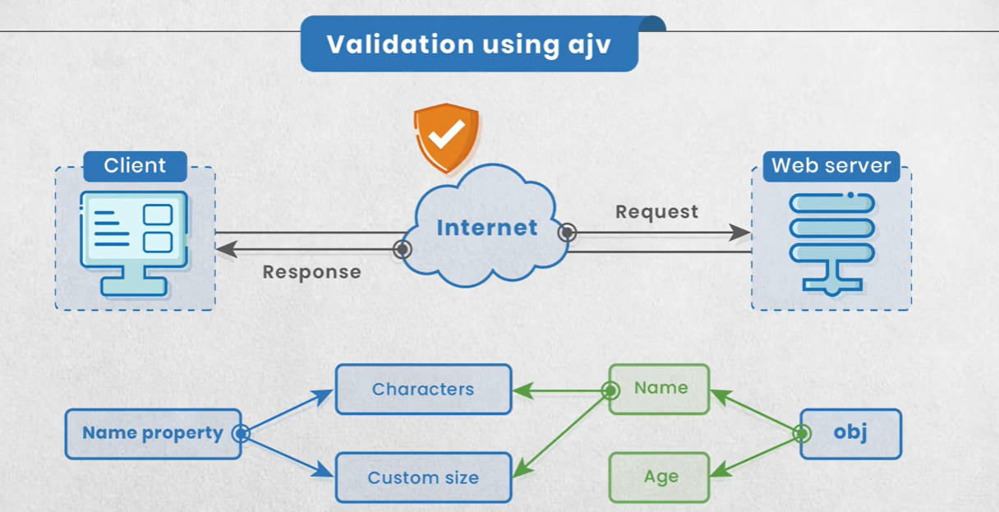

In [ ]:
// تثبيت مكتبة ajv عبر npm: npm install ajv
const Ajv = require('ajv');
const ajv = new Ajv();
// تعريف مخطط البيانات المطلوب
const schema = {
  type: 'object',
  properties: {
    name: { type: 'string' },
    age: { type: 'number' }
  },
  required: ['name', 'age'],
  additionalProperties: false
};
// بيانات للاختبار
const data = { name: 'Mohamed', age: 25 };
// التحقق من صحة البيانات
const validate = ajv.compile(schema);
const valid = validate(data);
if (valid) {
  console.log('البيانات صحيحة');
} else {
  console.log('البيانات غير صحيحة:', validate.errors);
}

### شرح الكود العملي

.(number) وعمر (string) الذي يحدد أن البيانات يجب أن تحتوي على اسم (schema) ثم عرفنا مخطط البيانات المطلوب AJV، في الكود السابق قمنا أولاً بتثبيت مكتبة 
. للتحقق من صحة هذا الكائن بناءً على المخطط AJV بعد ذلك أنشأنا كائن بيانات للاختبار، واستخدمنا 

إذا كانت البيانات صحيحة ستظهر رسالة بذلك، وإذا كانت غير صحيحة ستظهر الأخطاء التي توضح سبب عدم مطابقة البيانات للمخطط.

هذه الطريقة تساعدك في حماية تطبيقك من استقبال بيانات غير صحيحة أو غير متوقعة.

## JSON Schema


## JSON Schema شرح خصائص الـ 
لتحديد الخصائص التي يجب أن يحتويها الكائن `properties` نستخدم الكلمة المفتاحية JSON Schema، في مخطط (Object) عند تعريف كائن 
  
`enum` كل خاصية يتم تحديد اسمها ونوعها (مثل رقم أو نص)، ويمكن أيضًا تحديد القيم المسموح بها باستخدام
- يجب أن تكون رقم `number` الخاصية 
-  (string) يجب أن تكون نص `street_name` الخاصية 
- "Street" أو "Avenue" أو "Boulevard" مثل `enum` يجب أن تكون نص، ولكن يجب أن تكون إحدى القيم المحددة في `street_type` الخاصية 

عند التحقق من البيانات، سيتم رفض أي قيمة غير مطابقة للمواصفات المحددة في المخطط.

---
### (additionalProperties) التحكم في الخصائص الإضافية 
`additionalProperties` يمكنك التحكم في قبول أو رفض الخصائص الإضافية غير المعرفة في المخطط باستخدام الكلمة المفتاحية 
- سيتم قبولها.`properties` بشكل افتراضي، أي خاصية إضافية غير معرفة في 
- سيتم رفض أي خاصية غير معرفة في المخطط `additionalProperties: false` إذا تم تعيين 
هذا يساعدك في حماية البيانات من إدخال خصائص غير مرغوب فيها أو غير متوقعة.

**مثال عملي:**
```json
{
  "type": "object",
  "properties": {
    "number": { "type": "number" },
    "street_name": { "type": "string" },
    "street_type": { "type": "string", "enum": ["Street", "Avenue", "Boulevard"] }
  },
  "additionalProperties": false
}
```

In [ ]:
import { type } from "os";

const path = require("path");
const express = require("express");
const app = express();
const port = process.env.PORT || 3000;
const Ajv = require('ajv');// استدعاء مكتبة AJV للتحقق من صحة البيانات
const ajv = new Ajv();// إنشاء كائن AJV جديد
let validator = ajv.compile(schema); // إنشاء دالة تحقق بناءً على المخطط
// الي فوق ده هستدعاه في ال POST request عشان يتحقق من البيانات اللي جاية
// تعريف مخطط البيانات المطلوب

const schema = {
    "type": 'object',  // نوع البيانات لازم يكون كائن (Object)
    "properties": {    // الخصائص المطلوبة في الكائن
        "name": { "type": 'string', // نوع الاسم لازم يكون نص 

                  "minLength": 3,  // طول الاسم لا يقل عن 3 حروف
                  "maxLength": 30,  // طول الاسم لا يزيد عن 30 حرف
                  "pattern": "^[A-Za-z]+$" // الاسم لازم يحتوي على حروف فقط

                },  

        "dapt": { "type": 'string', // نوع الاسم لازم يكون نص
       "enum": ["PD", "SA", "MD", "SAP", "EB", "GD", "GA"] , // القيم المسموح بها للقسم
      "maxLength": 2,  // طول الاسم لا يزيد عن 2 حروف
      "minLength": 2 ,  // طول الاسم لا يقل عن 2 حروف
      "required": ["name", "dept"], // الخصائص المطلوبة في الكائن
      "maxProperties": 2, // الحد الأقصى لعدد الخصائص في الكائن
       "minProperties": 2  // الحد الأدنى لعدد الخصائص في الكائن



},


}};// Middleware لقراءة البيانات من الـ Request

app.use(express.urlencoded({ extended: true })); 
app.use(express.json()); 


const Students = [
    { name: 'Ali', dept: 'PD', id: 1 },
    { name: 'Nour', dept: 'SA', id: 2 },
    { name: 'Mona', dept: 'MD', id: 3 },
    { name: 'Sara', dept: 'SAP', id: 4 },
    { name: 'Mostafa', dept: 'EB', id: 5 },
    { name: 'Ahmed', dept: 'GD', id: 6 },
    { name: 'Noha', dept: 'GA', id: 7 },
];
app.get("/", (req, res) => {
    res.sendFile(path.join(__dirname, "index.html"));
});

app.get("/api/students", (req, res) => {
    res.json(Students);

});

app.get("/api/students/:id", (req, res) => {
    const id = parseInt(req.params.id); 
    const student = Students.find((val) => val.id === id); 
    
    if (student) {
        res.json(student); 
    } else {
        res.status(404).send("student not found"); 
    }
  
});

app.post("/api/students", (req, res) => {
let valid = validator(req.body); // التحقق من صحة البيانات باستخدام دالة التحقق
if (valid) {
    const newStudent = req.body; 
    newStudent.id = Students.length + 1; 
    Students.push(newStudent); 
    res.json(newStudent); 
} else {
    res.status(403).json({ errors: validator.errors }); // إرسال الأخطاء في حالة عدم صحة البيانات
    // res.sendStatus(403);// ده لو عايز ابعت بس كود الحالة من غير رسالة
}});

app.put("/api/students/:id", (req, res) => {
    const id = parseInt(req.params.id); 
    let idx = Students.findIndex((val) => val.id === id); 
    
    if (idx !== -1) { 
        for (let key in req.body) {
            Students[idx][key] = req.body[key];
        }
        res.json(Students[idx]); 
    } else {
        res.status(404).send("student not found"); 
    }

});

app.delete("/api/students/:id", (req, res) => {
    const id = parseInt(req.params.id); 
    let idx = Students.findIndex((val) => val.id === id); 
    
    if (idx !== -1) { 
        let deletedstd = Students.splice(idx, 1); 
        res.send({ 
            message: "student deleted successfully", 
            student: deletedstd[0] 
        }); 
    } else {
        res.status(404).send("student not found"); 
    }

});

app.listen(port, () => {
    console.log(`Server running on port ${port}`);
});

----

# CH06 - Express- Advanced Topics

## What is Express Middleware?

### Express طرق إرسال البيانات من العميل إلى خدمة 
هناك عدة طرق لإرسال البيانات من العميل إلى الخادم: (API) عند التعامل مع أي خدمة ويب 
 
1. `/user/123`  تُستخدم لنقل بيانات بسيطة ضمن عنوان الرابط، مثل  **URL (URL Parameters) معلمات :**
   - مناسبة لنقل معرفات أو بيانات قصيرة ومباشرة، وغالبًا ما تُستخدم للوصول إلى مورد محدد مثل مستخدم أو منتج.
   - `req.params`تُقرأ في الخادم باستخدام 
   - `req.params.user`، يمكن للخادم الحصول على رقم المستخدم من `/user/5` مثال: عند زيارة 

2.  `/search?name=Ali&age=22` تُضاف بعد علامة الاستفهام في الرابط، مثل **(Query Strings) سلاسل الاستعلام :** 
   - تُستخدم لنقل بيانات بحث أو تصفية أو خيارات إضافية، ويمكن إرسال أكثر من قيمة في نفس الرابط.
   - `req.query` تُقرأ في الخادم باستخدام .
   - `req.query.name` و `req.query.age` ، يمكن للخادم الحصول على الاسم والعمر من `/search?name=Ali&age=22` مثال: عند زيارة 


3.  JSON لنقل بيانات أكبر أو أكثر تعقيدًا، مثل بيانات نموذج أو POST و PUT يُستخدم في طلبات **(Request Body) جسم الطلب :**  
   - `express.json()` أو `express.urlencoded()` بعد إضافة المحللات المناسبة مثل `req.body` مثالية لنقل بيانات كثيرة أو حساسة، مثل بيانات تسجيل مستخدم أو رفع ملف، وتُقرأ في الخادم من خلال 
   - (Form Fields) أو حقول نموذج JSON عند إرسال البيانات عبر جسم الطلب، غالبًا ما تكون بصيغة 

![Screenshot 2025-12-11 011723.png](<attachment:Screenshot 2025-12-11 011723.png>)

> **الصورة توضح بالتفصيل:**
> - للبحث والتصفية، وجسم الطلب للبيانات المعقدة أو الكبيرة Query Strings للبيانات البسيطة، URL العميل يمكنه إرسال البيانات بطرق متعددة حسب الحاجة: معلمات 
> - كل طريقة لها استخداماتها حسب نوع البيانات وحجمها، مما يمنح المطور مرونة في تصميم واجهة الخدمة.
> - `req.body` وجسم الطلب من `req.query` وسلاسل الاستعلام من `req.params` المناسبة، مثل قراءة معلمات Express الخادم يستقبل هذه البيانات ويعالجها باستخدام أدوات URLمن    

---
### Middleware  البيانات باستخدام الـ Express كيف يعالج 
  
لتحليل البيانات القادمة من العميل **(parsers) المحللات** يتم استخدام ما يسمى  Express، في تطبيقات 
- JSON لتحليل البيانات المرسلة بصيغة `express.json()` .
- (form) لتحليل بيانات النموذج `express.urlencoded()`
هذه المحللات تُضاف للتطبيق ليتمكن من قراءة البيانات ومعالجتها بشكل صحيح قبل أي معالجة أخرى، وتُعتبر أول خطوة في سلسلة المعالجة.

### Middlewareما هو الـ 
 تُستخدم لمعالجة الطلبات قبل إرسال الاستجابة النهائية  Express هو دالة وسيطة في middleware الـ 
- وكل دالة يمكنها تعديل الطلب أو الاستجابة أو تنفيذ منطق معين مثل التحقق من المستخدم أو تسجيل الدخول أو التحقق من صحة البيانات middleware، الطلب يمر عبر سلسلة من الـ 
- التالي، وهذا يسمح بتقسيم منطق التطبيق إلى خطوات صغيرة وواضحة middleware لتمرير التحكم للـ `next()` إذا لم تكن الدالة الأخيرة، يجب استدعاء 
- هو الذي يرسل الاستجابة النهائية للعميل، مثل إرسال بيانات أو رسالة نجاح middleware آخر  

![Screenshot 2025-12-11 011931.png](<attachment:Screenshot 2025-12-11 011931.png>)

> **الصورة توضح بالتفصيل:**
> - كل واحدة يمكنها تنفيذ منطق معين أو تعديل الطلب middleware الطلب يبدأ من العميل ويمر عبر سلسلة من دوال الـ 
> - إذا لم تكن هي المسؤولة عن إرسال الاستجابة النهائية، مما يسمح بمرور الطلب عبر مراحل متعددة `next()` تستدعي middleware كل دالة  
> - هذا النظام يجعل التطبيق مرنًا وسهل التوسعة، حيث يمكن إضافة أي منطق أو تحقق في أي مرحلة من السلسلة، مثل التحقق من صلاحيات المستخدم أو تسجيل الأحداث أو معالجة البيانات.

---
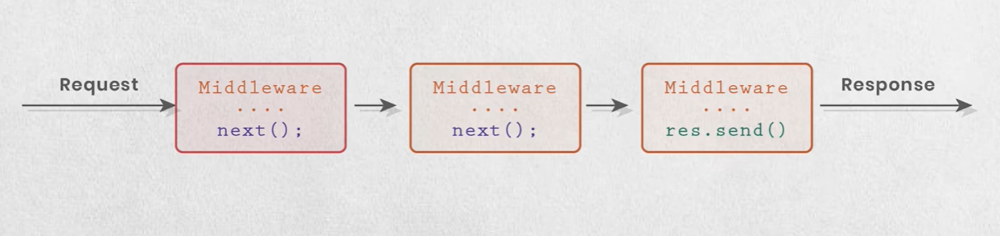
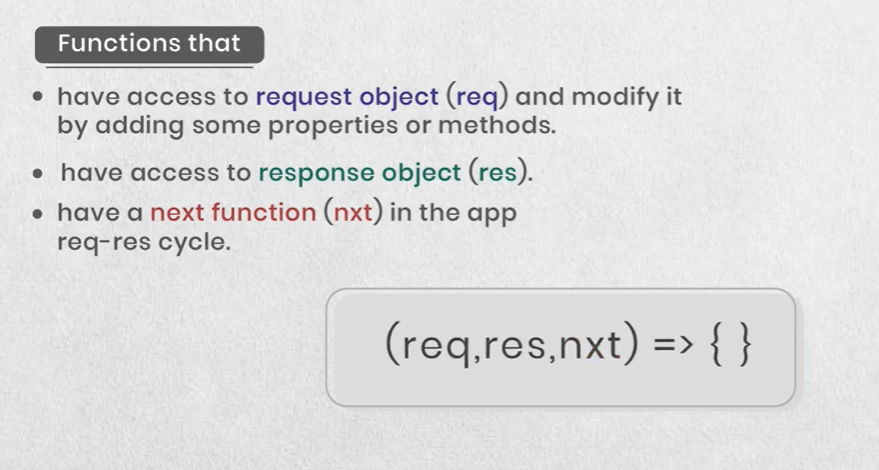

## Route Handler Middleware


### (شرح وصور وأمثلة) Express في Middleware أنواع الـ 
### 1. Middleware التصنيفات الأساسية للـ 
![Screenshot 2025-12-12 164643.png](<attachment:Screenshot 2025-12-12 164643.png>)

**شرح الصورة:**
- : Express في Middleware توضح الصورة الأنواع الرئيسية للـ 
  1. express.json و express.urlencoded و express.static مثل Express مدمجة مع **Built-in:**    
  2. (routes) دوال تُستخدم لمعالجة مسارات معينة **Route Handler:** 
  3. تكتبها بنفسك وتطبقها على مستوى التطبيق أو مسارات محددة **Custom/Application-level:** 
  4. morgan أو helmet مكتبات خارجية مثل **Third-party:** 
  5. لمعالجة الأخطاء في التطبيق **Error-handling:** 
  6. لمعالجة معلمات المسارات **Parameters:**
  
---
### 2. Built-in Middleware
![Screenshot 2025-12-12 164825.png](<attachment:Screenshot 2025-12-12 164825.png>)

**شرح الصورة:**
- : Express في Built-in Middleware تركز الصورة على الـ 

  - JSON لتحليل بيانات `express.json()`  .
  - (forms) لتحليل بيانات النماذج `express.urlencoded()`
  - CSS وJS لخدمة الملفات الثابتة مثل الصور وملفات `express.static()` 
   
- هذه الدوال مدمجة في Express ولا تحتاج لتثبيت مكتبات إضافية.

---
### 3. Route Handler Middleware
![Screenshot 2025-12-12 170629.png](<attachment:Screenshot 2025-12-12 170629.png>)

**شرح الصورة:**
- على نفس المسار Middleware يُستخدم لمعالجة الطلبات لمسارات معينة، ويمكن ربط أكثر من دالة 
- مثال عملي:
```js
app.get('/user', middleware1, middleware2, (req, res) => {
  res.send('تمت المعالجة!');
});
```
- كل دالة يمكنها تنفيذ منطق معين أو التحقق من البيانات قبل الوصول للدالة الأخيرة التي ترسل الاستجابة.

---
### 4. (سلسلة المعالجة) Express في Middleware تسلسل الـ 
على نفس المسار، بحيث يمر الطلب عبر كل دالة بالترتيب. كل دالة Middleware يمكن ربط أكثر من دالة Express في 
للانتقال للدالة التالية `next()` ويجب استدعاء (req, res, next) تستقبل middleware

```js
app.get("/",
  (req, res, next) => {
    // معالجة أولية للطلب
    next(); // التالي middleware الانتقال للـ 
    //  
  },
  (req, res, next) => {
    // معالجة إضافية
    next(); // التالي middleware الانتقال للـ
  },
  (req, res, next) => {
    // معالجة أخرى
    next(); // التالي middleware الانتقال للـ
  },
  (req, res) => {
    // هنا يتم إرسال الاستجابة النهائية
    res.send("تمت المعالجة!");
  }
);
```
- يمكنها تنفيذ منطق معين (مثل التحقق من المستخدم أو تسجيل الأحداث) middleware كل دالة 
- سيتوقف الطلب ولن يصل للدوال التالية أو الاستجابة النهائية `next()` إذا لم يتم استدعاء 
- `next()` الدالة الأخيرة عادة ترسل الاستجابة للعميل ولا تستدعي 

---
### 5. app.all شرح 
لمسار معين (GET, POST, PUT, DELETE, ...إلخ) أو منطق معين على جميع أنواع الطلبات Middleware تُستخدم لتطبيق `app.all` دالة 
     
```js
app.all("/example", (req, res, next) => {
  // /example هذا الكود يُنفذ مع أي نوع طلب على 
  next();
});
```
- مفيدة لوضع تحقق أو معالجة مشتركة لكل أنواع الطلبات على مسار معين.

---
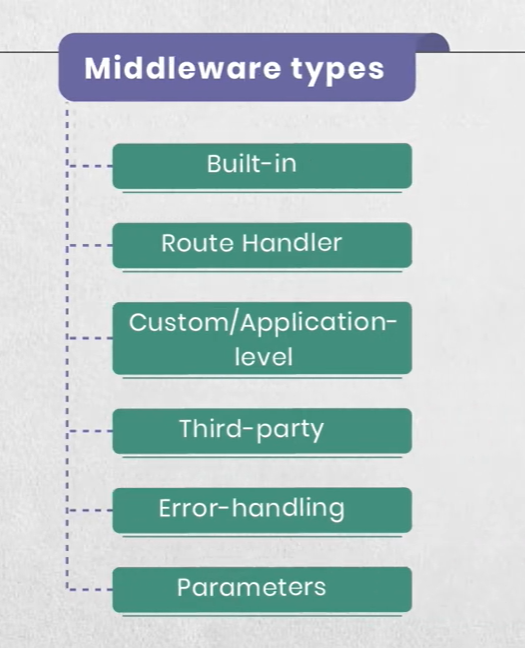
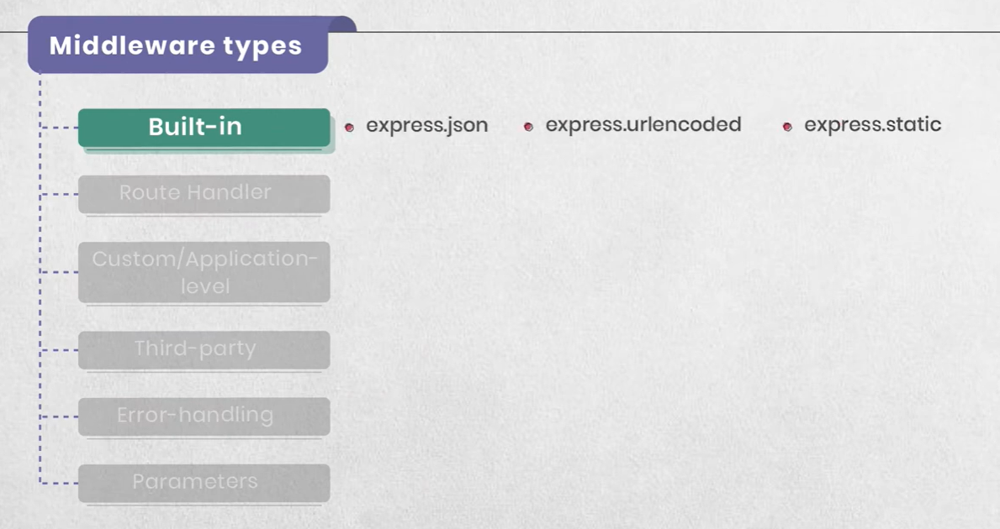
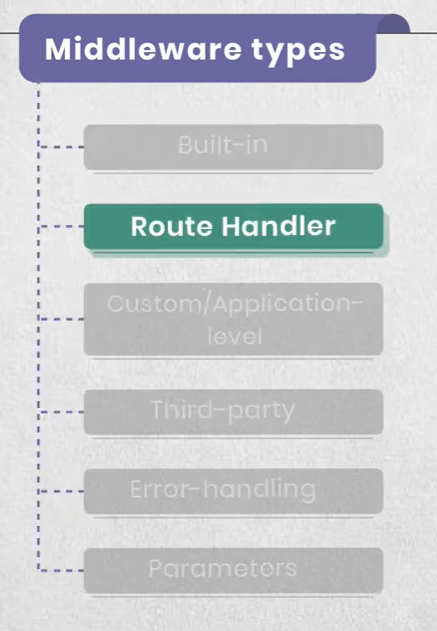

## Built-in Middleware - static()


### express.static شرح الصورة والملاحظات على 

- : جاهزة (مضمنة)، مثل middlewares يوجد عدة Express في 
  - القادمة من العميل JSON  لتحليل بيانات `express.json()`  
  - URL-encoded بصيغة (forms) لتحليل البيانات المرسلة من النماذج `express.urlencoded()` 
  - HTML, CSS, JS, الصور مثل (static files)هذا هو المهم هنا، ويُستخدم لتقديم الملفات الثابتة : **`express.static()`** 

- Express (HTML, CSS, JS, صور) يحتوي على ملفات الموقع الثابتة في المشاريع `public` أو غالبًا يسمى `static` الصورة التالية توضح أن مجلد 

:  لكل ملف route يستطيع تقديم هذه الملفات مباشرة للعميل بدون الحاجة لكتابة
         

![Screenshot 2025-12-12 202949.png](<attachment:Screenshot 2025-12-12 202949.png>)

- عند استخدام الكود التالي:
  ```js
  app.use('/assets', express.static('public'));
  ```
`/assets/index.html` أو `/assets/css/style.css` سيصبح متاحًا على الرابط (`public/index.html` أو `public/css/style.css` : مثلاً) `public` أي ملف تضعه داخل مجلد  

- هذا يسهل تنظيم ملفات المشروع ويجعل إضافة أو تعديل الملفات الثابتة أمرًا بسيطًا واحترافيًا.

---

### express.static كود عملي لتجربة 

. داخل مجلد المشروع `server_static_example.js` تم وضع كود السيرفر في ملف باسم 

لتشغيل الكود:
1. في مجلد المشروع (Terminal) افتح الطرفية 
2. نفذ الأمر:
   ```
   node server_static_example.js
   ```
   ثم جرب فتح:

http://localhost:3000/

http://localhost:3000/assets/css/style.css

http://localhost:3000/assets/js/app.js

3. ثم افتح المتصفح على الرابط:
   - `http://localhost:3000/assets/index.html`
   - أو أي ملف آخر داخل public بنفس الطريقة.
----
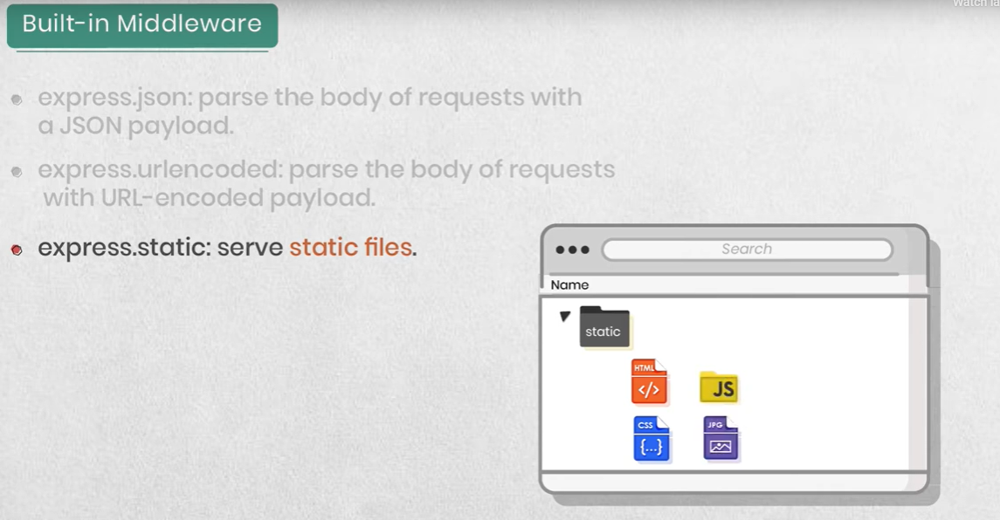

## Creating Custom Middleware


![Screenshot 2025-12-12 235438.png](<attachment:Screenshot 2025-12-12 235438.png>)

### Express في Middleware شرح الصورة 
  
- Express (دوال وسيطة) في  **middleware** الصورة تشرح فكرة الـ 
- وتستخدمها في كل الطلبات (Express وليست جاهزة من ) تعني أنك تكتب دوال بنفسك **Custom/Application-level middleware** 
- إلخ(authorization) التفويض (authentication) المصادقة (logging) لمعالجة أمور متكررة في كل الطلبات مثل: تسجيل الدخول  middleware تستخدم الـ 

- الكود في الصورة:
  ```js
  app.use((req, res, next) => {
    // منطق خاص (مثلاً تسجيل)
    next();
  });
  ```
في النهاية حتى لا يتوقف الطلب `next()` المخصص. يجب دائمًا استدعاء middleware  هذا هو شكل الـ 
- تعني "قضايا متقاطعة" أي منطق يتكرر في أكثر من مكان (زي التسجيل أو التحقق من المستخدم) **cross cutting concerns** 
- بالترتيب، وكل واحدة ممكن تعدل أو تراقب أو تمنع الطلب middleware كل طلب يمر على سلسلة الـ 
 

---

### middleware؟ ما هو 
- (req, res, next) تستقبل Express هو دالة في 
- تُستخدم لتنفيذ منطق معين (تسجيل، مصادقة، معالجة بيانات... إلخ) أثناء مرور الطلب.
- التالي أو للراوت النهائي middleware في النهاية لتمرير التحكم للـ `next()` يجب استدعاء 

### مثال عملي:
```js
function middlewarefun(req, res, next) {
    // منطق خاص (مثلاً تسجيل)
    next();
}
app.use(middlewarefun);

// أو مباشرة
app.use((req, res, next) => {
    console.log("loading...");
    next();
});
```

---

### : مهم جدًا middleware ترتيب 
-(CSS بما فيها طلبات الصور و ) سيتم تسجيل كل الطلبات static middleware، التسجيل قبل middleware إذا وضعت 
- لن يتم تسجيل طلبات الملفات الثابتة static middleware إذا وضعته بعد  

---

### خلاصة :
- دوال وسيطة لمعالجة الطلبات = middleware  
- ترتيبها في الكود يحدد ما الذي سيتم معالجته.
- حتى لا يتوقف الطلب في منتصف السلسلة `next()` دائمًا استدعي 

----

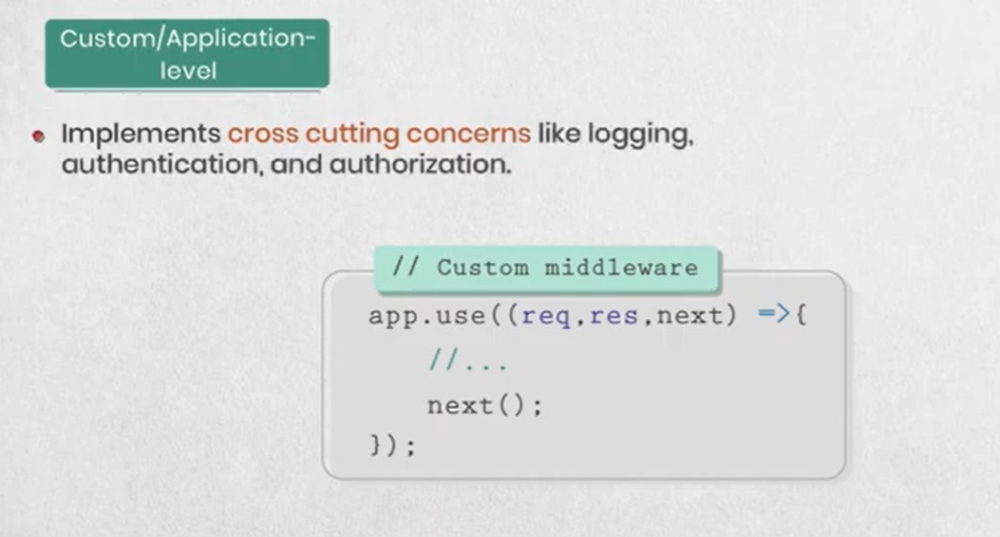

## Third-party Middleware Overview


![Screenshot 2025-12-13 161530.png](<attachment:Screenshot 2025-12-13 161530.png>)

### Express من طرف ثالث في Middleware  

- جاهز (من طرف ثالث) يغطي احتياجك middleware بنفسك، من الأفضل تبحث إذا كان فيه middleware قبل ما تكتب 
- (Resources > Middleware قسم ) الرسمي Express الجاهزة على موقع middleware تقدر تلاقي قائمة ضخمة من 
- وتوفر وظائف مثل الأمان، تحليل الكوكيز، إدارة الجلسات، إلخ Express، غالبًا مجربة ومدعومة من المجتمع أو فريق middleware هذه الـ 


### أمثلة على أشهر middleware من طرف ثالث:
- مهمة HTTP يحسن أمان التطبيق بإضافة رؤوس : **helmet** 
- يحلل الكوكيز المرسلة مع الطلبات : **cookie-parser**

### من طرف ثالث؟ middleware كيف تستخدم 
1.npm تثبتها أولاً عبر :
   ```bash
   npm install helmet cookie-parser
   ```
2. تستدعيها في كودك:
   ```js
   const helmet = require('helmet');
   const cookieParser = require('cookie-parser');

   app.use(helmet());
   app.use(cookieParser());
   ```

- **ملاحظة مهمة:**
  - تضيفها تؤثر على أداء التطبيق middleware إلا لو فعلاً تحتاجها، لأن كل middleware لا تكثر من استخدام 
  - قبل استخدامها middleware اقرأ التوثيق جيدًا لكل 

**خلاصة:**
- جاهز قبل ما تكتب واحد بنفسك middleware ابحث دائمًا عن 
- استخدم فقط ما تحتاجه فعلاً لتبقي تطبيقك سريع وآمن.

----
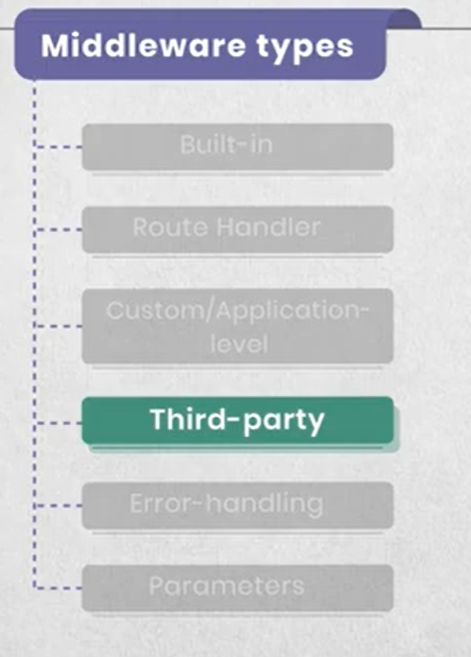

## Creating and Encoding Cookies


![Screenshot 2025-12-13 165501.png](<attachment:Screenshot 2025-12-13 165501.png>)

### Express إدارة الكوكيز في 

- أي أن الخادم لا يتذكر المستخدم بين الطلبات (stateless) هو بروتوكول بلا حالة HTTP بروتوكول 
- تُستخدم لجعل الخادم يتعرف على المستخدم في الطلبات المستقبلية، مثل تذكر تسجيل الدخول أو تفضيلات المستخدم (Cookies) الكوكيز 

- الصورة توضح كيف يرسل الخادم كوكيز للعميل بعد تسجيل الدخول أو إرسال نموذج، ويعيد المتصفح الكوكيز مع كل طلب لاحق.

- `res.cookie` من العميل، يمكن للخادم تعيين كوكيز للعميل باستخدام دالة (form) عند إرسال نموذج 
- إذا أردت أن تبقى الكوكيز بعد انتهاء الجلسة (`expires`)يمكنك تحديد اسم الكوكيز وقيمتها، ويمكنك أيضًا تحديد تاريخ انتهاء الصلاحية 
- لجعلها غير قابلة للقراءة المباشرة، مما يعزز الأمان `Buffer.from().toString('base64') يمكن تشفير بيانات الكوكيز مثلاً باستخدام 
- `document.cookie` في المتصفح، يمكنك التحقق من الكوكيز باستخدام 

### مثال عملي مع شرح كل جزء:

```js
// (POST) استقبال بيانات النموذج من العميل 
app.post("/welecome.html", (req, res) => { 
    // 1. طباعة بيانات النموذج في الطرفية (للمراجعة أو التصحيح)
    console.log(req.body);
    
    // 2. لحماية الاسم (Base64) القيمة مشفرة "username" تعيين كوكيز باسم 
    res.cookie("username", Buffer.from(req.body.fnm).toString('base64'));
    
    // 3. بقيمة ثابتة (مثلاً 25) "userage" تعيين كوكيز باسم 
    res.cookie("userage", 25);
    
    // 4. إرسال رسالة شكر للعميل بعد استلام البيانات وتعيين الكوكيز
    res.send(`thanks ${req.body.fnm} ${req.body.lnm} for submitting`);
});
```

#### شرح كل جزء:
- HTML من نموذج POST تعريف مسار يستقبل بيانات ` app.post("/welecome.html", ...)` 
- يعرض بيانات النموذج في الطرفية (مفيد للتصحيح) : `console.log(req.body);` 
- `res.cookie("username", Buffer.from(req.body.fnm).toString('base64'));` :
    -  username ينشئ كوكيز باسم 
    -  Base64 القيمة هي اسم المستخدم بعد تشفيره بـ 
- بقيمة 25 (مثال على تعيين قيمة ثابتة) userage ينشئ كوكيز باسم : `res.cookie("userage", 25);`  
- يرسل رسالة للعميل تؤكد استلام البيانات وتعيين الكوكيز `res.send(...)`

> **ملاحظة:**
> - ( `res.cookies` وليس) `res.cookie` استخدم دائمًا 
> - `{ expires: ... }` يمكنك إضافة خيارات مثل مدة الصلاحية عبر


**ملخص:**
- الكوكيز تجعل الخادم يتعرف على المستخدم بين الطلبات.
- لتعيين الكوكيز، ويمكنك تشفير القيمة لمزيد من الأمان `res.cookie` استخدم 
- `document.cookie` تحقق من الكوكيز في المتصفح عبر 

----
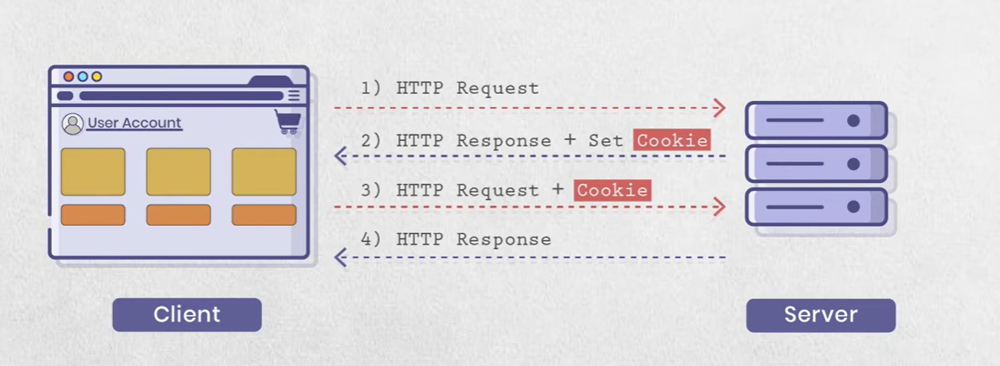

## Setting HTTPOnly Property


![Screenshot 2025-12-13 202325.png](<attachment:Screenshot 2025-12-13 202325.png>)

### Express تشفير الكوكيز في 

-  فك التشفير للبيانات**Decoding** , (تشفير/ترميز) **Encoding** الصورة توضح عمليتي 
- لجعلها غير قابلة للقراءة المباشرة (Base64 مثلاً باستخدام ) عند إرسال الكوكيز من الخادم للعميل، يمكن تشفير القيمة 
- يمكنه فكها (Base64 مثل) التشفير هنا ليس أمانًا حقيقيًا، بل فقط إخفاء للبيانات. أي شخص يعرف الخوارزمية **ملاحظة مهمة:** 
- عند إنشاء الكوكي `HttpOnly` استخدم خاصية (document.cookie) لجعل الكوكيز غير متاحة لجافاسكريبت في المتصفح 
- لتحديد مدة الصلاحية بالمللي ثانية `maxAge` لجعل الكوكي دائمة، أو `expires` يمكنك أيضًا تعيين معلمات مثل 
- وتُحذف عند إغلاق المتصفح (Session Cookie) تعتبر كوكيز جلسة `expires` أو `maxAge` الكوكيز التي لا تحتوي على 

### مثال عملي مع شرح الخيارات:
```js
app.post("/welecome.html", (req, res) => { 
    // طباعة بيانات النموذج
    console.log(req.body);

    // (Base64) تعيين كوكيز مشفرة 
    res.cookie("username", Buffer.from(req.body.fnm).toString('base64'));

    // تعيين كوكيز مع خيارات مختلفة:
    res.cookie("userage", 25, { expires: new Date(Date.now() + 86400000) }); // يوم واحد
    res.cookie("userage", 25, { maxAge: 3600000 }); // ساعة واحدة
    res.cookie("userage", 25, { httpOnly: true }); // document.cookieغير متاحة لـ 

    //  (Application > Cookies) ويمكن رؤيتها في أدوات المطور HTTP الكوكيز تُرسل في رأس 
    res.send(`thanks ${req.body.fnm} ${req.body.lnm} for submitting`);
});
```

#### شرح الخيارات:
- (Date تُكتب ككائن ) تاريخ انتهاء الكوكيز `expires` 
- مدة الصلاحية بالمللي ثانية (مثلاً 3600000 = ساعة) `maxAge`
- الكوكي غير متاحة لجافاسكريبت في المتصفح (أكثر أمانًا) true، إذا كانت `httpOnly` 

**ملخص:**
- تشفير الكوكيز يخفي القيمة فقط، لكنه ليس أمانًا حقيقيًا.
- لحماية الكوكيز من جافاسكريبت الضار `httpOnly` استخدم  
- كوكيز الجلسة تُحذف عند إغلاق المتصفح إذا لم تحدد مدة صلاحية.

----
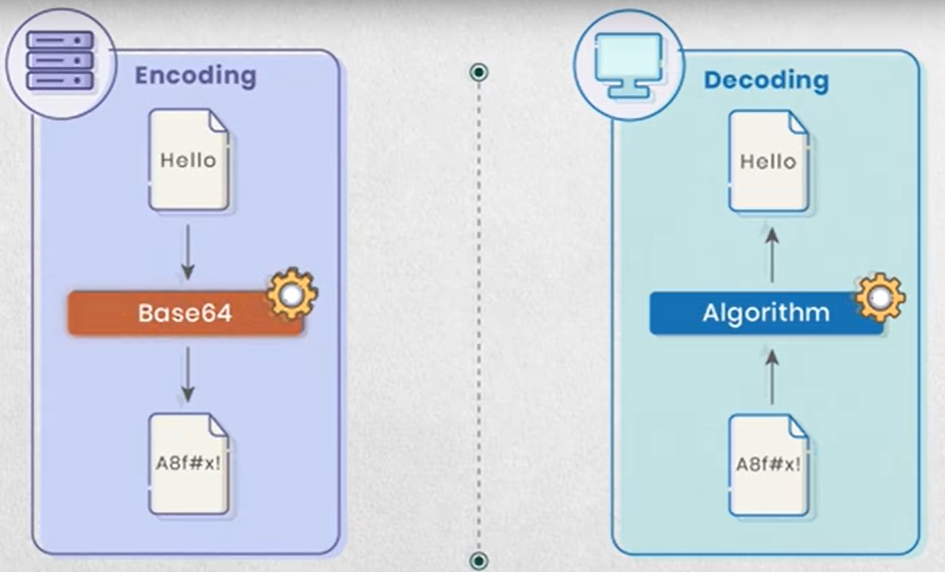

## Third-party Middleware Example: cookie-parser

### Express شرح عملي خطوة بخطوة: إنشاء واسترجاع الكوكيز في 

1. **cookie-parser تثبيت واستخدام**
   - يقدر يقرأ الكوكيز اللي جايه من العميل بسهولة Express بتخلي cookie-parser مكتبة  
   - لازم تثبتها بالأمر:
     ```bash
     npm install cookie-parser
     ```
   - وتضيفها في الكود:
     ```js
     const cookieParser = require('cookie-parser');
     app.use(cookieParser());
     ```

2. **تعيين الكوكيز عند استقبال بيانات من نموذج**
   - : وكمان بيحفظ العمر في كوكيز ثانية (Base64 ومشفرها بـ) السيرفر بيحفظ اسم المستخدم في كوكيز (POST) لما العميل يبعت بيانات 
     ```js
     app.post("/welecome.html", (req, res) => { 
         // يطبع بيانات النموذج في الطرفية
         console.log(req.body);
         // يحفظ الاسم مشفر في كوكيز
         res.cookie("username", Buffer.from(req.body.fnm).toString('base64'));
         // httpOnly يحفظ العمر في كوكيز مع أمان 
         res.cookie("userage", 25, { httpOnly: true }); 
         res.send(`thanks ${req.body.fnm} ${req.body.lnm} for submitting`);
     });
     ```
   - في المتصفح (أمان أعلى) document.cookie معناها الكوكيز دي مش هتظهر في httpOnly **ملاحظة:** 

3. **استرجاع الكوكيز في طلب جديد**
   - : السيرفر يقرأ الكوكيز ويفك تشفير الاسم `/abc` لما العميل يطلب 
     ```js
     app.get("/abc", (req, res) => {
         // Base64 يفك تشفير الاسم من 
         const username = Buffer.from(req.cookies.username, 'base64').toString();
         console.log('username:', username);
         // يطبع العمر
         console.log('userage:', req.cookies.userage);
         res.sendStatus(200);    
     });
     ```

---

### ملاحظات مهمة:
- req.cookies عشان تقدر توصل للكوكيز من cookie-parser لازم تستخدم 
- لازم تفك تشفيرها بنفس الطريقة (Base64 زي) لو خزنت بيانات مشفرة 
- تحمي الكوكيز من جافاسكريبت الضار في المتصفح httpOnly خاصية  
- للرد السريع بدون محتوى res.sendStatus(200) استخدم ط

-----

## Third-party Middleware Example: helmet


### Helmet باستخدام Express  تعزيز أمان تطبيقات 
  

- يُستخدم لتعزيز أمان تطبيقات الويب  Express شهير في Middleware هو **Helmet** 
- وغيرهاXSSوClickjackingتلقائيًا إلى كل الاستجابات، وهذه الرؤوس تساعد في حماية التطبيق من هجمات شائعة مثل HTTP(HTTP Headers)بإضافةHelmetيقوم 

- Helmet لتثبيت :
  ```bash
  npm install helmet
  ```
- لإضافته إلى مشروعك:
  ```js
  const helmet = require('helmet');
  app.use(helmet());
  ```
- ستلاحظ ظهور رؤوس أمان جديدة في كل استجابة من السيرفر Helmet بمجرد إضافة 
  ( Response Headers < Network < يمكنك رؤيتها في أدوات المطور في المتصفح ).
- في الكود Helmet ستستفيد من هذه الحماية بمجرد تفعيل (Helmet قبل إضافة ) حتى الطلبات القديمة 


**ملخص:**
- خيار بسيط وفعال لرفع مستوى أمان تطبيقك بدون مجهود كبير Helmet 
- Express يُنصح دائمًا باستخدامه في أي مشروع 

---


## Parameter Middleware


![Screenshot 2025-12-13 232130.png](<attachment:Screenshot 2025-12-13 232130.png>)

### app.param باستخدام Express في ID التعامل مع معلمات 

- المستخدم أو الطالب ID في المسار، مثل (parameter) أحيانًا تحتاج تتحقق من صحة معلمة 
- route وتتحقق منها مرة واحدة بدل ما تكرر الكود في كل (id : مثلاً) خاص لأي معلمة Middleware تقدر من خلالها تكتب `app.param` يوفر لك دالة اسمها Express 
       

### مثال عملي:
```js
// مصفوفة الطلاب كمثال
const Students = [
  { id: 1, name: 'Ali' },
  { id: 2, name: 'Sara' },
  { id: 3, name: 'Mona' }
];

// Middleware للتحقق من صحة الـ ID
app.param('id', (req, res, next, id) => {
  // تأكد أن id رقم صحيح
  const numId = Number(id);
  if (isNaN(numId)) {
    return res.status(400).send('Invalid ID');
  }
  req.ID = numId; // خزنه في الطلب لسهولة الوصول
  next();
});

// Route يستخدم الـ ID بعد التحقق
app.get('/students/:id', (req, res) => {
  const student = Students.find(s => s.id === req.ID);
  if (student) {
    res.json(student);
  } else {
    res.status(404).send('Student not found');
  }
});
```

### شرح الخطوات:
- middleware سيمر أولاً على هذا id أي مسار فيه : `app.param('id', ...)`  
- رقم، ولو غير ذلك يرجع خطأ مباشرة id يتم التحقق أن الـ 
- بعد ذلك route لسهولة استخدامه في أي req.ID بعد تحويله لرقم في idيتم تخزين الـ 
- مباشرة بدون الحاجة لإعادة التحقق req.ID نستخدم `/students/:id` في الراوت 
 
**ملخص:**
- للتحقق من معلمات المسار مرة واحدة app.param استخدم 
- route يسهل عليك كتابة كود نظيف ويمنع تكرار التحقق في كل .

----
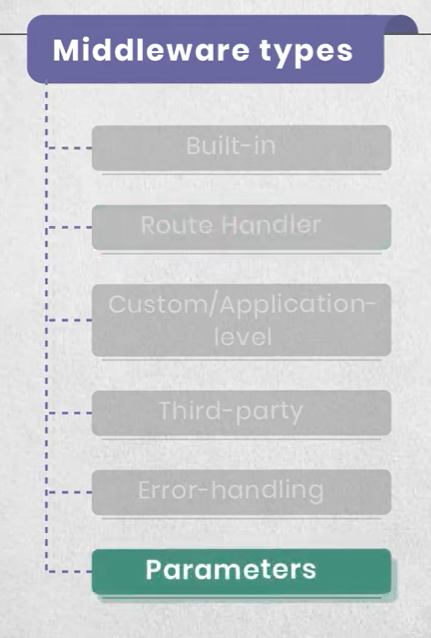

## Templating Engines


![Screenshot 2025-12-14 141220.png](<attachment:Screenshot 2025-12-14 141220.png>)


### ولماذا نستخدمه؟ (Template Engine) ما هو محرك القوالب 

- ديناميكية HTML محرك القوالب (أو محرك الرندر) هو أداة تساعدك في بناء صفحات 
- ويتم ملؤها بالبيانات أثناء وقت التشغيل بناءً على طلب العميل (placeholders) فيه أماكن فارغة (template) الفكرة: تكتب قالب 
- هذا مهم لأنك لا تعرف مسبقًا ما هي البيانات التي سيطلبها العميل، لذلك تحتاج صفحة تتغير حسب كل طلب.
- بعض أجزاء الصفحة تظل ثابتة (مثل الهيدر والفوتر)، وأجزاء أخرى تتغير (مثل اسم المستخدم أو قائمة المنتجات).
- كاملة للعميل HTML عند استلام الطلب من العميل، الخادم يحدد البيانات المطلوبة ويملأ الأماكن الفارغة في القالب ويرسل صفحة 

![Screenshot 2025-12-14 141735.png](<attachment:Screenshot 2025-12-14 141735.png>)

### أمثلة لمحركات القوالب:
- **EJS** (سنستخدمه في مشروعنا)
- **Pug**
- **Mustache**

- كل محرك له طريقة كتابة وصياغة مختلفة، لكن الفكرة واحدة: تكتب قالب بمتغيرات، والمحرك يملأها بالبيانات عند الرندر.
- (.ejs أو .pug : مثلاً) امتداد الملفات يختلف حسب المحرك 

**ملخص:**
- محرك القوالب يسمح لك بإنشاء صفحات ديناميكية تجمع بين أجزاء ثابتة وأجزاء متغيرة حسب البيانات.
- هذا يجعل تجربة المستخدم أفضل ويجعل الكود أكثر تنظيمًا ومرونة.

![Screenshot 2025-12-14 141220.png](<attachment:Screenshot 2025-12-14 141220.png>)

### شرح الصورة:
- في تطبيقات الويب (Template Engine) الصورة توضح فكرة محرك القوالب 
- (placeholders مثل متغيرات أو ) فيه أماكن فارغة (template) في الجهة اليسرى: يوجد قالب 
- عند استقبال طلب من العميل، الخادم يجمع البيانات المطلوبة (مثلاً اسم المستخدم أو قائمة منتجات).
- محرك القوالب يقوم بدمج القالب مع البيانات، فيملأ الأماكن الفارغة بالقيم الحقيقية.
- ديناميكية تجمع بين أجزاء ثابتة (مثل الهيدر والفوتر) وأجزاء متغيرة حسب كل طلب  HTML النتيجة: صفحة 
- هذه العملية تجعل كل مستخدم يرى صفحة مخصصة له حسب بياناته أو طلبه.

**الخلاصة:**
- جديد لكل حالة HTML محرك القوالب يوفر طريقة ذكية لبناء صفحات ديناميكية بدون الحاجة لكتابة 
- (Template Engine) محرك القوالب يجعل الكود أكثر تنظيمًا ومرونة في التعامل مع البيانات.

----
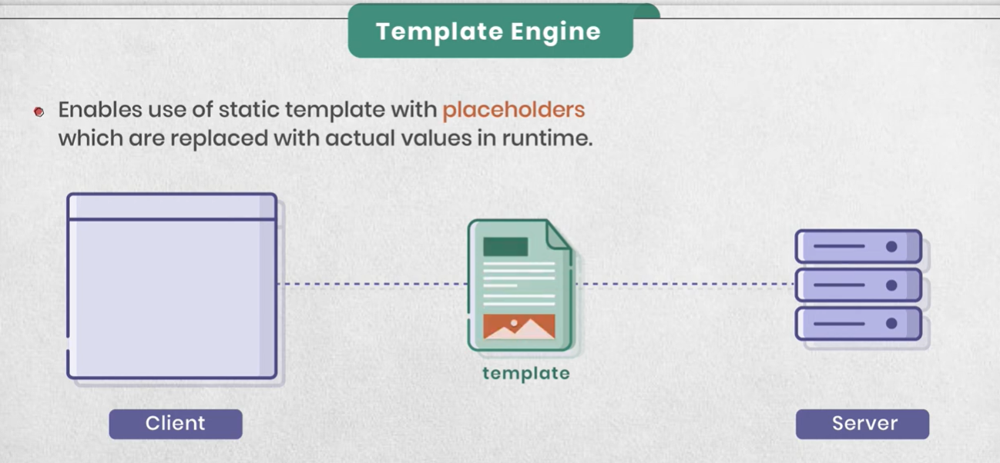
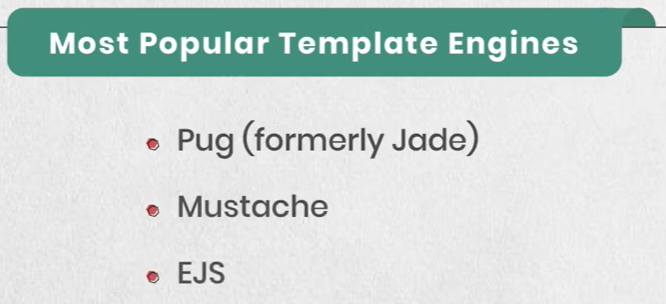

## Using EJS in Your Express App 

### وملفات ثابتة Express مع EJS  مثال عملي كامل: مشروع 

 EJS تم تجهيز جميع الملفات المطلوبة لتشغيل مثال السيرفر مع :

- صفحة عرض الطلاب مع فورم إضافة طالب جديد : **views/students.ejs** 
- أجزاء مشتركة للهيدر والفوتر : **views/header.ejs** و **views/footer.ejs** 
- احترافية CSS تنسيقات  : **public/assets/css/style.css**

 **server_ejs_example.js** يمكنك الآن تشغيل السيرفر باستخدام الملف

#### خطوات التشغيل:
1. شغل js من داخل مجلد :
 ```bash
   npm install express ejs helmet cookie-parser ajv
   node server_ejs_example.js
   ```
2. [http://localhost:3000](http://localhost:3000) : افتح المتصفح على 

#### ماذا ستتعلم من هذا المثال؟
- وتعرض بيانات ديناميكية EJS مع Express كيف تربط 
- views من مجلد (CSS/صور) كيف تستخدم ملفات ثابتة 
- مثل الهيدر والفوتر (partials) كيف تنظم الكود وتستخدم أجزاء مشتركة 
- للتحقق من صحة البيانات helmet و cookie-parser و AJV كيف تضيف ميدل وير حديثة مثل ط

----

# CH07 - Structuring Express Applications

## Introduction

### كيف ننظم تطبيق الكلية مع توسع المشروع؟
عندما يبدأ مشروعنا في النمو، يصبح من غير العملي أن تظل جميع الأكواد في ملف واحد. مع زيادة عدد الوظائف والبيانات، يصبح التنظيم ضرورة حتى يسهل علينا التطوير والصيانة لاحقًا.

---
### لماذا نحتاج لتنظيم المشروع؟ئ
- كلما زاد حجم التطبيق، زادت الحاجة لتقسيمه إلى أجزاء واضحة.
- منفصلة (endpoint) خاص به، بحيث يكون لكل مجموعة بيانات نقطة نهاية API كل جزء (مثل الطلاب، المعلمين، الكورسات، الأقسام) يحتاج 
   
### مثال توضيحي:

![Screenshot 2025-12-15 002832.png](<attachment:Screenshot 2025-12-15 002832.png>)

(GET, POST, PUT, DELETE) يدعم العمليات الأساسية API خاص به، وكل API في الصورة نلاحظ أن كل كيان في الكلية (طلاب، معلمين، كورسات، أقسام) له 

---
### كيف ننظم ملفات المشروع؟
- API لا يجب أن تظل كل الأكواد في ملف واحد لكل 
- (controllers, models, middlewares) فولدر خاص به، يحتوي على الملفات المرتبطة به API من الأفضل أن يكون لكل 

### مثال على هيكل المجلدات:

![Screenshot 2025-12-15 002943.png](<attachment:Screenshot 2025-12-15 002943.png>)

الصورة توضح كيف يمكن تقسيم المشروع إلى مجلدات منفصلة لكل جزء، مما يسهل إدارة الكود وتطويره.

---
### ولماذا نستخدمه؟ MVC ما هو نمط 

- هو أسلوب شائع لتنظيم المشاريع الكبيرة Model-View-Controller (MVC) نمط 
- (Controller) ومنطق التحكم (View) منطق العرض (Model) يساعدنا في فصل منطق البيانات 
- هذا الفصل يجعل الكود أكثر وضوحًا وأسهل في التعديل أو الإضافة لاحقًا.

### MVC رسم توضيحي لفكرة :

![Screenshot 2025-12-15 003014.png](<attachment:Screenshot 2025-12-15 003014.png>)

- مسؤول عن البيانات والتعامل مع قواعد البيانات  **Model:**
- مسؤول عن شكل البيانات المعروضة للمستخدم (لو في واجهة) **View:** 
- مسؤول عن منطق التطبيق وربط كل شيء ببعضه **Controller:**

---
> يجعل التطبيق أكثر قوة وسهولة في التطوير والصيانة MVC باختصار: التنظيم الجيد للمشروع باستخدام هيكل مجلدات واضح ونمط 

----
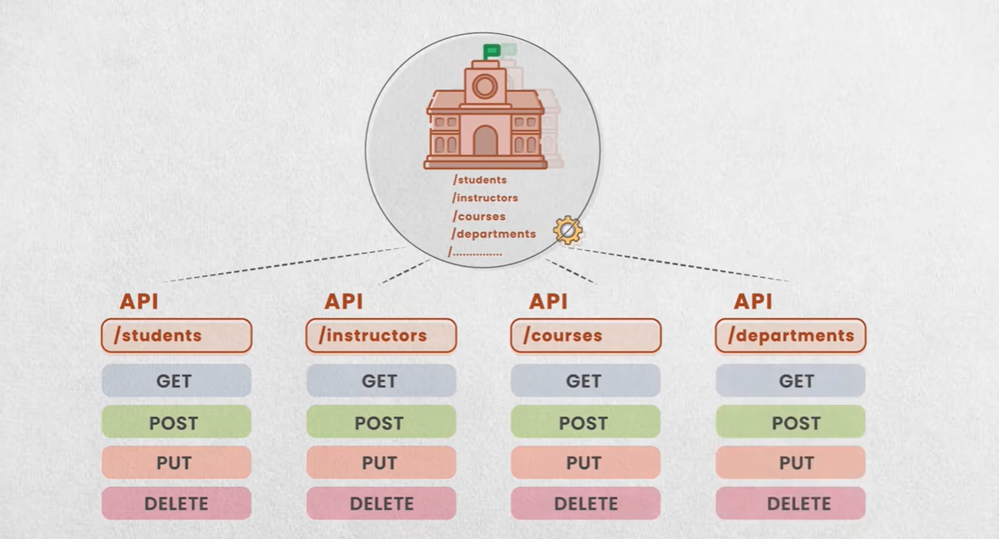
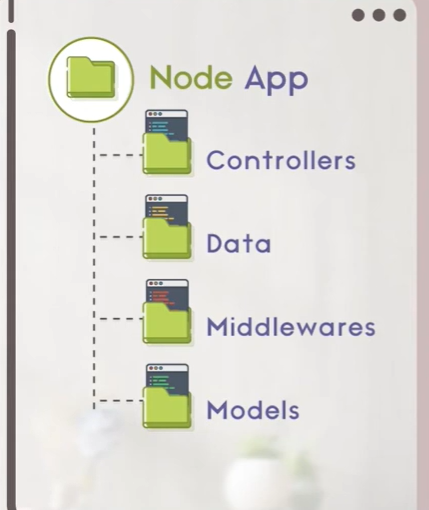
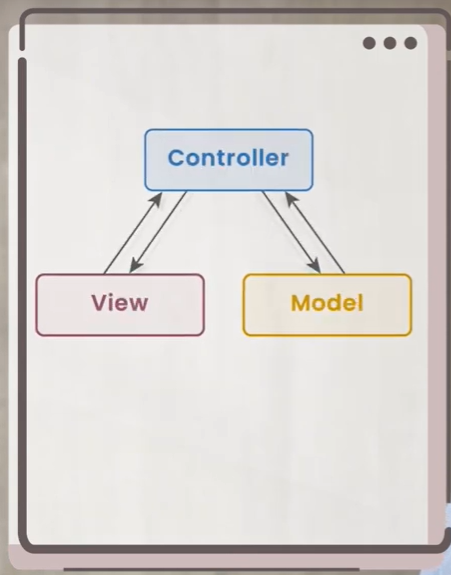

## Structuring Express Applications (routes)


### routes باستخدام مجلد Express شرح تنظيم مشروع 

والمنطق الخاص به (Routes) ملف خاص به يحتوي كل المسارات (students, courses, teachers ...) بحيث يكون لكل نموذج "routes" كيف ننظم مشروعنا باستخدام 
  
### خطوات التنظيم:
1. **routes إنشاء مجلد**
   - `Students.js` و`Courses.js`  وضعنا فيه ملفات لكل نموذج: مثل 
2. **route كل ملف**
   - `express.Router()` باستخدام `router` وثابت `express` عرفنا فيه ثابت 
   - الخاصة بالنموذج داخل هذا الملف (GET, POST, ...) كتبنا جميع المسارات 
   - فقط `router` في نهاية الملف نصدر 
    
3. **الرئيسي app.js ملف**
   - (`Students.js`, `Courses.js` ...) routes  استوردنا جميع المسارات من ملفات 
   - (`/api/students`) على المسار المناسب مثلاً router لتسجيل كل `app.use()` استخدمنا 
   - وملفات ثابتة (middleware) أضفنا إعدادات الميدلوير 

---

### شرح ما تم في الملفات الثلاثة:

- **Students.js**
  - يحتوي بيانات الطلاب مؤقتًا (يمكن ربطه بقاعدة بيانات لاحقًا).
  - Ajv فيه تحقق من صحة البيانات باستخدام مكتبة .
  - فيه مسارين:
    - لإرجاع كل الطلاب `GET /api/students` .
    - لإضافة طالب جديد بعد التحقق من صحة البيانات `POST /api/students`.
  - فقط `router` في النهاية نصدر 
  
- **Courses.js**
  - نفس فكرة الطلاب لكن للكورسات.
  - فيه بيانات مؤقتة للكورسات ومسارين:
    - لإرجاع كل الكورسات `GET /api/courses` .
    - لإضافة كورس جديد مع تحقق بسيط `POST /api/courses`.
  - فقط `router` في النهاية نصدر 
- **app.js**
  - هو الملف الرئيسي للسيرفر.
  - routes استوردنا فيه جميع المسارات من ملفات 
  - على المسار المناسب router سجلنا كل 
  - (middleware, static files) الأساسية Express أضفنا إعدادات 
    
---

### لماذا هذا التنظيم مهم؟
- كل منطق خاص بنموذج معين يكون في ملفه، مما يسهل التطوير والصيانة.
- بسهولة بنفس الطريقة (teachers مثل) يمكن إضافة أي نموذج جديد 
- يسهل اختبار كل جزء من المشروع بشكل منفصل.

> **ملخص:**
> - router له ملفه الخاص ويصدر Route كل  
> - ويسجله router الرئيسي يستورد كل app.js ملف  
> - المناسب route كل منطق التحقق ومعالجة البيانات يكون داخل ملف 
 
هذا التنظيم يجعل مشروعك احترافي وسهل التوسعة والصيانة.

----

## Structuring Express Applications (middlewares)


### مخصصة middlewares مع استخدام Express تنظيم مشروع 


### خطوات التنفيذ:
1. مخصص لتسجيل الطلبات middleware لتعريف logging.js ووضعنا فيه ملف middlewares أنشأنا مجلد 

2. app.js في:
   - middlewares/logging.js من middleware استوردنا 
   - app.use(loggingMiddleware) استخدمناه في التطبيق باستخدام.
   - وسجلناها routes استوردنا جميع المسارات من مجلد 

3. routes موجود في ملفه داخل (students, courses, ...) كل منطق خاص بنموذج معين 
  
---

### أهمية هذا التنظيم:
- مخصصة أو عامة في أي وقت middlewares يسهل إضافة 
- يجعل الكود منظم وسهل الصيانة.
- في مكان واضح (routes, middlewares, إعدادات السيرفر) كل جزء من المشروع 

> **نصيحة:**
> مباشرة app.js وصدّره واستخدمه في middlewares جديد (مثلاً للتحقق من الصلاحيات)،أنشئ ملف جديد في middleware إذا أردت إضافة---

---

## Structuring Express Applications (util)


### (StudentsValidator) فصل منطق التحقق في ملف مستقل 

StudentsValidator.js باسم util إلى ملف مستقل داخل مجلد students.js من ملف (schema و ajv و compile) لتنظيم الكود بشكل أفضل، تم نقل منطق التحقق من صحة بيانات الطلاب 
      .

### خطوات التنفيذ:
- : وكتبنا فيه util/StudentsValidator.js أنشأنا ملف 
  - الخاص بالطالب (schema) تعريف مخطط التحقق 
  - ajv.compile باستخدام (validator) وتجهيز المدقق ajv إنشاء كائن 
  - (`module.exports = ajv.compile(schema);`) تصدير المدقق مباشرة
- students.js في ملف:
  - schema و ajv حذفنا كل ما يخص 
  - فقط util/StudentsValidator.js استوردنا المدقق الجاهز من 
  - لإضافة طالب جديد POST استخدمنا المدقق في مسار 

---

### لماذا هذا أفضل؟
- وملف التحقق مستقل (Routes) أصبح مسؤول فقط عن المسارات students.js فصل المهام: ملف 
- util سهولة التطوير: لو أردت تعديل التحقق أو إعادة استخدامه في مكان آخر، ستجده في 
- الكود أصبح أنظف وأسهل في الصيانة.

> **مثال عملي:**
> إذا كانت البيانات صحيحة، يتم إضافة الطالب، وإذا كان هناك خطأ يتم إرجاع رسالة توضح الخطأ  util عند إرسال بيانات طالب جديد، يتم تمريرها للمدقق المستورد من 

---

## Introducing MVC Pattern


### MVC (Model-View-Controller) مقدمة عن نمط 

#### MVC الصورة الأولى: شرح عام لنمط 

![Screenshot 2025-12-16 001111.png](<attachment:Screenshot 2025-12-16 001111.png>)

- مسؤول عن التعامل مع البيانات (ملفات أو قاعدة بيانات) والمنطق الخاص بها : **Model** 
- مسؤول عن ما يراه المستخدم (واجهة المستخدم أو القالب) : **View** 
- يستقبل الطلبات من المستخدم، يعالجها، ويتعامل مع البيانات ثم يرسل النتيجة للعرض Viewو الـ Modelحلقة الوصل بين الـ **Controller:**
- الأسهم توضح تدفق البيانات بين الأجزاء الثلاثة، وكيف أن كل جزء له مسؤولية محددة.

---

### مع المسارات والميدل وير MVC شرح عملي لتدفق الطلب في نمط 

#### (Middleware) والميدل وير (Routes) الصورة الثانية: إدخال المسارات 
  

![Screenshot 2025-12-16 001219.png](<attachment:Screenshot 2025-12-16 001219.png>)

- سيعالج الطلب (Controller) هي نقطة البداية لأي طلب، تحدد أي متحكم : **Routes**
- طبقات وسيطة تمر عليها الطلبات قبل الوصول للمتَحكم، مثل التحقق أو التسجيل أو أي معالجة إضافية : **Middleware**
- Modelيستقبل الطلب من المسار بعد مروره بالميدل وير، ويتعامل مع الـ : **Controller**  
- يتعامل مع البيانات (قراءة/كتابة) : **Model**
- يعرض النتيجة للمستخدم : **View** 

#### ملخص دورة حياة الطلب:
1. المستخدم يرسل طلب (مثلاً: إضافة طالب).
2. (Route) الطلب يمر أولاً على المسار
3. لأي معالجة إضافية (Middleware) يمر عبر الميدل ويرز 
4. الذي ينفذ المنطق المطلوب (Controller) يصل للمتَحكم 
5. لجلب أو تعديل البيانات (Model) المتحكم يتعامل مع النموذج 
6. ليشاهدها المستخدم (View) النتيجة ترجع للعرض 

---

#### مثال عملي على تدفق الطلب:
1. المستخدم يرسل طلب إضافة طالب جديد.
2. `/students` Route الطلب يذهب إلى 
3. (مثلاً: يتحقق أن البيانات صحيحة) Middleware يمر على 
4. الخاص بالطلاب Controllerيصل للـ 
5. (قاعدة البيانات) Model المتحكم يضيف الطالب في 
6. يرجع رد للمستخدم (نجاح أو خطأ).

---

#### ملخص:
- المستخدم→ route → middleware → route → controller → model → (يرجع للخلف) → controller → view/response →  الطلب يبدأ من المستخدم .
- كل سهم في الصورة يوضح اتجاه تدفق البيانات أو الطلب.
- هذا التنظيم يجعل الكود واضح، وكل جزء مسؤول عن مهمة محددة، ويسهل التوسعة والصيانة.

-----
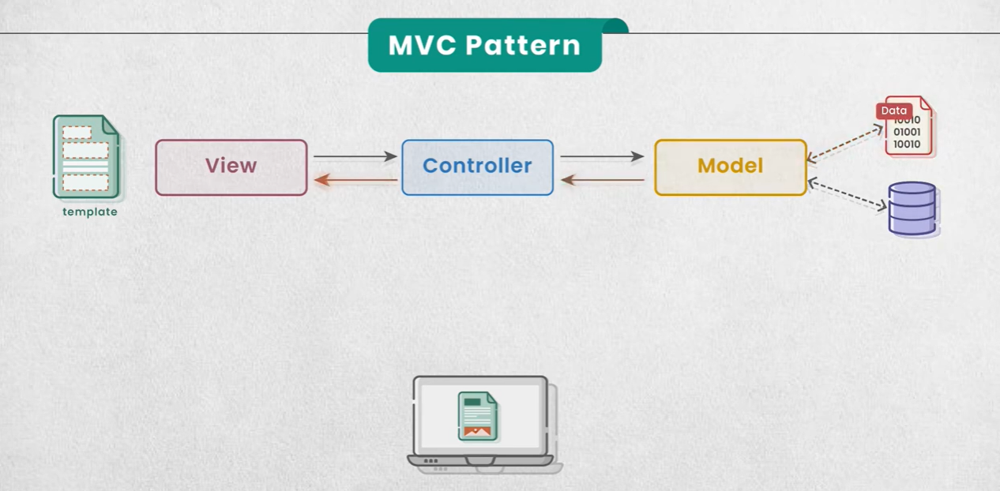
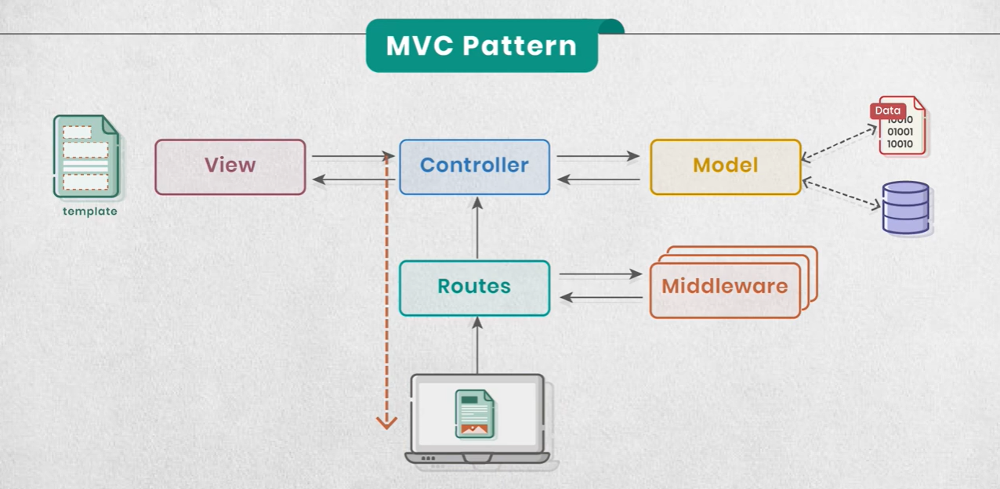

## Creating Controllers


### ولماذا نستخدمها؟ (Controller) ما هي وحدة التحكم 
 
مستقلة Controllers في ملفات (Routes) هي المسؤولة عن تنفيذ منطق التطبيق عند استقبال الطلبات. في تنظيم المشاريع الحديثة، يتم فصل كل منطق المسارات (Controller) وحدة التحكم 


### : للطلاب Controller خطوات إعداد 

1. **Controllers إنشاء مجلد**
   - `StudentsControllers.js` وضعنا فيه ملف
2. **تعريف الدوال**
   - (لإضافة طالب جديد) `createStudent` و (ID لجلب طالب بالـ) `getStudentById` (لجلب كل الطلاب) `getAllStudents` عرفنا دوال مثل 
   - وتنفذ المطلوب (req, res) كل دالة تستقبل 
3. **تصدير الدوال**
   - لتصدير الدوال حتى نتمكن من استيرادها في ملف المسارات `module.exports` استخدمنا 
4. **ربط المسارات بالدوال**
   - وربطنا كل مسار بالدالة المناسبة Controller استوردنا الدوال من الـ (Students.js) في ملف المسارات 
   - `router.get("/", getAllStudents);` : مثال 
5. **(validator) استخدام المدقق**
   - util تحتاج التحقق من صحة البيانات، لذلك نمرر لها المدقق المستورد من (`createStudent`) دالة إضافة طالب 
     
---

### لماذا هذا التنظيم مهم؟
- يجعل الكود منظم وسهل الصيانة.
- يسهل اختبار كل جزء (مثلاً: اختبار دوال التحكم فقط).
- يمكن إعادة استخدام الدوال في أكثر من مكان.

---

### اختبار التطبيق:
-   لإضافة طالب جديد، يتم التحقق من صحة البيانات ثم إضافة الطالب POST عند إرسال طلب 
-  لجميع الطلاب، يظهر الطالب الجديد في القائمة  GET عند إرسال طلب 
- ، يرجع التطبيق رسالة "غير موجود". ( غير صحيح ID) لطالب غير موجود GET عند إرسال طلب 

> **ملخص:**
> - منفصل Controller كل منطق خاص بالطلاب أصبح في ملف 
> - ملف المسارات فقط يربط المسارات بالدوال.
> - الكود أصبح أنظف وأسهل في التطوير والاختبار.



------


## Creating Model

### Node.js في مشروع (Model) إعداد نموذج البيانات 

النموذج (Model) هو الجزء المسؤول عن إدارة البيانات في التطبيق. في البداية، كانت البيانات مخزنة في مصفوفة داخلية، لكن مع الوقت يمكن ربطها بقاعدة بيانات أو ملف خارجي.

### تحديث جديد:
: بدلاً من الذاكرة فقط. لذلك JSON تم اقتراح تخزين بيانات الطلاب في ملف 
- ليكون هو مصدر البيانات الفعلي Students.json ووضعنا فيه ملف data أنشأنا مجلد 
- لقراءة وكتابة البيانات من وإلى الملف fs استخدمنا وحدة 
- عند إضافة طالب جديد، نقرأ البيانات من الملف، نضيف الطالب، ثم نكتب البيانات المحدثة مرة أخرى.

> **ملاحظة:**
> JSON ولم يتم حذفه نهائيًا، حتى لا يحدث التباس لأي شخص يراجع الملفات لاحقًا، ولتوضيح الفرق بين الطريقتين تخزين في الذاكرة مقابل تخزين في ملف (`studentModel.js`) تم هاش الكود القديم الخاص بالمصفوفة الداخلية في ملف الموديل 
    
> الكود الفعلي الآن يتعامل مع البيانات من ملف Students.json فقط.

---

### خطوات إعداد نموذج الطلاب:
1. **models إنشاء مجلد**
   - `studentModel.js` وضعنا فيه ملف 
2. **Student تعريف فئة**
   - بخصائص مثل الاسم والقسم `Student` أنشأنا كلاس 
   - تلقائيًا (ID) يعين الخصائص ويولد معرف (constructor) المُنشئ 
3. **دوال إدارة البيانات**
   - ترجع جميع الطلاب (من الملف) : `fetchAllStudents`
   - تضيف طالب جديد (في الملف) : `saveStudent`
4. **تصدير الدوال والكلاس**
   - Controllerلتصدير الكلاس والدوال لاستخدامها في الـ  `module.exports` استخدمنا 
   
---

### كيف يعمل النموذج مع بقية المشروع؟
- الخاص بالطلاب (Router) هو نقطة الدخول، يوجه الطلبات إلى جهاز التوجيه app.js ملف 
- لجلب أو إضافة البيانات (Model) والتي بدورها تتعامل مع النموذج (Controller) جهاز التوجيه يستدعي دوال من وحدة التحكم 
- `fetchAllStudents` من النموذج، وعند جلب الطلاب يتم استدعاء `saveStudent` عند إضافة طالب جديد، يتم استدعاء دالة 

---

### نقطة مهمة في التنظيم:
-  studentModel.js الكنترولر لا يحتوي على أي بيانات أو مصفوفة خاصة به، بل يستورد كل شيء من : **(Model) مصدر البيانات الوحيد هو النموذج** 
- أي عملية جلب أو إضافة أو تعديل تتم فقط عبر دوال النموذج، وهذا يضمن أن كل أجزاء المشروع تتعامل مع نفس البيانات دائمًا.
- يتم فقط تعديل النموذج، ولا يحتاج أي جزء آخر من المشروع لأي تغيير (JSON مثلاً: من مصفوفة إلى ملف ) إذا تم تعديل طريقة تخزين البيانات 

---

### لماذا هذا التنظيم مهم؟
- يفصل منطق إدارة البيانات عن منطق التحكم والعرض.
- يسهل تطوير الكود لاحقًا (مثلاً: ربط قاعدة بيانات حقيقية).
- يجعل الكود أنظف وأكثر موثوقية.

---

### (Asynchronous) تحديث متقدم: التعامل مع البيانات بشكل غير متزامن 

ويجعل التطبيق أكثر كفاءة(I/O) هذا يمنع توقف السيرفر أثناء انتظار عمليات الإدخال/الإخراج callbacks أو promises باستخدام (asynchronous) مع توسع المشروع، من الأفضل أن تكون كل عمليات القراءة والكتابة على الملفات غير متزامنة 


- بدلاً من الدوال المتزامنة callback مع fs.readFile و fs.writeFile  استخدمنا دوال 
- يتم استدعاؤه بعد انتهاء العملية (نجاح أو خطأ) callback كل دالة في الموديل الآن تستقبل 
- الاحترافية Node.js هذا الأسلوب هو الأساس في تطبيقات 

> **ملاحظة:**
> تم هاش الكود القديم المتزامن أو الخاص بالمصفوفة الداخلية، وشرحنا في الكومنتات الفرق بين الطريقتين.
> Students.json الكود الحالي يعتمد فقط على التعامل غير المتزامن مع ملف 

---

> **ملخص:**
> - مسؤول عن كل ما يخص البيانات (Model) النموذج 
> - الكنترولر يستورد الدوال والكلاس من النموذج فقط.
> - الكود أصبح منظم وسهل التطوير والتوسعة، وكل جزء يتعامل مع مصدر بيانات واحد فقط.
> - تم هاش الكود القديم الخاص بالمصفوفة الداخلية في ملف الموديل حتى لا يتم حذفه نهائيًا ولتوضيح الفرق بين الطريقتين.
> - وهذا يجعل التطبيق أكثر كفاءة واحترافية callbacks باستخدام (asynchronous) كل عمليات القراءة/الكتابة على البيانات تتم الآن بشكل غير متزامن 

-----

## Structuring Express Applications (data)


### JSON تخزين بيانات الطلاب في ملف 

بدلاً من الاعتماد على مصفوفة في الذاكرة فقط `data` داخل مجلد`Students.json` في التحديث الجديد، أصبح تخزين بيانات الطلاب يتم في ملف خارجي باسم 


#### خطوات التنفيذ:
- ووضعنا فيه بيانات الطلاب الأساسية (نفس البيانات القديمة) `Students.json` أنشأنا ملف 
- `fs` عند جلب أو إضافة طالب جديد، يتم التعامل مباشرة مع هذا الملف باستخدام وحدة 
- عند إضافة طالب جديد، يتم قراءة البيانات من الملف، إضافة الطالب، ثم كتابة البيانات المحدثة مرة أخرى.
- بهذه الطريقة، تظل البيانات محفوظة حتى بعد إعادة تشغيل السيرفر أو التطبيق.

---

> **ملحوظة:**
> وهذا يجعل المشروع أقرب لطريقة العمل مع قواعد البيانات أو الملفات الحقيقية في المشاريع الكبيرة JSON الكود القديم الخاص بالمصفوفة الداخلية تم هاشه فقط في ملف الموديل، أما البيانات الفعلية الآن فهي موجودة في ملف

---

هذا التغيير يجعل إدارة البيانات أكثر واقعية واحترافية، ويسهل لاحقًا ربط المشروع بقاعدة بيانات حقيقية إذا احتجت ذلك.

---

## Working with Data Files


- تم تطبيق نفس أسلوب الطلاب على المعلمين:
    - data في مجلد `Teachers.json` تم إنشاء ملف بيانات 
    - يتعامل مع الملف (قراءة/كتابة) بنفس أسلوب الطلاب `teacherModel.js` تم إنشاء موديل جديد 
    - يحتوي على دوال جلب جميع المعلمين، جلب معلم بالمعرف، وإضافة معلم جديد `TeachersControllers.js` جديد Controller تم إنشاء 
    - يربط المسارات بالتحكم `routes/Teachers.js` جديد Route تم إنشاء        
    - : `app.js` تم إضافة المسار الجديد في 
      ```js
      const teachersRouter = require("./routes/Teachers");
      app.use("/api/teachers", teachersRouter);
      ```
    - `views/teachers.ejs` تم إنشاء صفحة عرض للمعلمين 
    - تم استخدام نفس Validator الخاص بالطلاب مؤقتاً (يمكن تعديله لاحقاً).

> الآن أصبح لدينا إدارة بيانات المعلمين بنفس الاحترافية والواقعية كما في الطلاب، ويمكن لاحقاً ربطهم بقاعدة بيانات حقيقية بسهولة.


-----

# CH08 - MongoDB for Node.js

## Chapter Introduction


###  MongoDB ما هي 
بصيغة (Documents) تعتمد على تخزين البيانات في شكل مستندات (NoSQL) هي قاعدة بيانات غير علائقية MongoDB 

بكثرة في تطبيقات الويب الحديثة بسبب سهولة التوسع وسرعة الأداء MongoDB كل مستند يمثل سجل بيانات مستقل ويمكن أن يحتوي على بيانات مرنة وغير ثابتة البنية. تُستخدم JSON أو BSON         

#### وقواعد البيانات الأخرى MongoDB الفرق بين 

- MySQL, PostgreSQL, Oracle : للاستعلام أمثلة SQL تعتمد على الجداول والعلاقات بين الجداول، وتستخدم لغة **: (Relational) قواعد البيانات العلائقية**  
- لا تعتمد على الجداول، بل تستخدم طرقًا مثل المستندات أو القوائم أو الأزواج المفتاحية. توفر مرونة في تخزين البيانات وتناسب التطبيقات التي تتغير فيها بنية البيانات باستمرار **: (NoSQL) قواعد البيانات غير العلائقية**
  MongoDB مثل   .
  
- **أنواع قواعد البيانات غير العلائقية:**
  - JSON تخزن البيانات في مستندات MongoDB مثل (Document DB) قواعد بيانات المستندات 
  - تخزن البيانات في أعمدة بدلاً من الصفوف Cassandra مثل (Column DB) قواعد بيانات الأعمدة 
  - تخزن البيانات في شكل مفتاح وقيمة Redis مثل (Key-Value DB) قواعد بيانات القيم المفتاحية 
  - تركز على العلاقات بين البيانات Neo4j مثل (Graph DB) قواعد بيانات الرسم البياني 

#### MongoDB ما الذي يميز 
- مرونة في بنية البيانات، حيث يمكن لكل مستند أن يحتوي على حقول مختلفة.
- للتعامل مع كميات كبيرة من البيانات (scalability) سهولة التوسع الأفقي 
- أداء عالي في عمليات القراءة والكتابة.
- وغيرها من لغات البرمجة Node.js دعم قوي للتكامل مع تطبيقات 

#### Mongoose ما هو 
 (Schemas) توفر واجهات لإنشاء النماذج MongoDB لتسهيل التعامل مع Node.js تُستخدم مع (ODM: Object Data Modeling) هو مكتبة Mongoose 

والتحقق من صحة البيانات وتنفيذ العمليات على قاعدة البيانات بطريقة منظمة وآمنة

---

![Screenshot 2025-12-16 181503.png](<attachment:Screenshot 2025-12-16 181503.png>)

### Node.js مع MongoDB ملخص حول أهمية استخدام 
  
- تخزين واسترجاع بيانات الطلاب بشكل منظم وفعال ضروري لأي تطبيق حديث : **أهمية قاعدة البيانات**
- وتدعم تخزين البيانات بشكل مرن Node.js، قاعدة بيانات غير علائقية، مشهورة وسهلة الاستخدام مع : **MongoDB اختيار**
- مما يوفر واجهات سهلة لإنشاء النماذج وتنفيذ العمليات على البيانات Node.js من خلال MongoDB لتسهيل التعامل مع Mongoose يتم استخدام مكتبة : **الربط مع التطبيق**   
- مع المشروع، دون الدخول في جميع التفاصيل المتقدمة MongoDB التركيز فقط على الأساسيات العملية المطلوبة لدمج : **نطاق الشرح** 
- أو تجربة عملية معها MongoDB يفضل وجود معرفة سابقة بأساسيات : **المتطلبات المسبقة** 

---
### شرح الصورة المرفقة
Mongoose يظهر في المخطط كيف يتواصل التطبيق مع قاعدة البيانات من خلال MongoDB وقاعدة بيانات Node.js الصورة توضح مخططًا يبين العلاقة بين تطبيق 
لتنظيم العمليات وضمان سهولة التعامل مع البيانات (Mongoose مثل) هذا يوضح أهمية وجود طبقة وسيطة MongoDB حيث يتم إرسال واستقبال البيانات بين التطبيق و



#### مقارنة بين قواعد البيانات العلائقية وغير العلائقية
| العنصر                | (علائقية) Relational DB          | (غير علائقية) Non-Relational DB       |
|-----------------------|----------------------------------|--------------------------------------|
| طريقة التخزين         | (Tables) جداول                    | مستندات، أعمدة، قيم مفتاحية، رسم بياني |
| البنية                | ثابتة (صفوف وأعمدة محددة)        | مرنة (كل سجل قد يختلف عن الآخر)        |
| اللغة المستخدمة       | SQL                              | JSON لغات استعلام خاصة أو              |
| العلاقات              | يدعم علاقات قوية بين الجداول      | غالبًا لا يوجد علاقات أو علاقات بسيطة  |
| أمثلة                 | MySQL, PostgreSQL, Oracle        | MongoDB, Cassandra, Redis, Neo4j      |
| الاستخدام الأنسب      | بيانات منظمة وثابتة البنية        | بيانات متغيرة أو غير منظمة             |

- قواعد البيانات العلائقية مناسبة للأنظمة التي تتطلب علاقات معقدة بين البيانات وثبات في البنية.
- قواعد البيانات غير العلائقية مناسبة للتطبيقات التي تتغير فيها البيانات باستمرار أو تحتاج إلى مرونة وسرعة في التطوير.

----
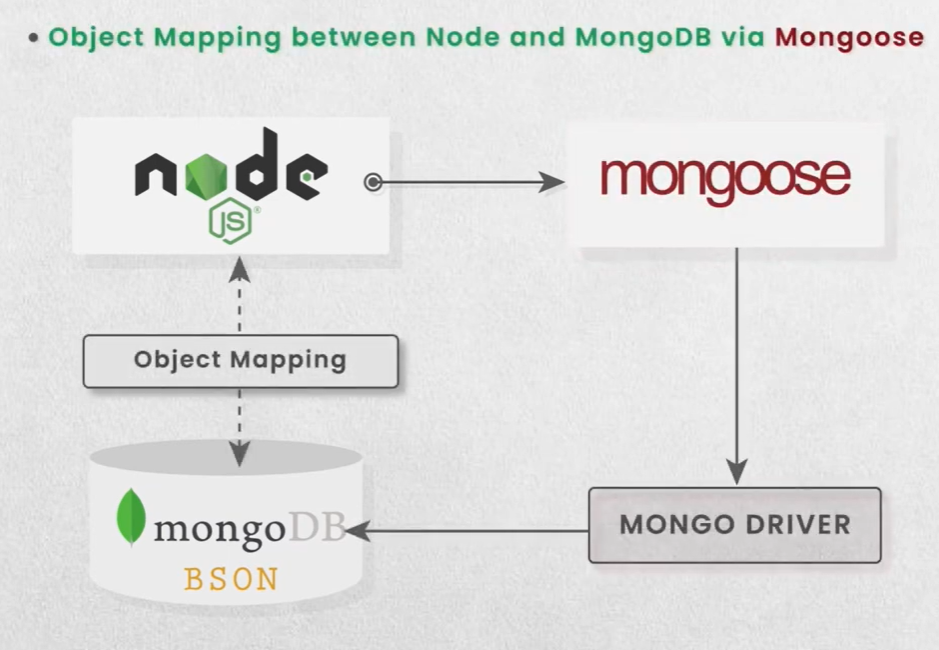

## SQL vs NoSQL


### SQL وNoSQL مقارنة بين 

![Screenshot 2025-12-16 213818.png](<attachment:Screenshot 2025-12-16 213818.png>)

- (Predefined Schemas)  حيث يتم تخزين البيانات في جداول ذات مخطط ثابت (Relational) وتستخدم في قواعد البيانات العلائقية Structured Query Language ترمز إلى SQL 
   
-  (Dynamic, Non-restricted Schemas) حيث لا توجد جداول تقليدية، والمخطط ديناميكي وغير مقيد (Non-relational) وتستخدم في قواعد البيانات غير العلائقية Not Only SQL تعني NoSQL 
     

---

### NoSQL أمثلة على الشركات التي تستخدم 

![Screenshot 2025-12-16 214342.png](<attachment:Screenshot 2025-12-16 214342.png>)

- Google، Facebook، Amazon، Netflix، LinkedIn، Yahoo، eBay، The Guardian في أنظمتها، مثل NoSQL العديد من الشركات العالمية تعتمد على قواعد بيانات 
  
- في التطبيقات الضخمة التي تتطلب مرونة وسرعة في التعامل مع البيانات NoSQL هذا يوضح مدى انتشار 


---

### أنواع قواعد بيانات NoSQL

![Screenshot 2025-12-16 214413.png](<attachment:Screenshot 2025-12-16 214413.png>)


- JSONتخزن البيانات في مستندات شبيهة بـ MongoDB وCouchDB، مثل قواعد بيانات المستندات 
- تخزن البيانات في شكل مفتاح وقيمة Redis وRiak مثل (Key-Value) قواعد بيانات القيم المفتاحية
- تخزن البيانات في أعمدة بدلاً من الصفوف Cassandra وHBase مثل (Wide-Column Stores) قواعد بيانات الأعمدة الواسعة 
- تركز على العلاقات بين البيانات Neo4j، مثل (Graph) قواعد البيانات البيانية 

---

### SQL وNoSQL الفرق في نماذج تخزين البيانات بين 

![Screenshot 2025-12-16 214554.png](<attachment:Screenshot 2025-12-16 214554.png>)

- (Joins) ويمكن الربط بين الجداول باستخدام العلاقات (Columns) يحتوي على أعمدة (Row) وكل سجل يمثل صفًا (Tables) يتم تخزين البيانات في جداول SQL، في قواعد بيانات 
- ويمكن أن يتضمن مستندات مدمجة أو روابط لبيانات أخرى (Fields) وكل مستند يحتوي على حقول (Documents) وكل مجموعة تحتوي على مستندات (Collections) المستندة إلى المستندات، يتم تخزين البيانات في مجموعات NoSQL في قواعد بيانات 

- هذا النموذج يوفر مرونة أكبر في تخزين البيانات، حيث يمكن لكل مستند أن يحتوي على بنية مختلفة عن الآخر.

----
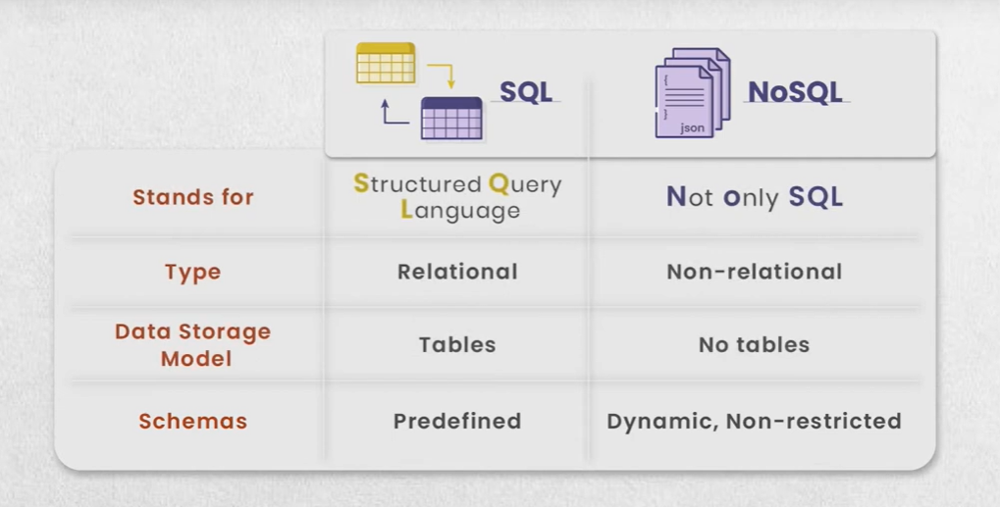
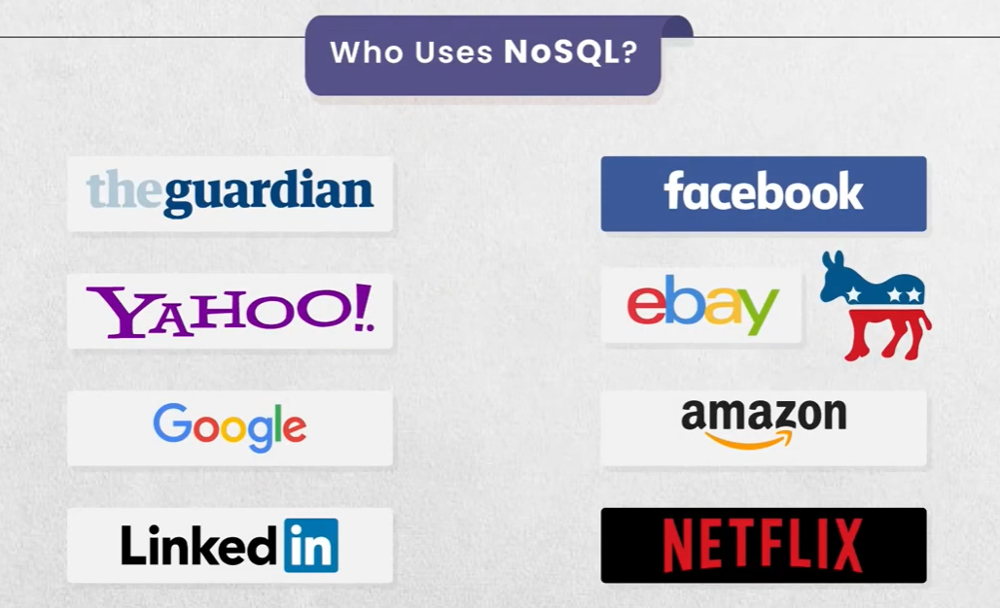
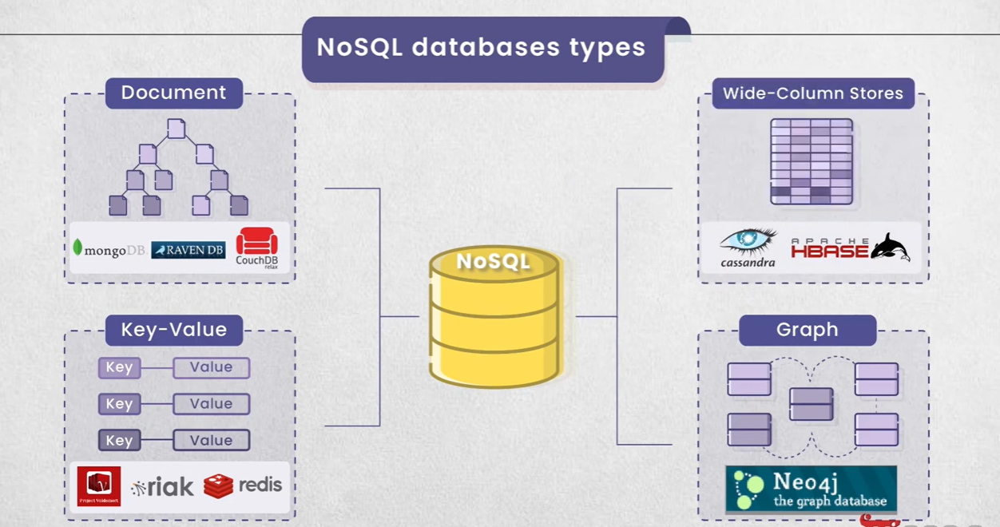
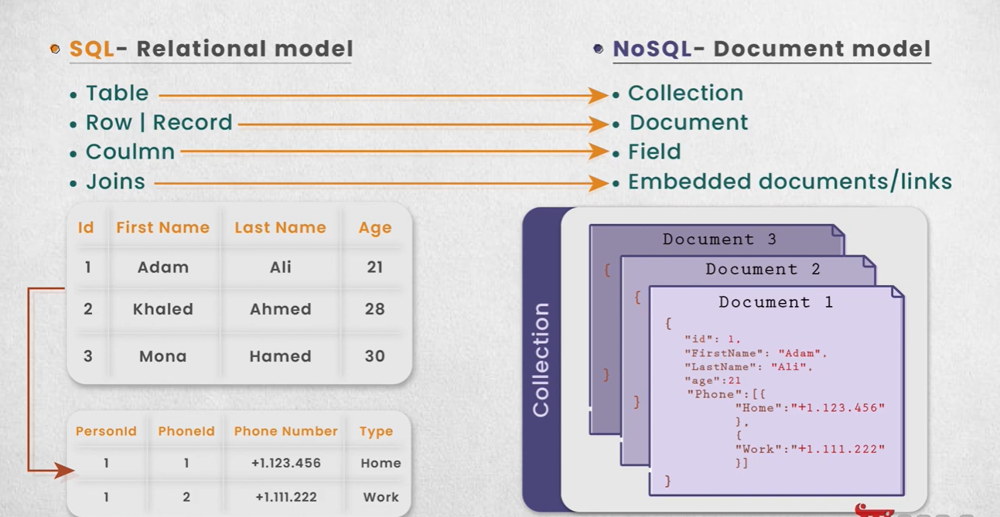

## Installing MongoDB on Windows


### شرح تفصيلي لتثبيت وتشغيل MongoDB
1. **MongoDB تحميل**
   - ادخل على الموقع الرسمي: https://www.mongodb.com/try/download/community
   - Download ثم اضغط (Windows) اختر نظام التشغيل 
   - انتظر حتى ينتهي التحميل.

2. **MongoDB تثبيت**
   - افتح ملف التثبيت الذي تم تحميله.
   - في كل خطوة حتى تصل إلى اختيار نوع التثبيت Next اضغط 
   - Next ثم Complete اختر 
   - Next اترك الإعدادات الافتراضية (تشغيل كخدمة تلقائيًا) ثم Service Configuration في خطوة 
   - Finish أكمل التثبيت حتى 

3. **الوصول إلى مجلد التثبيت:**
   - : غالبًا في المسار MongoDB بعد التثبيت، ستجد مجلد 
     C:\Program Files\MongoDB\Server\6.0\bin
   - (العميل) و mongo.exe (الخادم) mongod.exe ستجد الملفات التنفيذية مثل bin داخل مجلد 
   
4. **MongoDB تشغيل خادم :**
   - كمسؤول CMD افتح نافذة 
   - : باستخدام الأمر bin انتقل إلى مجلد 
     cd C:\Program Files\MongoDB\Server\6.0\bin
   - شغل الخادم بكتابة:
     mongod.exe
   - سيبدأ الخادم ويظهر أنه يستمع على المنفذ 27017.
   - : C على القرص data\db أنشئ مجلد باسم data إذا ظهرت رسالة خطأ عن عدم وجود مجلد 
     mkdir C:\data\db
   - mongod.exe أعد تشغيل

5. **MongoDB (mongo shell) تشغيل عميل:**
   - bin جديدة وانتقل لمجلد CMD افتح نافذة 
   - شغل العميل بكتابة:
     mongo.exe
   - سيتم الاتصال بالخادم ويمكنك الآن تنفيذ أوامر قواعد البيانات.

6. **(واجهة رسومية) MongoDB Compass تشغيل**
   - من الموقع الرسمي MongoDB Compass ثبت برنامج 
   - 27017 والمنفذ localhost  افتح البرنامج وأدخل بيانات الاتصال عادة 
   - بسهولة CRUD وستظهر لك قواعد البيانات ويمكنك تنفيذ عمليات Connect اضغط 
      
> في إعدادات النظام PATH إلى متغير البيئة bin أضف مسار CMD إذا أردت تشغيل الخادم من أي مكان في **ملاحظة:** 

----

## Connecting to MongoDB


![Screenshot 2025-12-18 115524.png](<attachment:Screenshot 2025-12-18 115524.png>)

**شرح الصورة:**
: Mongoose باستخدام مكتبة MongoDB وقاعدة بيانات Node.js الصورة توضح كيف يتم الربط بين 
- هو بيئة تشغيل لتطبيقات الجافاسكريبت على السيرفر : **Node.js**
- والعكس MongoDB أي تحويل الكائنات في جافاسكريبت إلى مستندات يمكن تخزينها في (Object Data Modeling) "مكتبة تقوم بعملية "نمذجة البيانات : **Mongoose** 
- هو المسؤول عن التواصل المباشر مع قاعدة البيانات : **MongoDB Driver** 
- Mongoose والعكس، عبر طبقة MongoDB في BSON إلى مستندات Node.js تعني أن البيانات تنتقل من كائنات جافاسكريبت في : **Object Mapping**
- Driver عبر الـ MongoDB ثم تنتقل إلى Mongoose يوضح أن كل العمليات على البيانات تمر أولاً عبر  Node.js وMongoose السهم المتصل بين 
- بهذه الطريقة، يسهل على المبرمج التعامل مع البيانات ككائنات جافاسكريبت بدون الحاجة لكتابة أوامر قاعدة بيانات معقدة.

### Node.js مع MongoDB شرح نصي منظم لخطوات دمج 

1. **MongoDB تشغيل خادم:**
   - تعمل على جهازك أو على السيرفر المطلوب MongoDB يجب التأكد من أن خدمة 
2. **استخدام عميل للتفاعل مع قاعدة البيانات:**
   - لإدارة البيانات MongoDB Compass يمكنك استخدام أدوات سطر الأوامر أو واجهة رسومية مثل 
3. **Mongoose تثبيت :**
   - بمستندات قاعدة البيانات JavaScript يسمح بربط كائنات Node.js و MongoDB هو موصل بين Mongoose 
4. **Node.js تهيئة مشروع :**
   - Mongoose ثم ثبت مكتبة `package.json` أنشئ مشروع جديد وملف 
5. **كتابة كود الاتصال:**
   - مع عنوان الاتصال المناسب `mongoose.connect()` استخدم 
6. **اختبار الاتصال:**
   - شغل التطبيق وتأكد من ظهور رسالة "تم الاتصال بقاعدة البيانات" في الطرفية.
7. **حل التحذيرات:**
   - إذا ظهرت تحذيرات، أضف الخيارات المناسبة في إعدادات الاتصال.
8. **التحقق النهائي:**
   - تأكد من نجاح الاتصال وعدم ظهور تحذيرات إضافية.
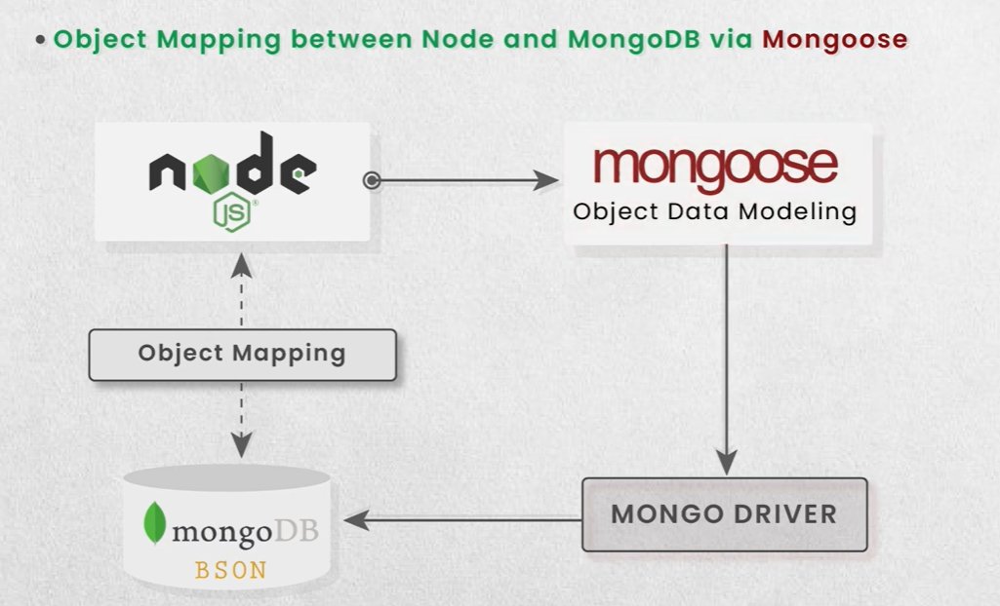

In [ ]:
// (نفذ هذا الأمر في الطرفية أولاً) Mongoose تثبيت مكتبة  
// npm install mongoose

// Mongoose باستخدام MongoDB كود الاتصال بقاعدة بيانات 

// 1) import mongoose 
const mongoose = require('mongoose'); // استدعاء المكتبة للبدء في استخدامها


// 2) connect to database
mongoose.connect('mongodb://localhost:27017/mydatabase', {
  useNewUrlParser: true,    // استخدام محرك تحليل الروابط الجديد (الأسلوب الحديث)
  useUnifiedTopology: true  // استخدام محرك إدارة الاتصال الجديد لضمان استقرار الاتصال
})
.then(() => {
  console.log('تم الاتصال بقاعدة البيانات'); // رسالة نجاح الاتصال
})
.catch((err) => {
  console.error('فشل الاتصال:', err); // في حالة وجود خطأ في الرابط أو السيرفر
});

## Creating Schema and Building Model
    

### (CRUD عمليات) MongoDB مع Mongoose شرح استخدام 
   
![Screenshot 2025-12-18 164644.png](<attachment:Screenshot 2025-12-18 164644.png>)

### 1. الهيكل الأساسي (Schema & Model)
: MongoDBكطبقة وسيطة لتنظيم البيانات قبل إرسالها لـ Mongoose توضح الصورة التالية كيف يعمل  
* (Structure) هو رسم كروكي بيحدد شكل البيانات : **Schema** 
* اللي بنستخدمها عشان نكلم قاعدة البيانات (Interface) هو الأداة أو الواجهة : **Model**

---

![Screenshot 2025-12-18 165711.png](<attachment:Screenshot 2025-12-18 165711.png>)

## 2. (ObjectId) تشريح المعرف الفريد 
 : متقسمة كالتالي **12 Bytes** تلقائي. ده مش مجرد رقم عشوائي، ده بيتكون من  `_id` بتديله Mongoose بنعمله (Document) أي مستند 
      
* وقت إنشاء السجل : **Timestamp (4 Bytes)** 
* معرف الجهاز : **Machine id (3 Bytes)** 
* معرف العملية البرمجية : **Process id (2 Bytes)** 
* عداد تزايدي لضمان عدم التكرار : **Counter (3 Bytes)** 


![Screenshot 2025-12-18 165627.png](<attachment:Screenshot 2025-12-18 165627.png>)

---

### 3. ملخص  وخطوات العمل

: بعد استيراده وإقامة اتصال بقاعدة البيانات Mongoose باستخدام **CRUD** 
  

1.  **إنشاء المخطط (Schema):**
    * يحدد بنية البيانات (مثلاً مجموعة "الطلاب").
    * `String` ونوعهم يكون `firstName`, `lastName`, `department` : نحدد الخصائص مثل 
    * `Number` ونوعه `id` نحدد حقل الـ 
    * يتم إنشاؤه تلقائياً وهو فريد لكل مستند  `_id`حقل الـ 
   
2.  **(Model) إنشاء النموذج :**
    * في قاعدة البيانات (Collection) بمجموعة Schemaنقوم بربط الـ 
    * النموذج هو اللي بيخلينا نقدر نعدل أو نمسح أو نضيف بيانات للطلاب.

3.  **تنفيذ العمليات:**
    * بكل سهولة (Create, Read, Update, Delete) بمجرد جهوزية الموديل، نقدر نطبق عمليات 
    
---
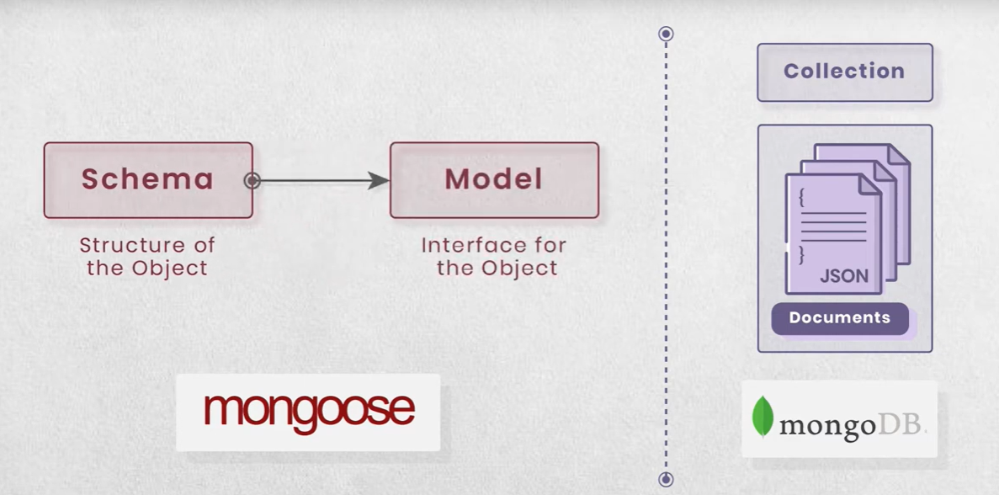
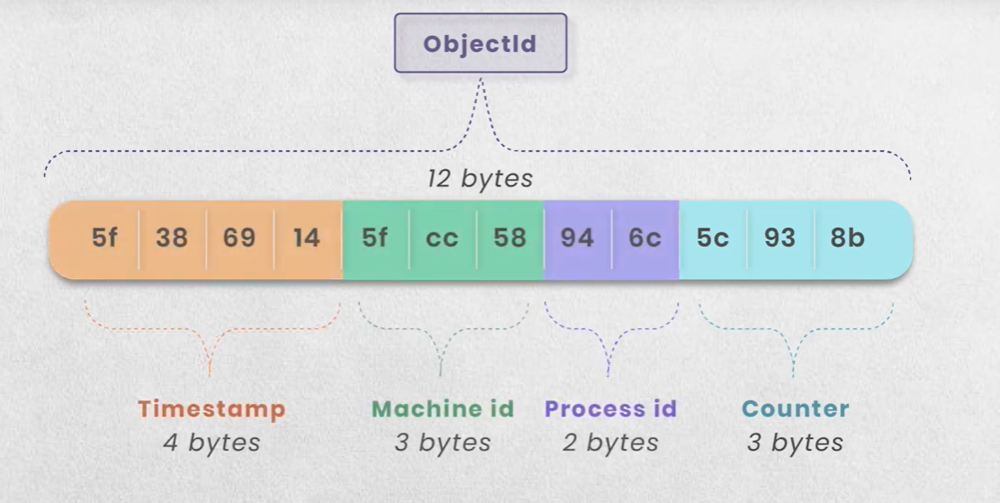
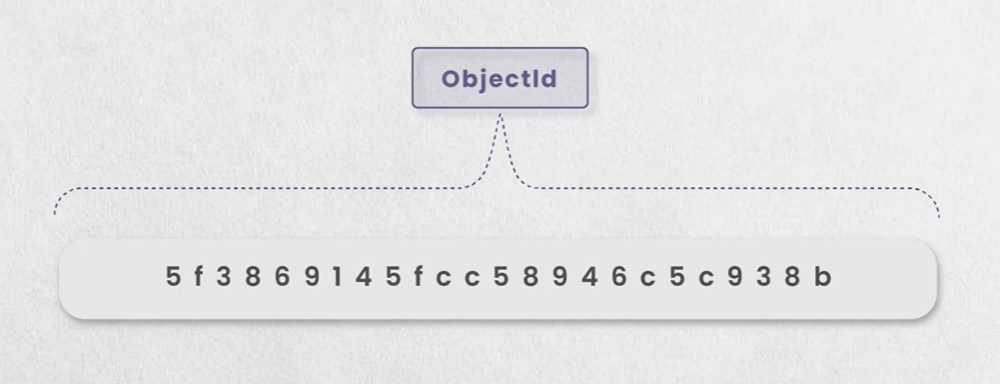

In [ ]:
// 1)import mongoose 
const mongoose = require('mongoose');


//2) connect to database
mongoose.connect('mongodb://localhost:27017/mydatabase', {
  useNewUrlParser: true,
  useUnifiedTopology: true
})
.then(() => {
  console.log('تم الاتصال بقاعدة البيانات');
})
.catch((err) => {
  console.error('فشل الاتصال:', err);
});


// 3) create schema
const studentSchema = new mongoose.Schema({
    fn: String,    // الحقل الأول: الاسم الأول ونوعه نص
    ln: String,    // الحقل الثاني: الاسم الأخير ونوعه نص
    dept: String,  // الحقل الثالث: القسم ونوعه نص
    id: Number,    // الحقل الرابع: رقم تعريف الطالب ونوعه رقم
});


// 4) create model
// بنحدد اسم الموديل 'Student' وبنربطه بالـ Schema اللي عملناه
const Student = mongoose.model('Student', studentSchema);


// CRUD Operations 


## Querying Documents Using Helper Methods
 

### 1. (Schema to Model) هيكلة البيانات 
قبل تنفيذ أي استعلام، يجب فهم كيف تتحول الشفرة البرمجية إلى بيانات مخزنة:
* يحدد شكل المستند (مثلاً: الاسم، القسم، الرقم) : **Schema**
* `.find()` هو الواجهة البرمجية التي تسمح لنا باستدعاء طرق مثل : **Model**  
* معرف فريد يتكون من 12 بايت (يحتوي على وقت الإنشاء ومعرف الجهاز والعملية وعداد) ويُنشأ تلقائياً : **_id (ObjectId)**

---

### 2. (Querying) استراتيجيات البحث والاستعلام 
(Custom Collections) ركزنا على كيفية جلب البيانات من المجموعات المخصصة 

#### أ. طرق البحث الأساسية

* تستخدم لاسترجاع البيانات : **`find()`** 
* ("alia" تختلف عن "Alia" : مثلاً ) حساسة لحالة الأحرف MongoDB عمليات البحث في : **(Case Sensitivity) حساسية الأحرف**    
* لجعل الكود أكثر تنظيماً `.then()` بدلاً من `getAllStudents` داخل الدوال مثل دالة `async/await` يفضل استخدام : **(Async/Await) التعامل مع النتائج**   

### (Query Helpers) ب. أدوات تحسين الاستعلام 
: طرقاً قوية للتحكم في شكل ونوع البيانات المسترجعة Mongoose يوفر 
 

| الأداة | الوظيفة | المثال |
| :--- | :--- | :--- |
| **`limit()`** | تحديد عدد السجلات المسترجعة | `.limit(10)` |
| **`sort()`** | ترتيب النتائج (تصاعدي/تنازلي) | `.sort({ fn: 1 })` |
| **`select()`** | اختيار حقول معينة فقط للعرض | `.select('fn ln')` |

---

### 3. تطبيق عملي 

: لإدارة البيانات، يكون الهيكل البرمجي كالتالي `getAllStudents` عند إنشاء دالة مثل 
 

```javascript
async function getAllStudents() {
    // 1. استخدام Model.find للبحث في مجموعة معينة
    const students = await Student.find()
        .limit(5)            // عرض عدد محدود
        .sort({ fn: 1 })     // ترتيب أبجدي حسب الاسم الأول
        .select('fn ln');    // إظهار الاسم الأول والأخير فقط (توفير في حجم البيانات)
        
    return students;
}

In [ ]:
// (نفذ هذا الأمر في الطرفية أولاً) Mongoose تثبيت مكتبة  
// npm install mongoose

// Mongoose باستخدام MongoDB كود الاتصال بقاعدة بيانات 

// 1)import mongoose 
const mongoose = require('mongoose');


//2) connect to database
mongoose.connect('mongodb://localhost:27017/mydatabase', {
  useNewUrlParser: true,
  useUnifiedTopology: true
})
.then(() => {
  console.log('تم الاتصال بقاعدة البيانات');
})
.catch((err) => {
  console.error('فشل الاتصال:', err);
});



// 3) create schema
const studentSchema = new mongoose.Schema({

    fn:String,
    ln:String ,
    dept:String,
    id:Number,
 
});


//4)create model
const Student = mongoose.model('Student', studentSchema);


// CRUD Operations (عمليات البحث والقراءة)

// البحث عن الطلاب اللي اسمهم "Ali" (بترجع مصفوفة Array)
Student.find({fn: "Ali"}).then(data => {
    console.log("All Students:", data);
});

// البحث عن طالب واحد باستخدام المعرف الفريد (ObjectId)
Student.findById("5f3869145fcc58946c5c938b").then(data => {
    console.log("Student by ID:", data);
});

// Whereمثال لاستخدام الـ  
// Student.find({}).where("fn").equals("Ali").then(console.log);


// دالة جلب الطلاب مع استعلامات متقدمة (ترتيب وتصفية)
async function getAllStudents(req, res) {
 // find({}): جلب الكل | limit(10): أول 10 سجلات | sort: ترتيب تصاعدي حسب fn
 // select: اختيار حقول محددة فقط للعرض (الاسم الأول والأخير)
 let request = await Student.find({}).limit(10).sort({ fn: 1 
 }).select({ fn: 1, ln: 1 }); // ملحوظة: الـ _id يظهر تلقائياً
 
  console.log(request); // طباعة النتيجة النهائية المنسقة
}



## Querying Documents Using Regular Expressions


In [ ]:
// 1) import mongoose 
const mongoose = require('mongoose');

// 2) connect to database
mongoose.connect('mongodb://localhost:27017/mydatabase', {
  useNewUrlParser: true,
  useUnifiedTopology: true
})
.then(() => {
  console.log('تم الاتصال بقاعدة البيانات');
})
.catch((err) => {
  console.error('فشل الاتصال:', err);
});

// 3) create schema
const studentSchema = new mongoose.Schema({
    fn: String,
    ln: String,
    dept: String,
    id: Number,
});

// 4) create model
const Student = mongoose.model('Student', studentSchema);

// CRUD Operations 
Student.find({fn: "Ali"}).then(data => {
    console.log("All Students:", data);
});

Student.findById("5f3869145fcc58946c5c938b").then(data => {
    console.log("Student by ID:", data);
});

// --- (Regex Query) ---

async function getAllStudents(req, res) {
  /**
   * شرح التعديل:
   * لعمل بحث مرن (Regular Expressions) استخدمنا التعبيرات المنتظمة 
   * S (Like 'S%') تعني ابدأ بحرف /^S/  
   * / (Like 'S%A') وبينهما أي عدد من الحروف A وانتهي بـ Sابدأ بـ : ^S.*A$/i       
   */
  let request = await Student.find({ 
    fn: /^S.*A$/i  // (i غير حساس للحالة بفضل ) A وينتهي بـ S  البحث عن اسم يبدأ بـ 
  })
  .limit(10)      // تحديد عدد النتائج (ممكن تشيله لو عايز كل المطابق)
  .sort({ fn: 1 }) 
  .select({ fn: 1, ln: 1 }); 
  
  console.log("النتائج المطابقة للنمط:", request); 
}

getAllStudents();


## Comparison Query Operators


### (Comparison Query Operators) استخدام عوامل التصفية 

أو استثناء قيم معينة بدلاً من البحث عن قيم مطابقة تماماً(Ranges) تُستخدم هذه العوامل لاسترجاع بيانات محددة بناءً على مقارنات منطقية، وهي تتيح لنا تحديد نطاقات 

![Screenshot 2025-12-18 221831.png](<attachment:Screenshot 2025-12-18 221831.png>)

### 1. أنواع عوامل التصفية ووظائفها
| العامل | المعنى | الوظيفة |
| :--- | :--- | :--- |
| **`$gt`** | Greater Than | جلب القيم الأكبر من الرقم المحدد. |
| **`$gte`** | Greater Than or Equal | جلب القيم الأكبر من أو تساوي الرقم المحدد. |
| **`$lt`** | Less Than | جلب القيم الأقل من الرقم المحدد. |
| **`$lte`** | Less Than or Equal | جلب القيم الأقل من أو تساوي الرقم المحدد. |
| **`$ne`** | Not Equal | جلب القيم التي لا تساوي القيمة المحددة. |
| **`$in`** | In | (Array) البحث عن قيم موجودة ضمن قائمة . |
| **`$nin`** | Not In | (Array) البحث عن قيم غير موجودة ضمن قائمة . |

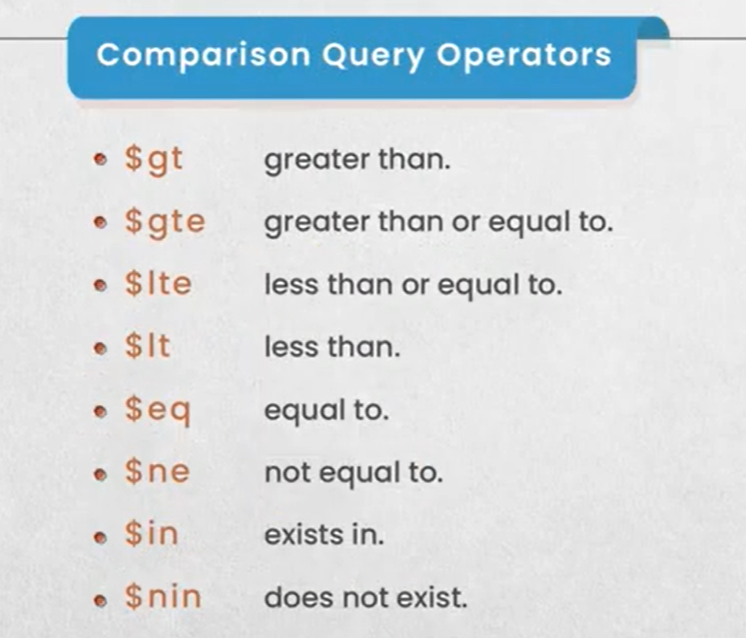

In [ ]:
const mongoose = require('mongoose');

// 1) الاتصال بقاعدة البيانات
mongoose.connect('mongodb://localhost:27017/mydatabase', {
  useNewUrlParser: true,
  useUnifiedTopology: true
})
.then(() => console.log('✅ تم الاتصال بقاعدة البيانات'))
.catch(err => console.error('❌ فشل الاتصال:', err));

// // 2) تعريف الهيكل (Schema)
// const studentSchema = new mongoose.Schema({
//     fn: String,
//     ln: String,
//     dept: String,
//     id: Number,
// });

// // 3) إنشاء النموذج (Model)
// const Student = mongoose.model('Student', studentSchema);

/**
 * 4) مثال قوي: استعلام يجمع بين البحث بالأنماط وعوامل المقارنة
 * الهدف: جلب الطلاب الذين يبدأ اسمهم بـ S وينتهي بـ A 
 * وبشرط أن يكون معرفهم (id) بين 10 و 50، مع ترتيبهم تنازلياً.
 */
async function getAdvancedStudents() {
  try {
    let result = await Student.find({
      // أولاً: استخدام Regex للبحث المرن (Like 'S%A')
      fn: /^S.*A$/i, 
      
      // ثانياً: استخدام Comparison Operators لتحديد نطاق (Range)
      id: { 
        $gte: 10, // أكبر من أو يساوي 10
        $lte: 50  // أقل من أو يساوي 50
      }
    })
    .limit(5)           // تحديد النتائج بـ 5 طلاب فقط
    .sort({ id: -1 })   // ترتيب تنازلي (-1) من الأكبر للأصغر
    .select({ fn: 1, id: 1, dept: 1 }); // اختيار حقول معينة للعرض

    console.log(" نتائج الاستعلام المتقدم:", result);
  } catch (err) {
    console.error("حدث خطأ أثناء الاستعلام:", err);
  }
}

// تنفيذ الدالة
getAdvancedStudents();

## Logical Query Operators


In [ ]:
const mongoose = require('mongoose');

// 1) الاتصال بقاعدة البيانات
mongoose.connect('mongodb://localhost:27017/mydatabase', {
  useNewUrlParser: true,
  useUnifiedTopology: true
})
.then(() => console.log('✅ تم الاتصال بقاعدة البيانات'))
.catch(err => console.error('❌ فشل الاتصال:', err));

// 2) تعريف الهيكل (Schema)
const studentSchema = new mongoose.Schema({
    fn: String,
    ln: String,
    dept: String,
    id: Number,
});

// 3) إنشاء النموذج (Model)
const Student = mongoose.model('Student', studentSchema);

/**
 * 4) مثال قوي يجمع بين العمليات المنطقية ($or, $and) والبحث بالأنماط (Regex)
 */
async function getFilteredStudents() {
  try {
    // أ) استخدام $or: لجلب الطلاب الذين اسمهم الأول "Ahmed" أو اسمهم الأخير "Ahmed"
    let orResult = await Student.find({
      $or: [
        { fn: "Ahmed" },
        { ln: "Ahmed" }
      ]
    });

    /**
     * ب) استخدام $and مع Regex:
     * المطلوب: الطلاب الذين ينتهي اسم عائلتهم بـ "mod" وفي نفس الوقت ينتمون لقسم "sa"
     */
    let andResult = await Student.find({
      $and: [
        { ln: /mod$/i }, // ينتهي بـ "mod" (Case-insensitive)
        { dept: "sa" }   // ينتمي لقسم "sa" حصراً
      ]
    })
    .sort({ id: 1 })
    .select({ fn: 1, ln: 1, dept: 1 });

    console.log("📑 نتائج البحث بـ (أو - Ahmed):", orResult);
    console.log("📑 نتائج البحث بـ (و - قسم sa):", andResult);

  } catch (err) {
    console.error("حدث خطأ أثناء الاستعلام:", err);
  }
}

// تنفيذ الدالة
getFilteredStudents();

## Validation


### (Data Integrity) مفهوم تفرد البيانات والتحقق من الصحة 

### 1. (Unique ID) أهمية المعرف الفريد 
* هو حجر الأساس لتمييز كل مستند عن غيره داخل القاعدة (ID) المعرف : **تحدي التكرار**   
* قد يظهر نفس المعرف مرتين عند غياب عمليات التحقق، مما يؤدي لتداخل البيانات : **مشكلة غياب التحقق** 
* التفرد يضمن استرجاع المعلومة الصحيحة دون اختلاطها بغيرها : **دقة البيانات** 

---

### 2. MongoDB (Schema-less) مرونة 
* تخزين وثائق بخصائص مختلفة (مثل: مستند فيه "عنوان" ومستند لاء) MongoDB تتيح : **تنوع الخصائص** 
* النظام يعطي حرية كبيرة في التطوير لكنه يتطلب إدارة حذرة لضمان جودة البيانات : **المرونة البرمجية** 

---

### 3. في فرض النظام (Schema) دور المخطط 

* لفرض قواعد تمنع تخزين بيانات عشوائية **Schema**نستخدم الـ **إنشاء القيود** 
* المخطط يمثل "الفلتر" الذي يراجع البيانات قبل حفظها نهائياً **(Validation) التحقق** 
* منظمة داخل القاعدة (Document) هو الواجهة البرمجية التي تحول الكود إلى وثيقة : **(Model) النموذج** 

---

## Built-in Validators


###  بناء المخطط والتحقق من البيانات (Schema & Built-in Validators)

يضمن أن كل معلومة تدخل قاعدة البيانات صحيحة ومنطقية (Schema) في هذا الجزء، ننتقل من مرحلة تخزين البيانات العشوائية إلى مرحلة الاحترافية، حيث نقوم ببناء هيكل تنظيمي 
 

---

![Screenshot 2025-12-18 231441.png](<attachment:Screenshot 2025-12-18 231441.png>)

### 1. (Schema Types) أنواع البيانات في المخطط 
عند تعريف المخطط، يجب تحديد نوع البيانات لكل حقل لضمان التناسق:
* **`String`**: للنصوص مثل الأسماء والأقسام.
* **`Number`**: أو السن (ID) للأرقام مثل المعرف 
* **`Date`**: لتخزين التواريخ.
* **`Boolean`**: للقيم المنطقية (صح/خطأ).
* **`Array`**: لتخزين قوائم من البيانات.

---

![Screenshot 2025-12-18 231744.png](<attachment:Screenshot 2025-12-18 231744.png>)

### 2. (Built-in Validators) أدوات التحقق الجاهزة 
تسمح لنا هذه الأدوات بفرض قيود برمجية صارمة لمنع إدخال بيانات خاطئة:

###  قيود عامة:
* **`required`**: تجعل الحقل إلزامياً (لا يمكن حفظ الطالب بدون اسم مثلاً).

###  قيود النصوص (String):
* **`minLength` & `maxLength`**: لتحديد الحد الأدنى والأقصى لعدد الحروف.
* **`enum`**: (CS, IS, IT : مثل ) لتقييد الإدخال بقائمة خيارات محددة فقط 
* **`match`**: (Regex) للتأكد من أن النص يتبع نمطاً معيناً باستخدام 

### (Number) قيود الأرقام 
* **`min` & `max`**: لتحديد النطاق المسموح به للرقم (مثلاً المعرف بين 30 و 3000).

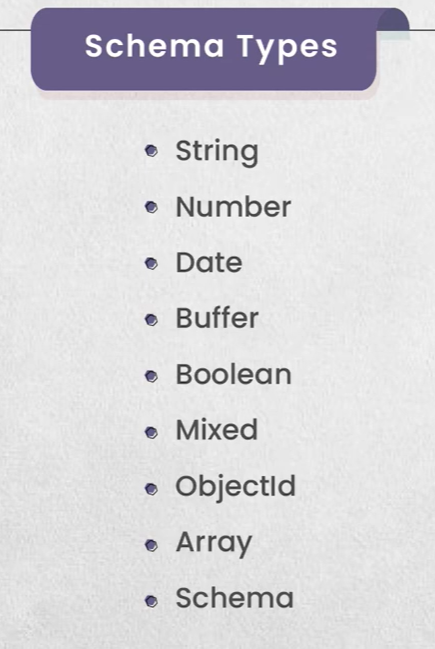
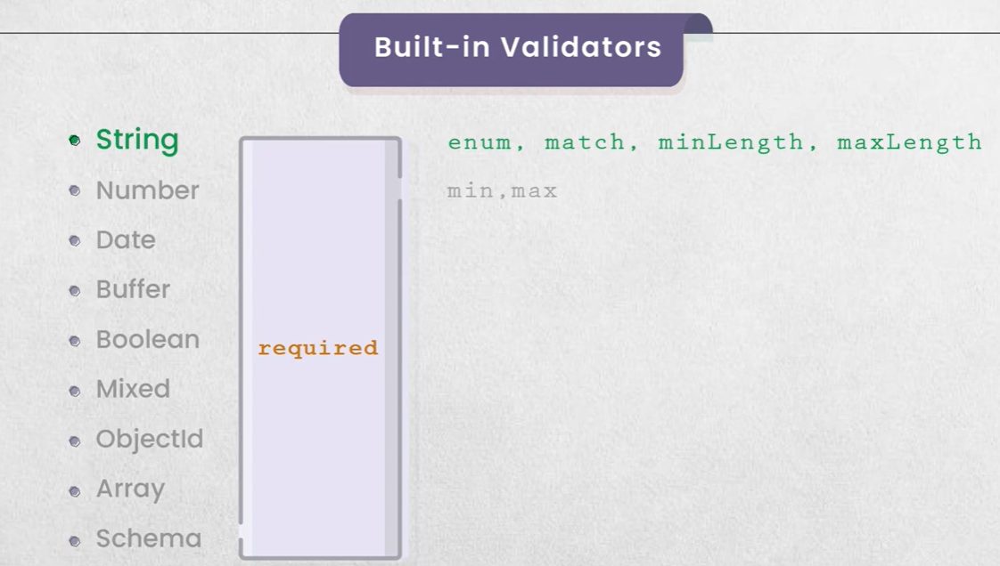

In [ ]:
const mongoose = require('mongoose');

// (Validators) تعريف المخطط مع إضافة القيود 
const studentSchema = new mongoose.Schema({
    fn: { 
        type: String, 
        required: true,        // الحقل إلزامي
        minLength: 3,          // أقل طول للاسم 3 حروف
        maxLength: 20          // أقصى طول للاسم 20 حرف
    },
    ln: { 
        type: String, 
        required: true 
    },
    dept: { 
        type: String, 
        enum: ['CS', 'IS', 'IT', 'SA'], // لا يقبل إلا هذه القيم فقط
        required: true 
    },
    id: { 
        type: Number, 
        required: true, 
        min: 30,               // أقل قيمة مسموحة 30
        max: 3000,             // أقصى قيمة مسموحة 3000
        unique: true           // يمنع تكرار المعرف نهائياً
    }
});

// إنشاء النموذج (Model)
const Student = mongoose.model('Student', studentSchema);

// دالة تجريبية لإنشاء طالب
async function createStudent() {
    try {
        const newStudent = new Student({
            fn: "Ahmed",
            ln: "Mohamed",
            dept: "SA",
            id: 150
        });
        
        const result = await newStudent.save();
        console.log("✅ تم حفظ الطالب بنجاح:", result);
    } catch (err) {
        console.error("❌ خطأ في التحقق من البيانات:", err.message);
    }
}

createStudent();

## Creating and Saving New Documents


###  (Saving Documents) عملية حفظ الوثائق في قاعدة البيانات 

![Screenshot 2025-12-18 233206.png](<attachment:Screenshot 2025-12-18 233206.png>)

###  رحلة البيانات من الكود إلى القاعدة
: على تدفق منطقي لضمان سلامة البيانات قبل التخزين **Mongoose** تعتمد مكتبة 


1. يمثل الهيكل والقواعد مثل النوع والقيود : **(Schema) المخطط**
2. MongoDB في (Collection) هو الواجهة البرمجية التي تربط الكود بمجموعة البيانات : **(Model) النموذج** 
3. يتم إنشاؤه في الذاكرة بناءً على المخطط JSON كائن : **(Document Instance) المثيل**  
4. هي الأداة التي تنقل البيانات لتصبح وثيقة مخزنة فعلياً : **`save()` دالة** 



---

### (addNewStudent) ملخص عملية الإضافة 
تعتمد عملية إضافة طالب جديد على عدة خطوات تقنية:

* لاستقبال بيانات الطالب مثل الاسم والقسم والمعرف `addNewStudent` يتم إنشاء دالة مثل : **تعريف الدالة** 
* (Promise) هي عملية غير متزامنة، لذا تعود بوعد `.save()` دالة : **(Promise) الوعد**   
* : بمراجعة البيانات تلقائياً قبل الحفظ Mongoose يقوم : **اختبار القيود** 
    * ستفشل العملية "pd" المسموحة مثل `enum` إذا كان القسم غير موجود في قائمة 
    * خارج النطاق المحدد، ستفشل عملية الحفظ (ID) إذا كان المعرف 

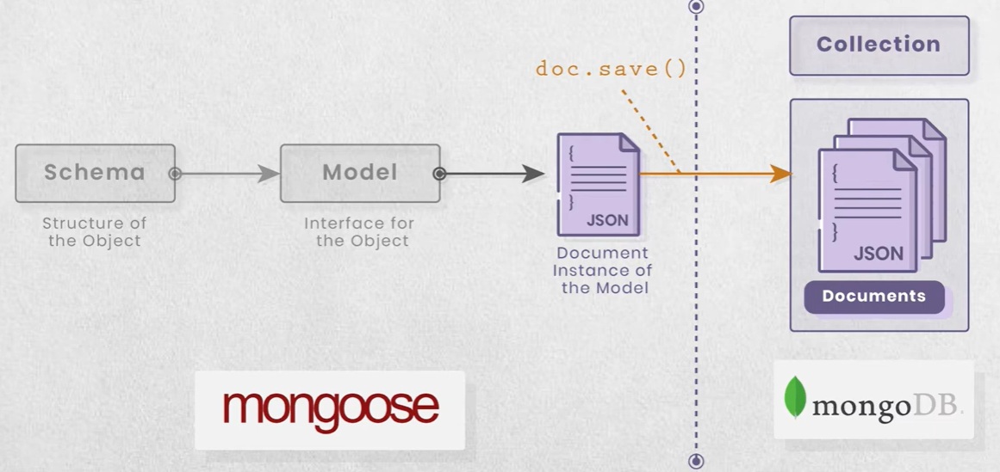

In [ ]:
const mongoose = require('mongoose');

/**
 * 1️ تعريف المخطط (Schema)
 * يحدد هيكل الوثيقة والقيود البرمجية (Validators) لضمان صحة البيانات.
 */
const studentSchema = new mongoose.Schema({
    fn: { 
        type: String, 
        required: true // حقل إلزامي
    },
    ln: { 
        type: String, 
        required: true // حقل إلزامي
    },
    dept: { 
        type: String, 
        enum: ['CS', 'IS', 'IT', 'sa'], // تقييد القيم المسموح بها فقط
        required: true 
    },
    id: { 
        type: Number, 
        min: 30,       // القيمة الدنيا 30
        max: 3000,     // القيمة القصوى 3000
        required: true,
        unique: true   // يضمن أن يكون المعرف فريداً وغير مكرر
    }
});

/**
 * 2️ إنشاء النموذج (Model)
 * يربط المخطط بمجموعة الطلاب في قاعدة البيانات.
 */
const Student = mongoose.model('Student', studentSchema);

/**
 * 3️     دالة إضافة طالب جديد (addNewStudent)
 * دالة غير متزامنة تتعامل مع الـ Promises لحفظ البيانات.
 */
async function addNewStudent(firstName, lastName, department, studentId) {
    try {
        // إنشاء "مثيل" (Instance) جديد من كائن الطالب
        const student = new Student({
            fn: firstName,
            ln: lastName,
            dept: department,
            id: studentId
        });

        // استخدام دالة save() لحفظ الوثيقة في قاعدة البيانات
        // تعود هذه الدالة بـ Promise بسبب طبيعة العمليات غير المتزامنة
        const result = await student.save();
        
        // طباعة رسالة تأكيد عند نجاح التخزين
        console.log("✅ تم حفظ الطالب الجديد بنجاح:", result);
        
    } catch (err) {
        // آلية التعامل مع الأخطاء (مثل أخطاء الاتصال أو فشل قواعد التحقق)
        // سيظهر الخطأ هنا إذا كان القسم "pd" أو المعرف خارج النطاق
        console.error("❌ فشل في عملية التخزين:", err.message);
    }
}

/**
 * 4️ تجربة الكود (Testing)
 */

// تجربة ناجحة: بيانات مطابقة لجميع القيود
addNewStudent("Nader", "Zain", "sa", 50);

// تجربة فاشلة: ستعطي خطأ لأن القسم "pd" غير مسموح والمعرف أقل من 30
addNewStudent("Ali", "Ahmed", "pd", 10);

## Handling Validation Errors


In [ ]:
const mongoose = require('mongoose');

// 1. تعريف المخطط مع القيود (Validators)
const studentSchema = new mongoose.Schema({
    fn: { type: String, required: [true, "يجب إدخال الاسم الأول"] },
    ln: { type: String, required: [true, "يجب إدخال اسم العائلة"] },
    dept: { 
        type: String, 
        enum: ['CS', 'IS', 'IT', 'sa'], 
        required: [true, "القسم مطلوب"] 
    },
    id: { 
        type: Number, 
        min: [30, "المعرف يجب ألا يقل عن 30"], 
        max: [3000, "المعرف يجب ألا يزيد عن 3000"], 
        required: true 
    }
});

const Student = mongoose.model('Student', studentSchema);

// 2. دالة الإضافة مع معالجة الأخطاء المتقدمة
async function addNewStudent(firstName, lastName, department, studentId) {
    try {
        const student = new Student({
            fn: firstName,
            ln: lastName,
            dept: department,
            id: studentId
        });

        const result = await student.save();
        console.log("✅ تم حفظ الطالب بنجاح:", result);

    } catch (err) {
        /**
         * الجزء الجديد: التعامل مع كائن الاستثناء (ex)
         * نقوم بعمل تكرار (Loop) على خاصية errors لعرض كل رسالة على حدة
         */
        console.log("❌ حدثت أخطاء في التحقق من البيانات:");
        
        for (let field in err.errors) {
            // الوصول لخاصية message داخل كل خطأ لكل حقل
            console.log(`- الحقل [${field}]: ${err.errors[field].message}`);
        }
    }
}

// 3. اختبار الكود ببيانات خاطئة عمداً
// هنا القسم "pd" غير صالح، والمعرف "10" أقل من الحد الأدنى
addNewStudent("Ali", "Ahmed", "pd", 10);

## Custom Validators


In [ ]:
const mongoose = require('mongoose');

// 1. تعريف المخطط مع استخدام Custom Validator
const studentSchema = new mongoose.Schema({
    fn: { type: String, required: true },
    ln: { type: String, required: true },
    dept: { 
        type: String, 
        required: [true, "القسم مطلوب"],
        // enum: ['CS', 'IS', 'IT', 'sa'], 
        // استخدام المحقق المخصص بدلاً من enum
        validate: {
            validator: function(v) {
                // شرط: يجب أن يبدأ بـ s أو m وينتهي بـ a أو d
                return /^[sm][ad]$/i.test(v);
            },
            message: props => `${props.value} ليس قسماً صالحاً! يجب أن يبدأ بـ (s,m) وينتهي بـ (a,d)`
        }
    },
    id: { 
        type: Number, 
        min: [30, "المعرف صغير جداً"], 
        max: [3000, "المعرف كبير جداً"], 
        required: true 
    }
});

const Student = mongoose.model('Student', studentSchema);

// 2. دالة الإضافة مع معالجة الأخطاء
async function addNewStudent(firstName, lastName, department, studentId) {
    try {
        const student = new Student({
            fn: firstName,
            ln: lastName,
            dept: department,
            id: studentId
        });

        const result = await student.save();
        console.log("✅ تم الحفظ بنجاح:", result);

    } catch (ex) {
        console.log("❌ خطأ في التحقق:");
        for (let field in ex.errors) {
            console.log(`- ${ex.errors[field].message}`);
        }
    }
}

// --- اختبارات السيناريوهات ---

// 1. اختبار قسم غير صالح (مثلاً 'xy') -> سيظهر خطأ الملحق المخصص
addNewStudent("Nader", "Zain", "xy", 50);

// 2. اختبار قسم صالح لكن ID خطأ -> سيظهر خطأ الـ ID المدمج
addNewStudent("Nader", "Zain", "sa", 10);

// 3. اختبار بيانات صحيحة تماماً -> سيتم الحفظ
addNewStudent("Nader", "Zain", "md", 100);

## SchemaType Options


In [ ]:
const mongoose = require('mongoose');

/**
 * تعريف المخطط مع تطبيق تقنيات الـ Setters والتنسيق التلقائي
 */
const studentSchema = new mongoose.Schema({
    fn: { 
        type: String, 
        required: [true, "الاسم الأول إلزامي"],
        // [Sanitization] إزالة الفراغات من الطرفين لضمان دقة الاستعلامات مستقبلاً
        trim: true,        
        // [Normalization] تحويل الاسم لحروف كبيرة لتوحيد مظهر البيانات في التقارير
        uppercase: true    
    },
    ln: { 
        type: String, 
        required: true,
        trim: true 
    },
    dept: { 
        type: String, 
        required: true,
        // [Standardization] تحويل القسم لحروف صغيرة دائماً لتسهيل المقارنة (Case-insensitive)
        lowercase: true    
    },
    id: { 
        type: Number, 
        required: true,
        /**
         * [Custom Setter] تعديل القيمة برمجياً قبل الحفظ
         * تستخدم هنا لتحويل الرقم أو تشفيره أو ضبطه بناءً على منطق العمل (Business Logic)
         */
        set: (value) => {
            console.log(`➡️ جاري معالجة المعرف الأصلي: ${value}`);
            return value * 1000; // مثال: تحويل المعرف لنظام ترقيم آلي مختلف
        },
        /**
         * [Field Selection Control]
         * إذا تم ضبطه لـ false، سيتم إخفاء هذا الحقل تلقائياً من نتائج البحث (Query results)
         * لزيادة الأمان أو تقليل حجم البيانات المسترجعة.
         */
        select: true 
    }
});

const Student = mongoose.model('Student', studentSchema);

/**
 * دالة إضافة الطالب مع تتبع تأثير المعالجة المسبقة
 */
async function addNewStudent(firstName, lastName, department, studentId) {
    try {
        const student = new Student({
            fn: firstName,
            ln: lastName,
            dept: department,
            id: studentId
        });

        // عند استدعاء save، يتم تنفيذ جميع الـ Setters والـ Formatters
        const result = await student.save();

        console.log("\n✅ تم حفظ الوثيقة بنجاح. إليك شكل البيانات بعد المعالجة:");
        console.log("--------------------------------------------------");
        console.log(`🔹 الاسم (بعد الـ Trim & Uppercase): [${result.fn}]`);
        console.log(`🔹 القسم (بعد الـ Lowercase): [${result.dept}]`);
        console.log(`🔹 المعرف (بعد الـ Setter): [${result.id}]`);
        
    } catch (ex) {
        console.error("❌ فشل الحفظ بسبب خطأ في التحقق:", ex.message);
    }
}

// --- اختبار السيناريو ---
// إدخال بيانات "غير نظيفة" لاختبار كفاءة المخطط
// الاسم فيه مسافات، القسم حروف كبيرة، المعرف رقم بسيط
addNewStudent("   youssef   ", "ahmed", "IT", 7);

# CH09 - Performing CRUD Operations Using Mongoose

### شرح التعديلات وربط نموذج الطلاب بالمشروع

- الطلاب باستخدام مكتبة Models داخل مجلد `studentMongooseModel.js` تم إضافة ملف جديد باسم  
(Model) والنموذج Schemaويشمل الاتصال بقاعدة البيانات، وإنشاء الـ  Mongoose يحتوي على نموذج 
- مع تحقق من القيم الافتراضية وطول النص (الاسم fn، القسم dept، رقم الهوية id) النموذج يحدد شكل بيانات الطالب 
- النموذج الجديد مرتبط بملفات المشروع كالتالي:
  - **app.js:** 
  نقطة الدخول للمشروع، حيث يتم استقبال الطلبات وتوجيهها للمسارات المناسبة، ويقوم بتهيئة الاتصال بقاعدة البيانات
  - **routes/Students.js:**
  Controllers يحتوي على نقاط النهاية الخاصة بالطلاب (مثل إضافة أو جلب طالب)، ويستدعي دوال التحكم من .
  - **Controllers/StudentsControllers.js:** 
  وتم تعديله ليستخدم نموذج الطلاب الجديد مباشرة Models على الطلاب، ويستدعي النموذج المناسب من CRUD ينفذ عمليات 
  
  - **Models/studentMongooseModel.js:** 
 Mongoose النموذج الجديد الذي يتعامل مع قاعدة البيانات عبر .

---

## Adjusting MongoDB Connection String


### تلخيص إدارة الاتصال بقاعدة البيانات في المشروع

في هذا  تم شرح كيفية بناء نقاط النهاية لمجموعات البيانات المختلفة في قاعدة البيانات، مع التركيز على تجنب تكرار سلسلة الاتصال في كل نموذج.

- فقط، وهو نقطة الدخول للمشروع **app.js** تم وضعها في ملف (MongoDB) سلسلة الاتصال بقاعدة البيانات 
- ولا تحتاج لتكرار الكود الخاص بالاتصال app.js تعتمد على الاتصال المركزي الموجود في `studentMongooseModel.js` مثل (Models) جميع النماذج 

- هذا الأسلوب يجعل إدارة الاتصال والصيانة أسهل، ويمنع تكرار الكود في كل نموذج أو ملف.

> تلقائيًا، ولن تحتاج لإعادة كتابة سلسلة الاتصال في كل مكان app.js أي نموذج جديد تضيفه (مثل نموذج للمدرسين أو الكورسات) سيستخدم نفس الاتصال الموجود في 
 
هذا يحقق أفضل تنظيم للمشروع ويسهل عملية التطوير والصيانة.

---

## Updating Controller , Creating a Document , Reading Documents , Updating Documents , Deleting Documents



### مع قاعدة بيانات CRUD شرح التعديلات على ملفات المشروع عمليات 
 

### الجزء الأول: إعداد الاتصال وقاعدة البيانات
- `studentMongooseModel.js` وملف النموذج `app.js` في ملف MongoDB تم التأكد من وجود الاتصال بقاعدة بيانات 
- لإدارة الاتصال وإنشاء النماذج Mongoose تم استخدام مكتبة 

### الجزء الثاني: تعديل نموذج الطالب
- : ليشمل الحقول التالية `Models/studentMongooseModel.js` تم تعديل ملف 
  - `fn`: الاسم الأول (مطلوب)
  - `ln`: الاسم الأخير (مطلوب)
  - `dept`: القسم
  - `id`: رقم الطالب (مطلوب وفريد)

### الجزء الثالث: إنشاء متحكم جديد لعمليات CRUD
- `Controllers/student-controller-database.js` تم إنشاء ملف جديد باسم .
- CRUD يحتوي هذا الملف على جميع دوال :
  - `createStudent`: إضافة طالب جديد.
  - `getStudentById`: جلب طالب بالمعرف.
  - `getAllStudents`: جلب جميع الطلاب.
  - `updateStudent`: تحديث بيانات طالب.
  - `deleteStudentById`: حذف طالب.

### الجزء الرابع: ربط المسارات بالمتحكم الجديد
- لجميع العمليات (`student-controller-database.js`) ليستخدم المتحكم الجديد `routes/Students.js` تم تعديل ملف 
- تم إضافة المسارات التالية:
  - `GET /api/students` لجلب جميع الطلاب
  - `GET /api/students/:id` لجلب طالب بالمعرف
  - `POST /api/students` لإضافة طالب
  - `PUT /api/students/:id` لتحديث طالب
  - `DELETE /api/students/:id` لحذف طالب

---
كل جزء من هذه التعديلات موضح في الكود ويمكنك مراجعة كل ملف لمتابعة التغييرات.


### ملاحظة حول الكود المعلق في الملفات

- `Models/studentMongooseModel.js` في ملف :
    - JSON تم تعليق الكود الخاص بتخزين الطلاب في الذاكرة أو في ملف .
    - وأصبح النموذج يدير البيانات مباشرة مع قاعدة البيانات Mongoose عبر MongoDB سبب التعليق: تم التحويل لاستخدام قاعدة بيانات 
    
- `routes/Students.js` في ملف :
    - تم تعليق الكود الخاص باستيراد المتحكم القديم ودواله، وكذلك المسارات القديمة.
    - Mongoose سبب التعليق: تم استبداله بمتحكم جديد يتعامل مع قاعدة البيانات مباشرة عبر .

تم ترك جميع الأكواد القديمة كمراجع تعليمية داخل الملفات مع توضيح سبب التعليق في كل ملف.


-----

## Updating Routes , Updating Validator Using New Ajv Version ,Testing API Endpoints , Handling Rejected Promises Using (try/catch) Block



### ملخص التعديلات البرمجية (تصدير الدوال، التحقق من صحة البيانات، وتجربة التطبيق)

### من المتحكم CRUD الجزء الأول: تصدير دوال 
- (`getAllStudents`, `getStudentById`, `deleteStudentById`,   `updateStudent`) CRUD بعد تنفيذ جميع دوال  
`module.exports` تم تصديرها باستخدام (`Controllers/student-controller-database.js`) في ملف المتحكم 

- لاستيراد هذه الدوال من المتحكم الجديد (`routes/Students.js`) تم تحديث ملف المسارات 
- تم التأكد من أن أسماء الدوال في المسارات تتطابق مع الأسماء المصدرة من المتحكم.

### والتحقق من صحة البيانات (Validator) الجزء الثاني: تحديث المدقق 
- : إلى آخر إصدار باستخدام (agv) تم تحديث مكتبة التحقق من صحة البيانات 
  - `npm update agv`
  - `npm install agv@7.1.1`
- حسب توثيق المكتبة الجديدة require مع `.default` عند الاستيراد يجب استخدام 
- (`fname`, `lname`, `department`, `id`) تم إعادة بناء مخطط التحقق ليتوافق مع الحقول المطلوبة 
- جديد للتحقق من صحة جسم الطلب قبل معالجته في المتحكم middleware تم إنشاء 

### الجزء الثالث: تجربة التطبيق واختبار نقاط النهاية
- تم التأكد من أن جميع أسماء الدوال في الكود متوافقة بين المسارات والمتحكم.
- تم تشغيل التطبيق والتأكد من اتصال قاعدة البيانات.
- Postman تم اختبار نقاط النهاية باستخدام :
  - لجميع الطلاب (يعرض فقط الاسم الأول، الأخير، ورقم الهوية) GET اختبار 
  - لإضافة طالب جديد (يتم التحقق من صحة البيانات قبل الحفظ) POST اختبار 
  - لطالب برقم الهوية (معالجة مشكلة طول رقم الهوية باستخدام تعبير منتظم للتحقق) GET اختبار 
  - لحذف طالب والتأكد من نجاح العملية DELETE اختبار 

### try-catch , (Promises) الجزء الرابع: التعامل مع  
  
- try-catch داخل المتحكم محاطة await تم التأكد من أن جميع العمليات التي تستخدم 
- هذا يضمن التعامل مع أي أخطاء أو رفض للوعود بشكل صحيح وإرجاع رسائل مناسبة للمستخدم.

---


# CH10 - Authentication and Authorization

## Authentication and Authorization


### (Authentication & Authorization)  تأمين التطبيقات: المصادقة والتفويض 

يعتبر تأمين بيانات المستخدمين هو العمود الفقري لأي تطبيق احترافي. تكمن القوة الأمنية في التفريق الدقيق بين عمليتي **المصادقة** و **التفويض** لضمان حماية الموارد من الوصول غير المصرح به.

---

### "من أنت؟" : (Authentication) المصادقة 
 
هي الخطوة الأولى والأساسية في النظام الأمني، وتهدف إلى التحقق من هوية المستخدم.

* **الهدف** التأكد من أن المستخدم الذي يحاول الدخول هو شخص مسجل بالفعل.
* **كيفية التنفيذ**: يتم التحقق من بيانات الهوية مثل (البريد الإلكتروني / اسم المستخدم) وكلمة المرور.
* **النتيجة**: إذا كانت البيانات صحيحة، يتم إثبات هوية المستخدم داخل النظام.

---

### "ماذا يمكنك أن تفعل؟" : (Authorization) التفويض 

تأتي هذه العملية دائمًا بعد نجاح المصادقة، وهي تحدد صلاحيات المستخدم المعتمد.

* **الهدف**: تحديد الموارد أو العمليات التي يُسمح للمستخدم بالوصول إليها.
* **أمثلة على الصلاحيات**:
    * يمتلك صلاحيات كاملة لإضافة، حذف، أو تحديث المعلومات : **(Admin) المسؤول**
    * قد يُسمح له فقط بتحديث بيانات معينة أو مشاهدة محتوى محدود : **(User) المستخدم العادي**

---

### (Workflow Analysis) تحليل مخطط سير العمل 

![Screenshot 2025-12-21 213528.png](<attachment:Screenshot 2025-12-21 213528.png>)


1. يتم التحقق من الهوية قبل البدء في أي عملية تفويض : **المصادقة أولاً** 
2. للقيام بفعل معين مثل الحذف أو الإضافة (Permission) بعد المصادقة، يحدد النظام ما إذا كان المستخدم يمتلك "إذن" **التفويض ثانياً**

----
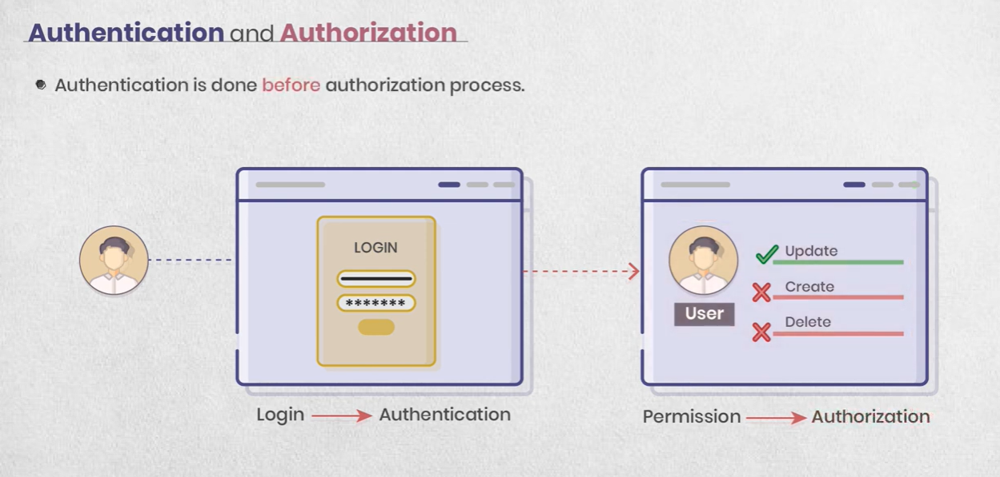

## Defining User Registration Routes


### إضافة مسارات تسجيل وتسجيل دخول المستخدمين (Users API)

- **إنشاء ملف جديد للمستخدمين:**
    - `routes/Users.js` تم إنشاء ملف جديد باسم 
    - يحتوي الملف على مسارين رئيسيين:
        -  (POST) لتسجيل مستخدم جديد `/register`  
        - (POST) لتسجيل الدخول `/login`.
    - تم كتابة تعليقات توضيحية بالعربية تشرح وظيفة كل مسار.
    - لم يتم حذف أي كود قديم، وإذا وُجد كود قديم في المستقبل سيتم تعليقه مع توضيح السبب.

- **app.js تعديل ملف:**
    - `/api/users` تم استيراد مسار المستخدمين الجديد وتفعيله على الرابط 
    - بذلك أصبح السيرفر يدعم عمليات تسجيل وتسجيل دخول المستخدمين بشكل منظم.

**الفائدة:**
- فصل منطق المستخدمين في ملف خاص يسهل صيانة الكود وتطويره.
- في تنظيم المسارات RESTful API اتباع أسلوب 
- (JWT مثل التحقق من صحة البيانات أو إضافة ) تسهيل إضافة منطق التحقق والتوثيق لاحقًا 
- الحفاظ على الكود القديم (إن وجد) مع توضيح سبب التعليق، مما يساعد في تتبع التغييرات وفهم مراحل التطوير.

----

## Creating User’s Registration Validator


### (User Validation & Storage) بناء معالج تحقق وتخزين بيانات المستخدم 

- **للتحقق من صحة بيانات المستخدم JSON إنشاء مخطط**
 - AJV يحتوي على مخطط يحدد الحقول المطلوبة (الاسم، البريد الإلكتروني، كلمة المرور) باستخدام مكتبة `middlewares/userValidator.js` تم إنشاء ملف 
      
    - يتحقق من صحة البيانات قبل معالجتها middleware تم بناء 
      

- **تفعيل التحقق في مسار التسجيل:**
    - التحقق middleware ليستخدم `routes/Users.js` في `/register` تم تعديل مسار 
    - إذا كانت البيانات غير صحيحة، يتم إرجاع رسالة خطأ مع تفاصيل الأخطاء.
    - إذا كانت البيانات صحيحة، يتم التأكد من عدم وجود بريد إلكتروني مكرر ثم حفظ المستخدم في قاعدة البيانات.

- **إضافة نموذج المستخدم:**
    - Mongoose لتعريف نموذج المستخدم باستخدام `Models/userModel.js` تم إنشاء ملف 
    
- **تحديث الاعتمادات:**
    - `package.json` إلى `ajv` تم إضافة مكتبة 
      
**الفائدة:**
- حماية قاعدة البيانات من إدخال بيانات غير صحيحة.
- ضمان أن كل مستخدم مسجل بياناته مكتملة وصحيحة.
- سهولة صيانة الكود وفصل منطق التحقق عن منطق الحفظ.
- تحسين أمان التطبيق وسلامة البيانات.

----

## Implementing user’s model for Registration Endpoint


### تنفيذ عملية التسجيل والتحقق من وجود المستخدم

- **(userModel.js) إنشاء نموذج المستخدم :**
    - `validator` تم تحديث نموذج المستخدم ليشمل التحقق من صحة البريد الإلكتروني باستخدام مكتبة 
    - تم تحديد خصائص الحقول: الاسم (سلسلة بين 3 و50 حرف)، البريد الإلكتروني (فريد وصحيح)، كلمة المرور (6 أحرف فأكثر).

- **التحقق من وجود المستخدم أثناء التسجيل:**
    - `findOne()` عند استقبال طلب تسجيل جديد، يتم البحث أولاً عن البريد الإلكتروني في قاعدة البيانات باستخدام .
    - إذا كان المستخدم موجودًا بالفعل، يتم إرجاع رسالة خطأ.
    - إذا لم يكن موجودًا، يتم إنشاء مستخدم جديد وحفظه في قاعدة البيانات.
    - للتعامل مع الأخطاء أثناء العمليات غير المتزامنة try-catch تم استخدام بنية 
    
**الفائدة:**
- منع تكرار المستخدمين بنفس البريد الإلكتروني.
- ضمان صحة البيانات المدخلة.
- التعامل مع الأخطاء بشكل آمن واحترافي.
- تسهيل صيانة الكود وتطويره مستقبلاً.

---

## Hashing Passwords


### (bcrypt) تأمين عملية التسجيل باستخدام تجزئة كلمة المرور 

- **(bcrypt) استخدام خوارزمية التجزئة:**
    - في مسار التسجيل `bcrypt` تم استيراد مكتبة 
    - (salt rounds) مع 10 جولات  `bcrypt` باستخدام (hash) عند استقبال كلمة المرور من المستخدم، يتم تجزئتها 
    
    - يتم تخزين كلمة المرور المجزأة فقط في قاعدة البيانات، وليس النص الأصلي.
    - حتى إذا كان لدى مستخدمين نفس كلمة المرور، ستكون القيم المخزنة مختلفة بسبب الملح الفريد.

**الفائدة:**
- حماية كلمات المرور من التسريب أو الاسترجاع حتى لو تم اختراق قاعدة البيانات.
- رفع مستوى أمان التطبيق بشكل كبير.
- اتباع أفضل الممارسات في تخزين البيانات الحساسة.
---

## Authenticating Users


### (Login/Authentication) شرح تنفيذ عملية تسجيل الدخول 

1. **routes في مجلد Auth.js إنشاء ملف جديد للمصادقة**
   - Express Router يحتوي على منطق تسجيل الدخول فقط باستخدام `routes/Auth.js` تم إنشاء ملف جديد 
   - bcrypt يتم استقبال البريد الإلكتروني وكلمة المرور، والتحقق من صحة البيانات، ثم البحث عن المستخدم في قاعدة البيانات ومقارنة كلمة المرور باستخدام .

2. **app.js إضافة الراوتر الجديد في :**
   - `/api/login` وربطه على المسار AuthRouter تم استيراد 
   - مع تعليق يوضح السبب (للحفاظ عليه كمرجع تعليمي) app.js تم عمل هاش لأي كود قديم خاص بتسجيل الدخول في 
   
3. **مستقل لبيانات تسجيل الدخول Validator إنشاء**
   - AJV للتحقق من صحة البريد الإلكتروني وكلمة المرور فقط باستخدام `util/AuthenticationValidator.js` تم إنشاء ملف جديد 

4. **للتحقق من صحة بيانات المصادقة Middleware إنشاء**
   - للتحقق من صحة بيانات تسجيل الدخول قبل تنفيذ المنطق الرئيسي `middlewares/authValidator.js` تم إنشاء ملف جديد 
   
5. **استخدام نموذج المستخدم للتحقق من البريد الإلكتروني وكلمة المرور:**
   - bcrypt للبحث عن المستخدم بالبريد الإلكتروني ومقارنة كلمة المرور باستخدام userModel تم استخدام 
     
6. **عمل هاش للكود القديم الخاص بتسجيل الدخول:**
   - Auth.js أو أي ملف آخر تم عمل هاش له مع تعليق يوضح أنه تم نقله إلى app.js أي كود قديم خاص بتسجيل الدخول في 
     

---

**الهدف من التنظيم:**
- جعل منطق المصادقة منفصل وسهل الصيانة.
- ضمان التحقق من صحة البيانات وأمان كلمات المرور.
- تسهيل إضافة أي منطق مصادقة أو توثيق مستقبلاً.

> تم تنفيذ جميع الخطوات المطلوبة مع الحفاظ على الكود القديم كمرجع، وكتابة تعليقات توضيحية في أماكن التعديل.


----


## Generating Authentication Tokens Using JWT


### JWT شرح تعديل نقطة نهاية تسجيل الدخول لإرجاع  
- في المشروع باستخدام الأمر `jsonwebtoken` قمنا بتثبيت مكتبة 
:
  ```bash
  npm install jsonwebtoken
  ```
- في أعلى الملف `jsonwebtoken` تم استيراد مكتبة `routes/Users.js` في ملف 
- ولم يكن ينفذ منطق فعلي، لذلك تم تعليقه مع توضيح السبب في التعليق placeholder الكود القديم الخاص بتسجيل الدخول كان مجرد 
- : أصبح كالتالي `/login` الكود الجديد لمسار 
  - عند استقبال البريد الإلكتروني وكلمة المرور، يتم البحث عن المستخدم في قاعدة البيانات.
  - `user._id` بقيمة `userID` يحتوي على خاصية JWT يتم إنشاء رمز (bcrypt باستخدام) إذا كان المستخدم موجودًا وكلمة المرور صحيحة 
  - يتم استخدام مفتاح سري ثابت (لأغراض العرض فقط) لإنشاء الرمز.
  - يتم إرسال الرمز للعميل في الاستجابة بدلاً من رسالة نصية بسيطة.
- الهدف من ذلك هو أن العميل سيحتفظ بالرمز ويستخدمه في الطلبات اللاحقة للوصول إلى نقاط النهاية المحمية، مما يحقق مصادقة آمنة لكل طلب.
- لم يتم حذف أي كود قديم، فقط تم تعليقه مع شرح السبب، حفاظًا على الشرح أو أي استخدام سابق.

----

## Setting Response Headers


### (X-Auth-Token) شرح إرسال التوكن في رأس الاستجابة 
-بدلاً من إرساله في جسم الاستجابة مباشرة  `X-Auth-Token` باسم HTTP في رأس JWT تم تعديل نقطة نهاية تسجيل الدخول بحيث يتم إرسال رمز 
- الكود القديم الذي كان يعيد التوكن في الجسم تم تعليقه للحفاظ على الشرح أو أي استخدام سابق.
- السبب في إرسال التوكن في رأس الاستجابة هو أن ذلك أكثر أمانًا وأسهل في التعامل مع الطلبات اللاحقة من جهة العميل (مثل تطبيقات الويب أو الموبايل)، حيث يمكن للعميل تخزين التوكن واستخدامه في رؤوس الطلبات التالية للوصول إلى نقاط النهاية المحمية.
- يتغير لأنه يمثل وقت إنشاء التوكن بالثواني منذ 1970، مما يضمن أن كل توكن فريد من حيث التوقيت (issued at) `iat` عند كل تسجيل دخول جديد، يتم توليد توكن جديد يحتوي على نفس بيانات المستخدم، لكن حقل  
- هذه الممارسة تجعل النظام أكثر أمانًا ومرونة في إدارة جلسات المستخدمين.

---

## Storing Secrets in Environment Variables


### شرح حماية الأسرار واستخدام 
 في التطبيق
- لإدارة إعدادات التطبيق والأسرار بشكل آمن `config` تم تثبيت حزمة 
- `JWT_SECRET` لربط السر بمتغير البيئة `custom-environment-variables.json` وملف JWT يحتوي على السر الافتراضي لرمز `default.json` وإضافة ملف `config` تم إنشاء مجلد ----
- مع التحقق من وجوده قبل إنشاء التوكن config في كود تسجيل الدخول، تم استبدال السر الثابت بجلب السر من إعدادات 
- إذا لم يكن السر موجودًا في الإعدادات أو متغيرات البيئة، يتم إرجاع رسالة خطأ مناسبة.
- الكود القديم الذي كان يستخدم سر ثابت تم تعليقه للحفاظ على الشرح أو أي استخدام سابق.
- هذه الطريقة تضمن عدم ظهور الأسرار في الشيفرة المصدرية، وتسمح بتغييرها بسهولة حسب البيئة (تطوير، إنتاج، ...)، مما يزيد من أمان التطبيق.

---

## Encapsulating Logic in Mongoose Models 

### عند التسجيل واستخدام دالة النموذج JWT شرح توليد 
- `X-Auth-Token` للمستخدم الجديد مباشرة بعد التسجيل، ويتم إرساله في رأس الاستجابة باسم JWT تم تعديل نقطة نهاية التسجيل بحيث يتم توليد رمز 
- أو متغيرات البيئة config لتسهيل توليد الرموز من أي مكان في التطبيق، مع التحقق من وجود السر في إعدادات (`userModel.js`) داخل نموذج المستخدم `generateJWT` تم إنشاء دالة 
- إذا لم يكن السر موجودًا أو حدث خطأ أثناء توليد الرمز، يتم إرجاع رسالة خطأ مناسبة.
- الكود القديم الذي كان يعيد المستخدم فقط تم تعليقه للحفاظ على الشرح أو أي استخدام سابق.
- هذه الطريقة تجعل كل مستخدم مسجل جديد يعتبر مسجل دخول تلقائيًا، وتوحّد طريقة توليد الرموز في التطبيق، مما يسهل الصيانة ويزيد الأمان.

----

## Role-based Authorization


### ووسيط الصلاحيات JWT شرح حماية عمليات الطلاب باستخدام 
- لنموذج المستخدم وقاعدة البيانات لتحديد ما إذا كان المستخدم مسؤولاً أم لا `isAdmin` تم إضافة حقل 
- في الحمولة، بحيث يظهر في رمز المصادقة عند تسجيل الدخول أو التسجيل `isAdmin` ليشمل حقل JWT تم تعديل دالة توليد 
- ويسمح فقط للمسؤولين بتنفيذ عمليات الإضافة، التحديث، أو الحذف JWT يتحقق من دور المستخدم عبر رمز `middlewares/permission.js` تم إنشاء وسيط جديد في ملف 
- بوسيط الصلاحيات، بينما تبقى عمليات الاستعلام متاحة لأي مستخدم مصدق POST وPUT وDELETE بحيث يتم حماية عمليات `routes/Students.js` تم تعديل نقاط نهاية الطلاب في ملف 
- هذه الخطوات تضمن أن العمليات الحساسة لا يمكن تنفيذها إلا من قبل المسؤولين، وتحقق فصل الصلاحيات بشكل آمن ومرن  في التطبيق.

----

## Authorization Middleware


### (permission middleware) شرح وسيط التحقق من صلاحيات المسؤول 
- (`x-auth-token`) في رأس الطلب JWT تم تحديث وسيط الصلاحيات ليقوم بالتحقق من وجود رمز 
- إذا لم يوجد رمز، يتم إرجاع رسالة "تم رفض الوصول: لا يوجد رمز توكن" مع رمز حالة 401.
- للتعامل مع أي أخطاء أو استثناءات try-catch داخل كتلة `jwt.verify` إذا وجد رمز، يتم فك تشفيره باستخدام 
- في الحمولة المفككة. إذا لم يكن المستخدم مسؤولاً، يتم إرجاع رسالة "تم رفض الوصول: ليس لديك صلاحية المسؤول" مع رمز حالة 401 `isAdmin` أو `AdminRole` يتم التحقق من خاصية 
- (next) إذا كان المستخدم مسؤولاً، يتم تمرير الطلب للمعالج التالي 
- هذه الوسيطة تضمن أن عمليات مثل الإضافة أو الحذف أو التحديث في واجهة الطلاب لا يمكن تنفيذها إلا من قبل المسؤولين فقط، وتوفر رسائل واضحة للمستخدم في جميع الحالات.

------

## Updating User Roles and Permissions


### (Admin) شرح نقطة نهاية الإدارة لتعيين مستخدم كمسؤول 
- (`isAdmin: true`) لتحديث دور المستخدم ليصبح مسؤولاً `PUT /api/admin/user/:id` يحتوي على نقطة نهاية `routes/admin.js` تم إنشاء ملف جديد 
- لضمان أن من ينفذ العملية هو مسؤول معتمد (permission middleware) تم حماية هذه النقطة بوسيط الصلاحيات 
- عند نجاح العملية، يتم إرجاع رسالة تؤكد تعيين المستخدم كمسؤول مع بيانات المستخدم المحدثة.
- `app.use('/api/admin', adminRouter);` باستخدام (`app.js`) تم ربط مسارات الإدارة في التطبيق الرئيسي 
- هذه الخطوة تتيح للإداريين إدارة أدوار المستخدمين بسهولة وأمان من خلال واجهة برمجة التطبيقات.


-----

# CH11 - Error Handling

## Handling Rejected Promises


### (Unhandled Promise Rejection) التعامل مع الاستثناءات ورفض الوعود 
- (Unhandled Promise Rejection) Node.js من أكثر الأخطاء شيوعًا في تطبيقات 
- للتعامل مع الخطأ الناتج catch ولا يوجد معالج (Promise) يحدث هذا عندما يتم رفض وعد 
- في نهاية السلسلة لمعالجة أي خطأ محتمل catch مع الوعود، يجب دائمًا إضافة then/catch عند استخدام 
```js
someAsyncFunction()
  .then(result => { /* ... */ })
  .catch(err => { /* التعامل مع الخطأ */ });
```
- عند استخدام await، يجب إحاطة العبارة بكتلة try-catch:
```js
try {
  const result = await someAsyncFunction();
  // ...
} catch (err) {
  // التعامل مع الخطأ
}
```
- هذه الممارسات تضمن عدم توقف التطبيق بشكل مفاجئ وتوفر تجربة مستخدم أفضل، كما تسهل تتبع الأخطاء وحلها.



------

## Express Error Middleware


### error middleware شرح تحسين إدارة الأخطاء باستخدام 
- (`middlewares/errorMiddleware.js`) خاص بالأخطاء في ملف منفصل middleware في كل نقطة نهاية، تم إنشاء catch بدلاً من تكرار كتل 
- أخرى، ويرسل استجابة موحدة للعميل مع تسجيل الخطأ في السجل middleware من أي نقطة نهاية أو next(error) يستقبل أي خطأ يُمرر عبر middleware هذا 
- بعد جميع المسارات app.js في نهاية ملف errorMiddleware تم استيراد وتفعيل 
- ليتم التعامل مع الخطأ بشكل مركزي وموحد catch في كتل next(error) بحيث تستدعي Users.js تم تحديث جميع نقاط النهاية في 
- هذه الطريقة تسهل صيانة الكود وتحديث طريقة التعامل مع الأخطاء في مكان واحد فقط، وتوفر تجربة أفضل للمطور والمستخدم.

------

## Refactoring Controller’s Route Handler async Functions


### asyncHandler باستخدام async تبسيط التعامل مع الأخطاء في دوال 
- next وتتعامل مع الأخطاء تلقائيًا بتمريرها إلى async والتي تغلف أي دالة `middlewares/Async.js` في ملف `asyncHandler` تم إنشاء دالة 
- في كل دالة try-catch بحيث لم يعد هناك حاجة لكتابة asyncHandler لاستخدام `routes/Students.js` تم تحديث جميع دوال المسارات في ملف 
- error middleware هذا الأسلوب يجعل الكود أنظف وأسهل في الصيانة، ويضمن أن جميع الأخطاء في الدوال غير المتزامنة يتم التعامل معها بشكل مركزي عبر .
- حول الدالة asyncHandler في المسارات دون القلق من نسيان التعامل مع الأخطاء، فقط استخدم async يمكن الآن إضافة أو تعديل أي دالة 
   
-----------------

## Handling Synchronous Exceptions


### Express في Middleware التعامل مع الاستثناءات غير المعالجة خارج 
- مثل أخطاء في ملفات التهيئة أو أثناء تشغيل الخادم Express خارج دورة معالجة الطلبات في (synchronous exceptions) في بعض الأحيان قد تحدث استثناءات متزامنة 
- 'uncaughtException' ويدعم الاستماع لأحداث مثل EventEmitter حيث يعتبر Node.js في process يمكن التقاط هذه الاستثناءات باستخدام كائن 
- app.js تم إضافة مستمع لهذا الحدث في :
```js
process.on('uncaughtException', (err) => {
  console.error('حدث استثناء غير معالج:', err);
  // يمكن هنا تسجيل الخطأ أو إرسال إشعار أو حتى إنهاء التطبيق
});
```
- هذا يضمن أن التطبيق لن يتوقف فجأة عند حدوث استثناء غير معالج، ويمكنك تسجيل أو التعامل مع الخطأ بشكل مركزي.


-----

## Handling Asynchronous Exceptions (Promise Rejection)


### Node.js في (unhandled promise rejections) التعامل مع الوعود المرفوضة غير المعالجة 
- unhandled promise rejection سيظهر تحذير catch أو try-catch عبر (rejection) إذا لم يتم التعامل مع الرفض (Promises) أو الوعود async/await عند استخدام 
- unhandledRejections (throw, warn, none) تجاه هذه الحالات عبر متغير Node.js يمكن التحكم في سلوك 
- : app.js في `unhandledRejection` من الأفضل إضافة مستمع لحدث 
```js
process.on('unhandledRejection', (reason, promise) => {
  console.error('تم رفض وعد غير معالج:', reason);
  // من الأفضل إنهاء العملية وإعادة تشغيلها تلقائيًا في بيئة الإنتاج
  process.exit(1);
});
```
- هذا يضمن تسجيل جميع الأخطاء غير المعالجة في الوعود، ويمنع التطبيق من الاستمرار في حالة غير مستقرة.


-----

## Process Termination and Process Management


### تلقائيًا بعد الاستثناءات Node إعادة تشغيل تطبيق 
- مما يشير إلى أن التطبيق توقف بسبب خطأ `process.exit(1)` من الأفضل إنهاء العملية الحالية باستخدام  Node.js، عند حدوث استثناء متزامن أو رفض غير معالج في 
- رمز الخروج `0` يعني انتهاء العملية بنجاح، أما أي قيمة أخرى (مثل 1) فتعني وجود خطأ أو استثناء.
- (Heroku dynos، Azure Web Apps، ...) أو الاعتماد على مزود الخدمة السحابية PM2 مثل (Process Manager) لإعادة تشغيل التطبيق تلقائيًا بعد التوقف، يجب استخدام مدير عمليات 
- مدير العمليات يراقب التطبيق ويعيد تشغيله تلقائيًا إذا توقف لأي سبب، مما يضمن استمرارية الخدمة دون تدخل يدوي.
- تلقائيًا عند توقف التطبيق بسبب خطأ أو استثناء، ولا يحتاج المطور لأي إعداد إضافي في معظم الحالات dyno يتم إعادة تشغيل Heroku عند النشر على 
- هذه الممارسات تضمن استقرار التطبيق في بيئة الإنتاج وتقلل من زمن التوقف غير المتوقع.